<a href="https://colab.research.google.com/github/DrYGuo/STS/blob/main/PCA_and_vortex_images(_an_improved_version).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**SVK July 1:** Yueming, let's be a bit more systematic. Can you write down th elogic you are following here. 

Am I correct that the idea is:
- smooth the IV data sets (you use polyfit now)?
- find vortex centers for all fields
- explore vortex profiles as a function of distance from the center. 

Note that there are multiple strategies to smooth 3D data, including:
- Gaussian processing
- DNN interpolation inclidiing simple AE< VAE, etc.
- sliding transforms 
Of course, the idea is to use th eone which is adequte to problem. 


## 1.Install dependencies

In [ ]:
!pip install nanonispy
import os
from google.colab import files
import numpy as np
import nanonispy as nap
import matplotlib.pyplot as plt
from sklearn.decomposition import NMF
from sklearn.decomposition import PCA
import matplotlib.gridspec as gridspec
from matplotlib.colors import LinearSegmentedColormap
from google.colab import files
from mpl_toolkits.axes_grid1 import make_axes_locatable
%matplotlib inline
plt.set_cmap('gray')
!pip install pyUSID
import pyUSID as usid
!pip install pycroscopy
!pip install wget pysptools graphviz
# from pycroscopy.viz import cluster_utils
from scipy import interpolate, stats
from skimage import transform
import scipy
!pip install mpld3
!pip install "git+https://github.com/javadba/mpld3@display_fix"
import mpld3
from mpld3 import plugins


  Cloning https://github.com/javadba/mpld3 (to revision display_fix) to /tmp/pip-req-build-o8575sle
  Running command git clone -q https://github.com/javadba/mpld3 /tmp/pip-req-build-o8575sle
  Running command git checkout -b display_fix --track origin/display_fix
  Switched to a new branch 'display_fix'
  Branch 'display_fix' set up to track remote branch 'display_fix' from 'origin'.
  Running command git submodule update --init --recursive -q


<Figure size 432x288 with 0 Axes>

# 2.Download and read 3ds datasets

In [ ]:
# we are going to load files from Google Drive here:
!gdown https://drive.google.com/uc?id=1h77hZ1XnjnV7yuSSAYPVKGPaf3KVc-uQ
!gdown https://drive.google.com/uc?id=1FhbvESLVsJJCaAHgsEZpq5ikpNYIXHiC
!gdown https://drive.google.com/uc?id=18XwDEyFVJslrCyN-C1hPNy9gHVQW0Fp8
!gdown https://drive.google.com/uc?id=1W_eCjBAUiP7ViLc4CbrWgT_pg8w4FWVa

Downloading...
From: https://drive.google.com/uc?id=1h77hZ1XnjnV7yuSSAYPVKGPaf3KVc-uQ
To: /content/Grid Spectroscopy004.3ds
100% 4.78M/4.78M [00:00<00:00, 229MB/s]
Downloading...
From: https://drive.google.com/uc?id=1FhbvESLVsJJCaAHgsEZpq5ikpNYIXHiC
To: /content/Grid Spectroscopy011.3ds
100% 16.6M/16.6M [00:00<00:00, 122MB/s] 
Downloading...
From: https://drive.google.com/uc?id=18XwDEyFVJslrCyN-C1hPNy9gHVQW0Fp8
To: /content/Grid Spectroscopy006.3ds
100% 4.78M/4.78M [00:00<00:00, 223MB/s]
Downloading...
From: https://drive.google.com/uc?id=1W_eCjBAUiP7ViLc4CbrWgT_pg8w4FWVa
To: /content/Grid Spectroscopy010.3ds
100% 4.78M/4.78M [00:00<00:00, 222MB/s]


In [ ]:
# download sxm files from google drives
#!gdown https://drive.google.com/uc?id=19-Ff9yoFhcqmQhf8wqfgj30xWh_o7SRz
# !gdown https://drive.google.com/uc?id=1Mom0uRj_lqXwnlYjjeCbUz1PskvnUVkQ
# !gdown https://drive.google.com/file/d/1Mom0uRj_lqXwnlYjjeCbUz1PskvnUVkQ/view?usp=sharing
# !gdown https://drive.google.com/file/d/1Mom0uRj_lqXwnlYjjeCbUz1PskvnUVkQ/view?usp=sharing
!gdown https://drive.google.com/file/d/1Mom0uRj_lqXwnlYjjeCbUz1PskvnUVkQ/view?usp=sharing

/usr/local/lib/python3.7/dist-packages/gdown/parse_url.py:39: UserWarning: You specified a Google Drive link that is not the correct link to download a file. You might want to try `--fuzzy` option or the following url: https://drive.google.com/uc?id=1Mom0uRj_lqXwnlYjjeCbUz1PskvnUVkQ
  url="https://drive.google.com/uc?id={}".format(file_id)
Downloading...
From: https://drive.google.com/file/d/1Mom0uRj_lqXwnlYjjeCbUz1PskvnUVkQ/view?usp=sharing
To: /content/view?usp=sharing
67.0kB [00:00, 39.4MB/s]


read sxm files

In [ ]:
topography=nap.read.Scan('/content/view?usp=sharing')
topography.header
scan_range=topography.header['scan_range'][0]*1e9
scan_pixels=topography.header['scan_pixels'][0]
scale_bar_512=scan_range/scan_pixels
print('The scale_bar is '+str(scale_bar_512)+' nm/pixel')

UnhandledFileError: ignored

In [ ]:
raw_Z_f=topography.signals['Z']['forward']

read 3ds datasets

In [ ]:
dataset_0T = nap.read.Grid('/content/Grid Spectroscopy011.3ds')
for k, v in dataset_0T.signals.items():
    print('key: {}, dimensions {}'.format(k, v.shape))

key: params, dimensions (128, 128, 10)
key: Current (A), dimensions (128, 128, 81)
key: LIX 1 omega (A), dimensions (128, 128, 81)
key: LIY 1 omega (A), dimensions (128, 128, 81)
key: sweep_signal, dimensions (81,)
key: topo, dimensions (128, 128)


In [ ]:
scale_bar_128=dataset_0T.header['size_xy'][0]*1e9/dataset_0T.header['dim_px'][0]
print('The scale_bar is '+str(scale_bar_128)+' nm/pixel')

The scale_bar is 1.171875 nm/pixel


In [ ]:
dataset_4T = nap.read.Grid('/content/Grid Spectroscopy004.3ds')
for k, v in dataset_4T.signals.items():
    print('key: {}, dimensions {}'.format(k, v.shape))

key: params, dimensions (128, 128, 10)
key: Current (A), dimensions (128, 128, 21)
key: LIX 1 omega (A), dimensions (128, 128, 21)
key: LIY 1 omega (A), dimensions (128, 128, 21)
key: sweep_signal, dimensions (21,)
key: topo, dimensions (128, 128)


In [ ]:
dataset_6T = nap.read.Grid('/content/Grid Spectroscopy006.3ds')
for k, v in dataset_6T.signals.items():
    print('key: {}, dimensions {}'.format(k, v.shape))

key: params, dimensions (128, 128, 10)
key: Current (A), dimensions (128, 128, 21)
key: LIX 1 omega (A), dimensions (128, 128, 21)
key: LIY 1 omega (A), dimensions (128, 128, 21)
key: sweep_signal, dimensions (21,)
key: topo, dimensions (128, 128)


In [ ]:
dataset_2T = nap.read.Grid('/content/Grid Spectroscopy010.3ds')
for k, v in dataset_2T.signals.items():
    print('key: {}, dimensions {}'.format(k, v.shape))

key: params, dimensions (128, 128, 10)
key: Current (A), dimensions (128, 128, 21)
key: LIX 1 omega (A), dimensions (128, 128, 21)
key: LIY 1 omega (A), dimensions (128, 128, 21)
key: sweep_signal, dimensions (21,)
key: topo, dimensions (128, 128)


In [ ]:
energy_level_2T=dataset_2T.signals['sweep_signal']
print(energy_level_2T)

[-0.01  -0.009 -0.008 -0.007 -0.006 -0.005 -0.004 -0.003 -0.002 -0.001
  0.     0.001  0.002  0.003  0.004  0.005  0.006  0.007  0.008  0.009
  0.01 ]


In [ ]:
energy_level_0T=dataset_0T.signals['sweep_signal']
print(energy_level_0T)

[-0.01    -0.00975 -0.0095  -0.00925 -0.009   -0.00875 -0.0085  -0.00825
 -0.008   -0.00775 -0.0075  -0.00725 -0.007   -0.00675 -0.0065  -0.00625
 -0.006   -0.00575 -0.0055  -0.00525 -0.005   -0.00475 -0.0045  -0.00425
 -0.004   -0.00375 -0.0035  -0.00325 -0.003   -0.00275 -0.0025  -0.00225
 -0.002   -0.00175 -0.0015  -0.00125 -0.001   -0.00075 -0.0005  -0.00025
  0.       0.00025  0.0005   0.00075  0.001    0.00125  0.0015   0.00175
  0.002    0.00225  0.0025   0.00275  0.003    0.00325  0.0035   0.00375
  0.004    0.00425  0.0045   0.00475  0.005    0.00525  0.0055   0.00575
  0.006    0.00625  0.0065   0.00675  0.007    0.00725  0.0075   0.00775
  0.008    0.00825  0.0085   0.00875  0.009    0.00925  0.0095   0.00975
  0.01   ]


In [ ]:
dataset_0T.signals['params'][1,1:]

array([[-1.0000001e-02,  1.0000001e-02, -2.4218760e-10, ...,
         2.0000000e-02,  1.0000000e+00,            nan],
       [-1.0000001e-02,  1.0000001e-02,  9.2968744e-10, ...,
         2.0000000e-02,  1.0000000e+00,            nan],
       [-1.0000001e-02,  1.0000001e-02,  2.1015625e-09, ...,
         2.0000000e-02,  1.0000000e+00,            nan],
       ...,
       [-1.0000001e-02,  1.0000001e-02,  1.4507032e-07, ...,
         2.0000000e-02,  1.0000000e+00,            nan],
       [-1.0000001e-02,  1.0000001e-02,  1.4624219e-07, ...,
         2.0000000e-02,  1.0000000e+00,            nan],
       [-1.0000001e-02,  1.0000001e-02,  1.4741407e-07, ...,
         2.0000000e-02,  1.0000000e+00,            nan]], dtype=float32)

# Polynomial fit to the dIdV_0T

In [ ]:
dIdV1 = dataset_0T.signals['LIX 1 omega (A)']

In [ ]:
IV1=dataset_0T.signals['Current (A)']

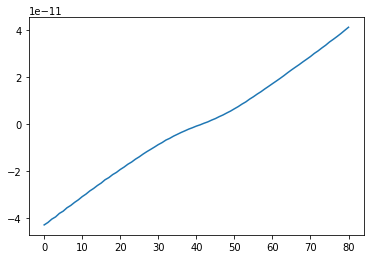

In [ ]:
plt.plot(IV1[9,15,:])

In [ ]:
dIdV1_new=np.zeros((128,128,81))
for x in np.arange(128):
  for y in np.arange(128):
      dIdV1_new[x,y,:]=np.gradient(IV1[x,y,:])/np.gradient(energy_level_0T)

print(dIdV1_new.shape)

(128, 128, 81)


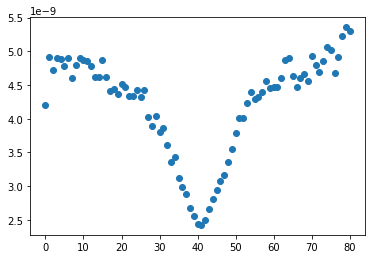

In [ ]:
#dIdV1_new[]=np.gradient(IV[9,15,:])/np.gradient(energy_level_0T)
plt.plot(dIdV1_new[9,15,:],'o')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: invalid value encountered in log
  


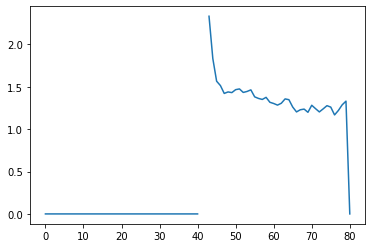

In [ ]:
normalized=np.zeros((81))
normalized[41:80]=np.gradient(np.log(IV1[9,15,41:80]))/np.gradient(np.log(energy_level_0T[41:80]))
plt.plot(normalized)
#normalized=np.gradient(np.log(IV[9,15,:]))/np.gradient(np.log(energy_level_0T))

In [ ]:
exp=dIdV1_new[9,15,:]

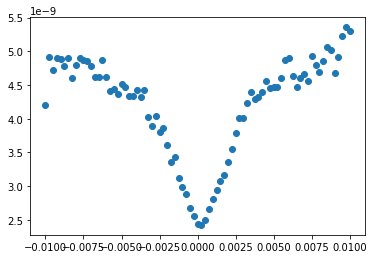

In [ ]:
plt.plot(energy_level_0T,exp,'o')

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path


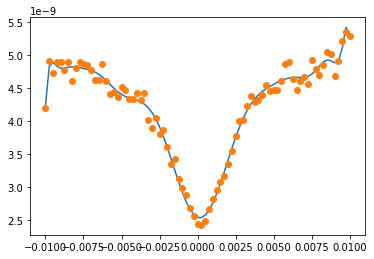

In [ ]:
coef=np.polyfit(energy_level_0T,exp, 30)
polyno = np.poly1d(coef)
plt.plot(energy_level_0T,polyno(energy_level_0T),energy_level_0T,exp,'o')


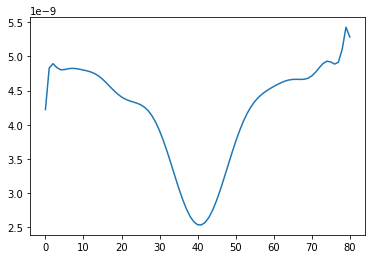

In [ ]:
plt.plot(polyno(energy_level_0T))

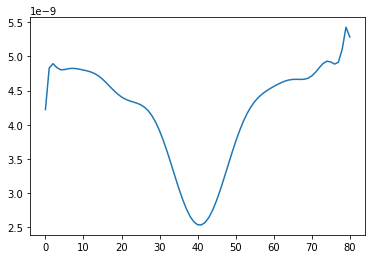

In [ ]:
plt.plot(polyno(energy_level_0T))

In [ ]:
from scipy.stats import chisquare
chisquare(exp, polyno(energy_level_0T))

Power_divergenceResult(statistic=2.04794965516548e-10, pvalue=1.0)

In [ ]:
polyno(energy_level_0T).shape

(81,)

# Map the second order derivative at the Fermi Level

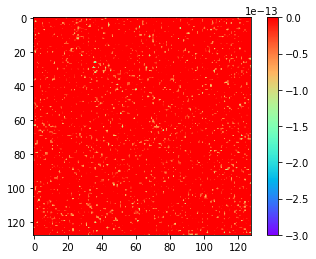

In [ ]:
SD2=np.zeros((128,128,81))
for x in np.arange(128):
  for y in np.arange(128):
    SD2[x,y,:]=np.gradient(np.gradient(dIdV1[x,y,:]))

plt.imshow(SD2[:,:,40],vmax=0,vmin=-3e-13)
plt.colorbar()
plt.set_cmap('rainbow')

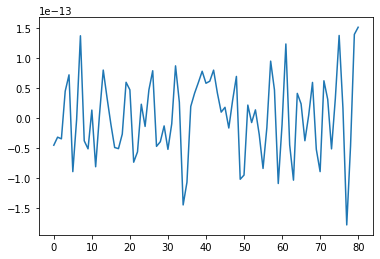

In [ ]:
plt.plot(SD2[50,51,:])

With fitting

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPyth

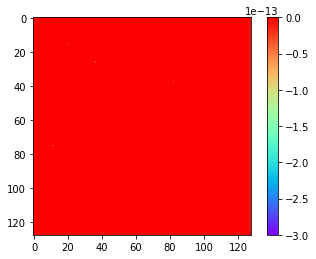

In [ ]:
SD=np.zeros((128,128,81))
for x in np.arange(128):
  for y in np.arange(128):
    exp=dIdV1[x,y,:]
    coef=np.polyfit(energy_level_0T,exp, 15)
    polyno = np.poly1d(coef)
    SD[x,y,:]=np.gradient(np.gradient(polyno(energy_level_0T)))

plt.imshow(SD[:,:,40],vmax=0,vmin=-3e-13)
plt.colorbar()
plt.set_cmap('rainbow')

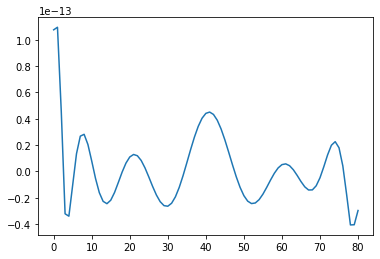

In [ ]:
plt.plot(SD[50,51,:])

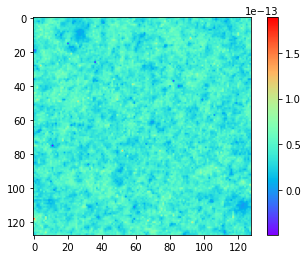

In [ ]:
plt.imshow(SD[:,:,40])
plt.colorbar()
plt.set_cmap('rainbow')

(35, 2)
[[  3  41]
 [  6 106]
 [  9  65]
 [ 10  16]
 [ 15  20]
 [ 17  23]
 [ 19   0]
 [ 19   1]
 [ 26  36]
 [ 36   0]
 [ 37  82]
 [ 40  85]
 [ 47  57]
 [ 48  99]
 [ 50  59]
 [ 50 119]
 [ 57 106]
 [ 61  70]
 [ 63  22]
 [ 66   4]
 [ 73 119]
 [ 74  66]
 [ 75  11]
 [ 86  32]
 [ 96  10]
 [101  12]
 [105  54]
 [108 105]
 [109 123]
 [110 122]
 [110 123]
 [111  59]
 [117  38]
 [118  59]
 [126 112]]


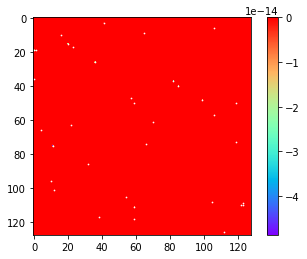

In [ ]:
summed_dIdV=np.empty((81))
xy_impurity=np.array([0])
count=0
for x in np.arange(128):
  for y in np.arange(128):
    if SD[x,y,40]<=0.02e-13:
       summed_dIdV=dIdV1[x,y,:]+summed_dIdV
       count=count+1
       xy_impurity=np.append(xy_impurity,(x,y))
xy_impurity=np.delete(xy_impurity,[0])
xy_impurity=xy_impurity.reshape(int(len(xy_impurity)/2),2)
averaged_dIdV=summed_dIdV/count
#plt.plot(averaged_dIdV)
print(xy_impurity.shape)
print(xy_impurity)
X_impurity,Y_impurity=np.hsplit(xy_impurity,2)

plt.scatter(Y_impurity,X_impurity,s=0.5,c='w')

plt.imshow(SD[:,:,40],vmax=0)
plt.colorbar()


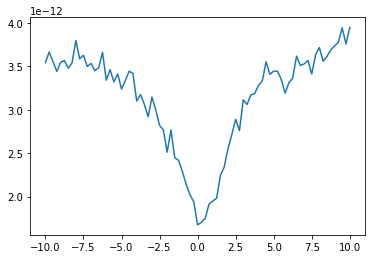

In [ ]:
plt.plot(1000*energy_level_0T,dIdV1[9,15,:])

# Map the gap size: we measure the distance from the first maxima away from the Fermi level to the Fermi level  

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

19
16
19
14
15
13
13
18
13
25
14
13
17
26
17
14
13
12
14
14
26
27
15
27
25
14
17
27
27
18
14
19
15
13
14
15
15
17
14
15
15
26
25
19
16
17
13
15
12
13
13
17
18
14
17
15
28
36
16
14
14
15
29
12
19
18
25
19
19
18
16
15
14
14
12
15
24
22
18
16
15
23
25
19
21
15
13
26
22
20
15
14
26
20
14
14
18
17
18
19
18
15
15
15
14
11
11
18
15
16
14
12
14
12
12
13
14
28
30
16
13
16
16
16
26
18
15
15
15
17
15
15
13
13
24
14
16
15
14
19
18
22
26
13
13
14
13
13
35
26
14
27
15
21
15
14
17
16
16
15
13
13
15
14
19
15
15
14
13
26
19
16
17
14
13
14
11
13
13
22
14
19
27
15
11
17
13
10
17
17


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

18
11
27
20
16
18
14
15
14
12
13
13
13
15
18
19
23
17
14
23
19
23
25
15
21
19
26
19
13
14
13
15
13
15
17
25
17
18
27
23
16
15
13
13
11
17
31
26
16
24
16
10
9
13
15
22
23
16
14
16
12
18
26
16
18
10
34
22
14
18
15
27
37
18
18
17
14
18
16
14
15
12
18
15
17
16
36
14
17
19
12
19
28
11
11
17
18
14
14
13
13
18
17
28
14
15
9
20
27
23
17
15
18
14
13
13
13
24
15
16
22
15
26
26
13
14
19
19
16
11
26
25
14
18
15
15
17
12
12
13
13
15
16
14
21
17
24
21
26
20
12
15
17
18
22
14
13
13
28
14
15
17
14
29
17
13
26
17
16
15
22
14
12
12
13
13
13
16
14
21
12
13
17
21
19
17


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

19
15
14
25
21
13
19
26
18
16
11
13
14
12
17
19
17
14
18
14
22
15
11
14
23
16
14
28
15
15
27
20
18
30
16
26
15
16
16
14
12
14
14
25
14
16
16
15
12
16
28
16
14
16
13
13
13
14
15
15
17
23
19
25
15
17
16
18
12
13
12
28
26
13
12
16
24
19
13
12
10
12
13
14
19
19
18
16
18
17
31
31
18
18
17
23
15
13
19
18
16
26
15
18
27
17
18
12
15
13
13
15
15
15
13
12
14
30
17
12
23
12
11
15
18
18
15
17
17
16
25
17
14
14
15
16
13
12
16
14
13
14
15
14
14
19
25
20
13
11
13
14
15
15
14
15
15
15
16
20
15
16
27
15
16
13
15
7
13
14
15
15
18
16
15
15
12
14
17
14
15
15
14


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

12
13
12
14
15
18
24
22
26
15
15
14
12
11
11
17
14
27
14
15
22
16
27
14
13
12
15
12
13
25
24
23
16
17
17
26
24
16
19
20
20
15
14
16
15
34
26
13
11
20
18
15
12
15
13
15
26
25
25
14
12
13
14
27
27
13
12
15
18
16
17
14
16
17
15
16
15
18
13
14
14
14
19
14
14
25
15
15
15
14
16
16
26
25
14
12
13
26
20
15
27
15
18
17
24
27
26
16
14
14
20
16
26
37
16
15
14
20
15
15
15
13
15
15
17
16
16
15
12
13
12
14
15
20
17
22
19
18
17
12
12
12
12
13
15
32
14
15
24
24
17
15
13
15
12
14
28
28
26
24
21
19
15
18
15
15
23
22
19
13
13
15
26
24
24
17
18
18
22
17
16
23
14
20
21
17
16
15
16


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

15
27
26
14
24
17
24
24
15
15
14
16
16
16
15
19
14
13
14
13
16
17
19
16
16
15
18
14
14
17
27
24
31
15
15
24
24
14
13
14
32
15
15
15
28
18
13
12
12
15
30
16
16
15
26
21
17
21
18
14
15
15
14
16
26
17
15
13
14
16
13
15
14
15
24
25
26
18
13
12
12
13
13
13
26
16
15
20
23
15
15
14
14
14
16
25
24
25
24
26
15
14
15
14
22
20
25
18
13
13
14
16
18
18
25
25
12
22
18
20
24
14
24
18
26
15
15
15
18
16
13
29
29
18
16
14
15
21
12
15
15
24
14
17
14
15
14
14
16
23
14
15
16
13
14
13
16
19
24
24
19
15
14
14
16
15
14
14
37
20
32
37
13
13
12
13
16
14
14
15
15
15


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

14
14
26
15
19
31
26
16
16
20
16
14
13
17
13
12
13
12
17
17
16
16
16
15
14
14
11
11
12
13
16
16
16
24
14
16
16
14
14
14
14
20
25
21
18
15
15
15
18
16
15
17
14
13
12
14
12
11
16
25
26
25
24
24
21
19
29
25
20
36
19
32
32
26
15
18
16
18
30
15
18
18
18
15
26
20
27
16
26
17
26
14
38
18
17
17
24
14
13
13
13
13
14
18
20
21
27
17
13
27
19
15
11
35
15
23
13
13
12
14
18
9
22
17
23
26
14
11
13
15
14
14
12
25
27
18
17
23
17
16
16
18
13
12
13
14
12
12
14
27
14
30
13
15
12
12
13
14
14
15
22
24
25
18
17
14
14
15
20
20
16
17
16
15
15
15
14
14
37
37
12
14
12
13
12
13
13
26


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

24
25
22
19
19
20
27
26
14
14
24
22
16
25
16
14
17
13
12
14
28
16
14
14
26
21
20
24
15
35
18
19
15
16
15
13
16
15
18
13
13
15
15
27
26
14
14
19
14
38
27
13
16
14
13
13
16
22
18
15
11
10
17
17
21
15
17
14
20
17
13
14
32
13
16
17
17
19
17
21
17
15
13
13
13
12
12
13
13
13
13
20
19
16
14
18
12
13
23
14
25
23
14
15
15
19
18
26
16
13
14
16
19
15
15
15
14
14
19
12
13
15
14
13
14
14
35
16
21
18
24
24
18
29
26
15
13
25
14
13
36
14
13
18
14
27
18
13
13
15
16
12
23
23
24
14
27
15
19
16
15
13
13
13
14
18
17
15
22
16
17
17
23
12
13
13
25
17
17
16
14
17
24
29
12
6
9
13
15
14
15
15
20
15
18
28
18
15
25
15
13
15
16
24
15


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

17
16
13
16
13
13
12
14
18
13
13
24
13
17
17
17
13
16
9
14
18
15
19
27
17
16
23
16
25
22
25
18
15
14
14
14
15
15
12
13
29
13
15
13
15
16
15
15
15
19
14
18
20
19
16
23
26
14
18
16
11
13
12
14
12
13
14
14
12
10
13
16
16
13
25
20
20
25
15
15
25
18
15
13
12
27
27
15
14
20
14
14
27
25
18
16
18
15
16
14
16
15
14
17
16
18
20
19
12
15
15
15
17
17
16
21
17
15
18
13
26
26
12
16
12
17
13
15
14
16
12
14
15
13
16
15
14
14
13
14
14
17
16
14
9
9
13
14
14
15
28
26
15
23
26
25
26
23
19
20
14
20
14
16
16
15
15
17
19
19
15
13
16
13
15
19
22
14
14
17
22
20
26
19
15


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

18
25
17
13
13
12
11
16
15
11
14
12
12
12
17
16
25
26
19
14
17
15
26
17
14
15
14
24
25
28
15
25
17
13
28
27
25
17
15
15
33
11
13
13
13
14
18
19
16
34
16
13
36
29
15
15
17
20
25
19
17
15
13
14
14
17
15
14
15
12
15
13
15
16
17
15
12
17
16
16
17
11
14
17
17
13
14
12
13
13
12
14
19
26
27
27
12
26
27
26
27
26
24
16
20
13
15
13
16
14
15
15
14
14
14
16
11
19
20
18
14
17
21
22
25
27
31
18
13
17
14
14
13
12
12
11
12
12
13
13
13
15
18
31
28
21
18
16
15
16
23
25
22
15
17
16
14
14
28
18
26
25
15
25
16
17
16
15
12
10
17
13
13
12
25
20
19
23
15
12
15
19
14
19
26


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

28
25
20
26
25
14
13
14
17
12
13
17
14
13
12
15
27
19
13
17
15
17
24
17
14
12
15
25
27
14
17
13
19
14
13
14
17
18
14
13
16
25
26
26
24
17
17
14
14
13
13
16
14
13
14
15
15
18
16
17
20
19
18
26
20
25
24
24
27
13
13
12
13
24
14
14
12
11
12
11
12
13
16
16
17
11
13
25
25
24
15
14
16
25
27
16
18
18
14
15
13
14
28
15
12
15
21
18
17
13
13
13
13
14
13
13
21
26
17
18
25
25
13
14
19
27
20
16
16
24
23
19
13
14
13
13
14
12
14
19
13
13
13
16
13
13
13
13
15
25
25
26
16
15
12
15
12
15
13
13
14
12
12
15
15
15
14
21
16
20
14
25


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

25
15
14
13
12
14
14
14
14
18
15
16
15
25
19
15
20
23
25
25
20
13
14
14
16
13
14
15
13
13
14
14
14
11
13
12
13
13
13
13
17
14
28
26
13
17
15
18
16
26
20
18
18
15
17
14
15
14
13
15
13
14
23
18
16
15
11
12
14
14
14
28
23
25
19
13
22
17
20
27
15
14
17
15
14
23
25
16
14
15
15
15
14
18
13
13
14
13
13
14
13
14
14
15
21
17
21
18
15
12
12
15
10
27
32
14
13
13
16
16
15
12
12
17
14
27
25
26
14
13
12
12
16
13
14
18
16
15
16
16
16
21
24
22
24
23
19
14
14
14
13
13
13
13
13
13
13
15
17
15
12
12
12
15
16
14
14
14
14
25
13
14
16
14
15
24
17
25
16
17
15
13
15
15
17
18
14
16
14
14
23
20
13
12
11
15
19
14
16
20
22
24
23


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

28
18
21
21
25
15
14
18
14
24
14
27
26
15
15
14
13
13
20
13
14
13
14
16
11
14
14
13
12
23
23
18
24
15
13
28
27
14
17
29
23
14
13
23
21
15
14
14
20
27
27
24
18
11
13
12
14
14
14
14
26
15
13
15
13
18
22
17
13
17
25
21
18
14
13
14
13
31
13
27
15
14
17
20
16
16
14
12
21
15
16
12
16
25
25
28
13
26
27
28
26
14
15
15
25
29
19
25
16
17
28
13
17
18
15
16
15
14
14
16
18
23
32
15
16
21
23
31
17
9
28
14
14
17
18
18
16
27
23
23
13
17
14
17
27
36
14
14
13
16
13
14
8
12
13
12
13
35
15
26
14
15
12
37
21
18
15
14
14
13
21
15
13
14
15
29
14
16
16
11
11
13
13
13
14
14
26
16
15
15
19

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly


14
17
19
19
17
17
24
19
19
11
14
15
13
16
13
14
15
15
25
13
23
17
17
23
24
17
13
15
15
14
15
16
18
27
25
18
16
14
15
15
12
25
18
13
16
15
28
13
16
17
15
14
14
14
13
13
15
26
24
16
23
22
21
26
26
24
28
15
12
12
13
13
14
18
15
26
20
15
13
15
15
25
26
12
13
14
14
14
13
12
13
13
12
14
26
17
24
14
18
19
31
20
15
14
15
16
15
21
19
13
14
14
17
12
16
24
17
15
14
15
14
15
16
15
19
23
25
28
17
20
18
17
16
26
19
21
20
16
22
20
17
17
15
12
28
25
20
14
15
14
16
15
16
14
16
21
16
16
26
15
17
17
18
14
15
14
15
11
29
15
13
13
14
14
26
23
26
18
14
14
12
17
14
16
17


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

24
20
17
18
11
15
25
16
17
14
12
15
14
13
14
16
24
16
14
13
13
19
25
26
13
12
14
13
16
14
17
14
15
13
14
13
19
20
16
27
27
20
15
20
14
15
16
26
23
15
15
10
19
15
15
25
25
19
17
15
15
13
14
15
15
17
24
21
19
23
21
20
15
15
13
16
26
19
15
27
14
15
15
36
15
15
18
20
16
13
14
14
14
13
11
17
14
13
15
14
12
14
14
17
14
19
12
18
18
9
13
15
15
13
13
14
16
25
24
21
23
15
29
14
13
14
13
14
25
20
21
26
26
26
14
18
27
26
23
18
13
12
12
14
25
19
14
14
15
15
11
17
13
13
21
21
13
20
24
13
14
13
14
16
14
15
15
27
17
13
18
15
14
14
16
20
21
16
15
14
18
20
17

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly


16
16
11
16
20
13
28
14
27
14
16
23
20
16
23
22
17
14
14
13
17
24
25
26
15
15
27
13
15
14
15
15
18
14
12
14
14
14
14
12
13
16
14
15
16
15
14
14
14
18
16
13
16
13
12
13
15
15
13
12
14
18
22
21
23
24
26
13
13
12
15
16
11
15
23
11
22
27
19
26
21
27
16
20
18
12
11
14
15
14
13
15
15
16
17
14
26
13
14
25
15
30
22
15
13
14
13
14
13
17
15
18
17
14
15
14
13
15
16
15
14
19
14
17
19
15
17
15
24
16
13
14
15
14
29
18
15
17
17
23
22
20
21
18
22
14
12
14
15
27
15
13
13
18
23
12
12
13
26
14
14
13
13
13
18
16
15
16
14
17
12
12
14
12
13
13
12
15
26
16
25
12
12
14
14
12
13
13
14
22
21
22
20
21
25


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

15
16
12
14
16
14
17
17
17
22
26
14
15
20
14
25
25
25
11
14
13
13
12
15
14
12
13
17
25
15
13
13
15
14
18
19
17
14
14
12
12
13
14
25
24
15
13
13
15
17
15
15
16
19
17
13
13
15
16
15
16
15
25
27
24
29
16
27
14
14
17
16
15
18
19
20
18
21
13
12
13
13
16
11
13
15
15
25
24
14
14
24
17
15
14
14
25
13
16
15
14
14
12
13
15
14
13
15
16
15
13
14
23
23
11
15
13
13
11
13
13
16
19
19
19
20
20
20
18
19
13
13
16
15
15
26
17
24
20
14
13
15
11
15
15
25
17
18
24
13
13
17
12
13
17
20
26
19
18
15
13
15
19
26
14
14
12
13
14
13
13
13
22
28
14
11
13
14
13
13
14
14
17
15
12
19
17
17
13


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

20
15
17
19
19
13
11
10
15
14
16
13
16
16
18
17
24
14
13
14
16
16
13
17
20
26
24
23
25
26
26
15
15
16
14
14
19
19
17
15
14
15
17
14
12
12
13
18
15
16
14
15
15
12
13
14
14
13
13
16
15
17
22
20
20
19
15
15
15
15
14
12
16
13
11
15
18
15
14
14
15
15
17
17
16
23
18
19
13
13
13
13
12
17
26
27
26
17
16
15
16
16
14
17
14
12
15
16
15
15
15
17
14
12
13
13
13
12
14
13
13
25
13
21
22
28
18
14
19
14
19
17
13
13
13
12
13
14
27
24
24
14
14
20
16
25
12
14
25
20
14
15
27
12
24
14
14
14
16
14
19
23
19
19
26
31
22
20
12
27
15
13
10
10
13
19
26
15
19
13
14
15
13
14
15
12
15
18
17
16
27
15
14
13
13
16
11
11
12
13
15
13
14
15
14
14
15
13
14


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

16
17
16
21
23
21
12
13
15
12
12
14
16
26
21
25
15
13
21
14
15
14
14
12
12
15
22
16
15
14
14
14
12
14
12
15
12
14
12
13
18
15
15
22
20
18
24
14
17
18
20
14
14
12
13
13
13
17
27
18
14
13
15
27
18
17
18
13
16
16
15
23
17
15
20
14
28
26
20
18
22
21
17
24
24
21
17
13
15
17
17
13
15
16
27
25
25
16
13
20
13
11
26
15
17
15
25
13
15
15
17
15
12
14
14
13
16
14
22
27
15
16
24
17
16
14
16
14
18
16
16
22
25
21
14
11
11
11
26
15
15
22
27
13
15
13
15
17
12
13
12
14
14
15
13
15
17
15
14
13
12
13
12
11
13
14
13
12
18
20
23
21
16
14
20
15
19
19
17
14
16
14
14
16
15
25


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

16
15
15
20
16
27
19
19
16
22
13
14
16
19
17
20
17
16
16
18
18
22
24
25
24
24
18
20
13
16
12
14
18
14
28
13
16
17
20
14
13
19
17
21
16
16
17
16
14
18
17
17
13
13
12
12
15
17
24
25
16
16
13
13
13
14
17
14
12
13
13
18
24
21
16
14
13
13
13
12
12
14
15
13
16
15
11
15
25
17
12
14
13
13
15
15
18
15
16
13
14
13
13
11
12
12
14
14
15
17
18
19
26
15
26
14
14
13
20
20
19
15
12
14
12
15
25
15
17
14
14
10
26
16
15
15
25
25
16
25
25
19
21
24
19
16
15
13
17
18
24
26
26
18
20
25
25
14
12
12
15
17
13
16
12
15
15
15
13
15
15
27
15
11
14
15
19
20
23
14
14
13
14
14
15
20
22
22
18
13
16
13
15
17
15
12
11
13
14
24
24
15
14
14

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly


12
14
13
14
13
16
14
14
14
15
12
20
17
15
12
11
14
14
14
14
25
26
15
14
15
15
14
11
11
18
14
14
11
17
13
17
13
13
14
13
12
15
14
16
15
13
14
12
11
28
11
10
14
14
15
29
20
16
17
17
15
15
27
20
14
24
18
20
17
14
11
16
14
13
23
25
18
18
15
27
17
15
9
13
13
17
12
15
14
14
15
15
27
21
21
21
14
14
13
14
15
18
15
15
13
13
15
16
22
20
14
17
20
15
15
17
12
15
15
16
13
16
16
19
19
13
14
12
12
15
26
12
12
17
17
14
15
14
15
24
12
12
12
13
12
14
27
25
25
25
17
14
15
15
14
14
12
13
13
16
16
17
26
16
14
16
12
13
13
13
9
9
14
12
13
9
13
15
13
15
14
19
27
24
23
24
14
14
29
13
16


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

14
20
17
17
26
22
12
24
16
28
19
26
22
19
18
19
28
15
14
16
15
24
13
17
11
14
13
12
25
14
22
22
20
27
15
14
14
12
14
23
13
13
15
19
20
20
16
15
14
16
12
14
13
14
14
12
13
11
15
13
14
16
13
14
14
37
13
12
13
14
17
14
13
18
15
27
14
14
12
13
12
15
16
27
27
23
26
17
17
14
15
17
27
11
13
16
15
15
19
26
21
14
16
12
12
14
17
18
13
13
14
13
14
27
17
13
15
17
18
15
15
17
14
15
14
15
15
15
16
13
20
25
15
16
25
18
16
30
16
26
25
24
15
16
17
28
15
12
12
21
12
12
13
21
13
13
15
12
12
19
17
25
12
12
14
13
12
15
18
15
16
17
20
17
16
14
14
27
14
14
25
13
13
12
13
13
13
14
14
15
27
28
18
12
14
15
12
12
15


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

14
13
13
17
22
24
17
13
15
13
13
13
18
28
17
27
27
17
16
15
16
16
14
13
14
15
15
29
29
14
13
12
14
14
16
19
31
13
26
14
16
15
20
15
14
16
16
15
19
18
15
16
15
23
19
17
13
15
14
15
15
14
21
25
22
17
13
16
22
26
15
16
16
19
28
15
14
16
14
13
13
21
28
28
19
15
13
13
13
14
15
12
12
12
14
16
14
16
16
15
17
16
15
14
13
16
14
14
14
17
14
12
13
15
12
16
14
14
27
18
19
17
12
14
15
13
12
12
14
14
14
15
24
19
15
14
16
16
17
18
18
35
16
25
17
17
15
15
15
14
13
14
13
14
20
29
15
15
15
12
15
12
16
23
19
25
26
15
16
18
23
17
14
13
14
12
24
21
15
16
16
20
17
13
13


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

15
12
14
16
15
19
18
15
14
14
14
19
14
18
23
25
24
16
13
13
19
21
32
15
25
23
23
25
23
16
13
13
13
13
11
12
13
16
16
13
17
22
26
13
14
12
13
13
13
15
17
26
14
15
14
13
13
11
14
13
18
13
14
12
15
14
18
13
12
12
25
14
17
14
13
15
20
16
13
15
21
15
17
24
16
16
17
16
18
26
14
13
15
13
14
12
16
26
19
18
18
14
12
13
13
14
17
18
23
19
16
16
26
18
16
16
22
19
17
15
14
15
16
16
24
15
13
13
14
14
14
18
17
19
19
16
14
13
14
14
15
15
11
21
26
16
17
18
20
20
18
16
29
25
24
26
26
19
13
13
13
14
13
13
15
13
14
14
15
25
26
13
13
12
13
14
15
23
16
28
16
17
19
18
14
13
15
14
17
14
16
18
12
13
14
12

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly


13
14
17
15
14
16
15
19
26
15
16
18
19
20
27
18
18
17
27
15
19
25
13
13
25
15
14
14
20
22
17
15
20
12
13
12
13
14
15
21
22
20
16
16
14
18
27
15
24
22
16
13
13
13
15
24
23
17
13
14
18
14
15
13
12
14
14
15
14
14
14
17
25
15
14
24
20
17
19
22
20
22
17
26
26
15
26
26
26
16
12
15
13
15
17
14
11
14
12
26
19
26
16
13
13
13
13
16
26
14
16
16
14
13
13
15
14
13
12
14
37
15
13
16
13
14
15
18
16
14
17
25
14
14
15
25
25
13
19
20
27
20
15
10
16
28
26
12
25
19
15
20
17
18
21
19
16
25
26
26
37
12
13
14
13
15
19
20
21
19
19
18
16
16
16
15
16
18
19
13
14
27
19
23
21
20
16
14
15
13
17
14
18
14
17
12
14
14


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

11
17
28
15
16
18
17
14
25
20
17
18
16
15
15
16
15
26
26
16
18
12
25
18
23
16
12
12
13
13
24
16
15
13
26
21
24
14
26
19
15
12
14
12
15
12
11
11
14
14
14
14
15
15
19
34
25
36
18
17
16
15
15
16
26
23
12
16
15
33
28
16
15
13
16
15
14
15
14
27
17
18
25
26
25
20
15
22
14
14
17
14
13
14
14
16
17
25
18
24
15
13
13
14
15
15
28
17
17
14
18
24
25
20
20
15
14
13
14
15
16
18
14
15
14
14
14
12
14
16
15
16
16
15
16
18
18
14
16
13
15
19
14
27
12
30
30
15
16
14
16
24
21
15
13
12
12
13
15
13
14
13
30
25
26
24
25
20
14
14
13
13
12
13
14
11
16
13


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

12
14
36
14
20
11
18
31
22
17
18
15
16
17
24
15
14
16
16
35
25
19
14
12
17
13
14
15
21
21
13
29
16
15
14
14
18
14
14
35
15
28
26
13
13
20
25
20
23
16
24
14
15
26
29
15
18
18
18
16
13
25
21
20
15
13
15
14
16
14
15
14
15
17
16
14
15
19
15
12
14
15
20
21
22
26
13
14
14
14
18
19
17
15
15
13
17
14
13
12
17
16
13
16
14
15
16
14
14
18
15
29
26
26
26
23
23
14
14
14
15
14
16
16
17
17
12
13
16
15
14
27
15
15
36
26
16
14
14
14
18
20
12
15
14
15
19
26
20
14
15
14
15
15
14
18
19
19
15
16
14
14
15
14
13
15
13
11
15
12
14
19
26
26
21
17
14
13
14
14
14


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

15
25
21
19
16
24
14
15
14
13
20
14
13
14
15
27
14
13
13
14
17
14
14
28
13
14
14
15
15
16
25
17
11
14
13
14
13
25
15
25
13
18
16
15
13
12
25
27
16
15
13
11
13
14
22
20
20
28
13
26
26
14
24
27
15
14
13
17
16
15
20
17
16
14
15
15
18
27
16
14
13
14
11
13
14
11
14
17
15
12
19
26
20
14
14
8
15
18
13
15
14
12
13
18
18
16
14
12
13
13
17
16
16
9
11
13
14
15
16
18
23
16
14
14
11
15
18
15
30
21
24
19
18
15
16
17
17
16
17
14
13
13
17
27
13
10
12
13
16
13
13
14
10
15
13
15
13
16
25
25
14
15
15
14
15
14
14
24
17
17
11
14
13
13
16
18
15
16
12
12
15
18
24
26
24
25
25
25
24
24
20
15
14
14
18
17
26
16
23
16
14
16
14
15
15
19


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

13
13
16
14
12
13
13
13
13
15
17
11
30
14
14
16
16
17
14
15
13
13
16
14
15
13
15
14
12
11
14
14
18
19
16
16
15
14
15
16
19
18
24
16
17
16
13
15
16
15
22
20
18
26
15
15
15
13
15
13
15
16
15
14
12
13
14
19
15
14
16
14
17
18
16
13
12
13
14
26
18
14
14
14
14
18
14
26
25
17
18
12
14
15
13
14
15
13
14
17
16
25
19
25
23
24
25
27
15
15
18
15
15
21
24
32
16
14
18
21
19
18
13
15
14
27
28
16
14
16
22
13
14
12
13
13
13
18
19
16
19
19
21
19
19
16
14
15
15
27
15
17
15
14
13
12
13
13
14
21
19
15
16
15
14
19
16
20
26
15
16
25
17
14
14
14
22
14
21
25
27
16
15
15
13
15
12
15
15
26
25
13
13
13
15
14
16


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

16
16
20
23
19
19
13
13
15
25
24
26
24
13
14
16
19
27
25
25
24
24
15
16
15
16
15
14
12
17
16
16
26
25
27
20
17
20
16
14
18
26
15
15
21
16
15
15
13
18
18
26
17
9
15
26
24
14
14
14
13
12
13
14
13
12
18
15
15
15
14
19
19
18
17
17
13
14
14
16
15
27
17
13
12
15
16
15
14
14
17
26
22
19
18
12
25
25
19
17
19
19
13
26
15
14
20
23
15
24
26
26
23
16
15
12
12
13
15
13
14
14
12
15
17
20
14
17
15
12
23
20
22
21
14
25
26
22
24
16
16
14
13
17
21
15
26
26
14
18
14
21
17
17
15
16
13
14
14
16
15
26
24
21
16
15
13
13


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

19
15
13
14
15
17
18
15
14
26
25
12
9
16
13
13
16
17
14
14
21
16
13
14
16
15
18
16
18
25
28
20
24
18
18
18
16
15
16
16
16
17
18
14
13
14
15
14
14
16
16
26
18
19
26
17
24
21
15
15
15
27
14
14
26
15
25
20
19
14
26
25
16
12
14
13
13
14
12
13
14
14
15
25
18
26
13
14
17
15
18
23
19
14
13
26
15
20
20
18
16
17
17
17
24
18
17
14
14
14
13
13
15
17
20
16
14
15
14
15
18
27
15
14
13
14
13
15
22
24
15
15
18
15
13
14
15
26
26
13
14
13
14
14
19
15
13
14
16
15
15
14
16
13
15
18
17
18
23
16
18
18
23
25
15
17


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

17
14
21
17
16
27
15
25
26
15
15
15
17
18
16
24
25
23
26
17
13
11
26
15
15
14
26
26
27
18
17
18
13
18
15
13
15
15
13
13
12
12
13
25
14
14
14
20
16
19
16
23
22
17
19
27
28
19
22
18
12
15
15
18
17
17
24
15
19
12
30
14
14
17
18
18
18
17
24
15
16
14
27
17
16
14
13
13
12
24
18
16
14
16
15
17
15
15
19
25
24
16
17
14
14
25
15
13
15
13
11
14
14
14
14
15
13
15
26
25
16
15
17
16
15
17
16
17
15
14
16
15
17
12
21
24
15
26
26
17
19
26
21
25
21
19
16
14
13
15
18
16
28
18
16
12
18
14
12
15
16
18
15
13
16
15
14
14
14
14
13
18
15
15
23
19
17
15
16
21
22
16
15
14
14
13
15
20
13
17
27
15
17
17
15
26
26
15
22
14


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

13
23
17
18
14
14
21
16
17
16
16
15
15
13
14
11
13
24
23
18
15
14
26
15
16
16
26
25
17
27
27
27
16
28
26
15
18
14
13
15
16
14
15
13
15
15
18
27
16
16
20
13
16
13
27
15
15
17
23
22
25
26
19
22
25
23
20
19
16
19
22
26
20
24
24
12
12
14
13
14
19
17
24
15
16
15
14
14
16
16
13
15
19
14
20
17
14
15
18
16
36
21
20
30
15
17
19
16
17
14
14
15
13
18
15
15
15
17
17
16
19
20
22
25
17
17
19
15
18
22
19
18
17
15
20
16
14
13
14
14
14
12
13
17
16
21
25
17
14
13
14
16
19
15
15
26
22
25
13
26
23
13
17
15
15
19
14
17
14
14
15
13
14
14
13
15
16
16
15
24
22
14
17
22
18
27
28
22
24
23
23
24
24
29
32
18
18
13
18
18
14
26
13
11
11
13
13


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

16
27
17
15
16
18
19
17
20
18
14
26
23
19
23
13
13
13
13
14
13
12
20
20
24
20
17
15
13
13
17
15
29
14
16
27
27
14
16
19
17
27
26
16
27
15
15
17
16
15
16
13
14
18
20
14
16
14
13
19
15
16
18
18
18
22
25
18
19
28
16
13
13
14
15
21
19
21
17
21
16
14
17
13
16
17
15
26
25
16
16
29
13
14
14
14
11
12
12
25
15
15
23
23
26
22
22
28
22
25
25
25
24
21
25
30
17
17
17
17
17
14
13
14
13
16
14
15
17
17
19
29
18
16
21
13
15
19
15
28
21
18
16
12
12
13
13
10
13
29
18
16
19
20
14
12
15
25
25
25
13
15
13
15
16
25
15
20
29
15
15
13


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

13
14
15
15
15
14
17
17
28
24
11
15
19
25
19
12
12
20
16
14
23
25
21
17
18
27
15
13
13
14
14
22
21
23
23
21
17
18
20
19
14
30
27
25
25
17
15
12
16
15
12
14
14
27
24
26
14
21
24
17
16
19
27
27
26
27
25
18
17
16
20
14
18
17
17
13
14
14
13
14
25
17
25
17
23
24
14
15
25
24
19
19
14
15
15
22
14
13
13
17
13
14
11
13
16
15
15
12
25
27
23
14
15
25
27
26
17
14
12
14
26
14
22
27
15
26
18
13
13
16
23
25
15
18
16
15
17
15
15
15
14
17
14
24
17
20
22
22
28
24
22
20
15
17
12
14
11
19
24
21
23
24
23
22
19
26
26
15
16
15
27
24
27
16
26
17
19
13
16
14
16
25
17
27
15
17
18
37
18
13
23
28
24
16
15
15
17
19
19
24
14
17
13
17
17
16
16
20
17
18


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

24
17
16
21
21
15
15
16
23
15
15
14
26
13
13
14
15
13
14
19
15
13
15
16
13
14
26
16
14
13
26
19
32
16
15
15
17
25
27
16
16
16
14
14
15
17
26
22
17
15
14
14
13
14
12
17
16
15
14
19
21
19
21
31
26
26
15
14
16
16
15
15
12
17
23
21
24
19
23
20
24
25
25
15
38
18
17
17
15
14
21
14
19
12
13
12
15
27
18
13
14
30
16
25
20
14
13
17
15
17
15
24
22
19
21
18
24
17
27
14
15
27
24
21
29
20
19
18
22
18
24
25
18
14
19
14
14
17
17
15
14
15
16
16
12
14
17
15
17
24
15
14
18
12
15
18
14
16
19
27
24
21
17
19
15
26
14
13
14
17
17
13
14
13
14
16
11
13
16
16
15
11


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

13
15
26
19
20
19
19
15
19
26
28
28
13
16
18
19
15
25
11
27
24
21
21
19
14
25
22
21
25
12
17
12
12
11
28
14
14
16
36
27
13
14
14
16
17
13
12
17
14
16
23
18
15
14
14
13
26
24
22
22
28
25
20
22
22
17
25
15
24
16
18
16
13
14
14
16
22
28
25
27
27
14
25
19
14
26
15
16
26
18
15
13
18
16
27
16
16
17
14
9
13
17
21
20
21
10
22
19
19
25
14
16
14
12
15
15
14
14
13
12
14
19
14
13
14
15
17
21
14
14
18
28
18
18
18
14
18
24
27
15
14
18
18
16
26
17
17
15
18
17
18
15
17
24
18
24
11
12
14
13
15
13
13
14
16
14
14
14
14
13
13
14
15
13
13
17
24
25
22
21
20
15


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

15
15
21
23
16
19
20
24
24
26
20
27
14
23
25
16
16
16
18
21
13
13
19
17
26
29
29
14
18
17
17
18
15
30
24
19
36
17
15
26
26
21
15
15
16
16
14
13
20
24
24
8
28
17
22
24
17
15
14
13
15
18
15
14
12
13
20
16
14
16
14
16
25
25
18
14
29
25
16
24
19
15
36
16
18
16
27
18
16
21
26
21
16
18
16
15
18
15
17
18
17
12
12
12
14
13
30
17
16
16
15
16
12
16
15
13
13
14
13
14
15
23
19
24
25
22
12
13
21
17
25
16
22
18
17
22
20
18
14
15
21
23
22
27
14
30
19
16
10
14
12
14
17
18
19
16
14
14
14
15
22
16
15
15
31
19
18
24
26
15
15
16
17
13
14
15
26
15
23
18
27
23
23
15
14
13
12
20
19
18
25
17
14
15
16
17
17
26
18
26
14
17
20
13
16
17
28
28
16
37
16
13
14
20
18
26
21
16
15
12
17
16
11
13
14
19


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

21
24
13
13
13
13
13
11
12
17
26
18
14
13
11
13
14
13
15
14
16
24
23
16
20
22
22
19
13
25
28
23
16
19
17
23
18
12
19
14
13
14
16
20
19
16
16
14
16
14
24
11
14
17
15
20
18
15
14
16
15
15
13
13
15
14
20
14
25
25
18
14
14
14
13
12
14
15
14
14
26
20
32
26
24
14
13
15
14
36
36
26
13
19
14
17
17
14
15
16
16
18
13
13
13
13
14
18
15
14
15
14
17
19
13
26
14
26
22
25
15
18
19
13
13
13
23
29
17
17
14
12
13
12
14
15
15
12
13
16
26
14
10
14
14
16
14
18
20
23
23
18
20
18
20
21
18
17
30
17
17
18
17
19
13
13
15
16
13
16
14
24
26
28
31
18
15
25
14
13
15
13
20
26
14
13
16
16
21
15
14
13
17
13
13
12
29
26
26

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly


15
16
13
13
16
15
15
23
15
23
17
32
23
14
14
13
12
17
29
30
17
14
19
15
15
15
14
15
16
14
13
13
13
15
14
11
12
14
13
14
14
15
15
14
15
31
27
14
36
20
20
20
14
15
18
27
19
15
17
14
12
14
15
14
13
13
13
26
15
18
13
14
13
24
15
20
13
26
25
25
23
24
23
19
23
15
16
21
20
15
17
24
24
14
13
13
16
15
15
26
16
12
19
28
30
25
13
14
12
16
13
14
15
16
15
15
15
27
14
13
12
36
14
12
15
24
26
27
19
26
14
16
14
15
26
17
16
16
14
33
13
14
30
16
15
14
16
11
14
15
13
13
13
14
17
15
15
13
16
15
14
15
14
11
16
13
14
15
25
16
15
14
28
28
18
26
26
14
15
14
13
20
19
21
13
15
12
11
14
16
18
14
12
28
22
20
36
17
16
27
26
26
29
16
26
23


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

24
10
26
16
13
36
17
17
27
17
21
16
17
18
16
14
15
17
15
14
26
27
27
22
15
28
18
16
14
13
17
13
12
14
14
17
20
23
27
14
14
11
14
13
13
13
25
26
23
13
19
14
14
14
15
18
15
16
14
15
17
28
14
14
16
16
13
15
17
13
15
15
12
15
13
14
19
12
13
13
14
25
18
25
18
15
14
11
13
17
13
13
13
17
25
16
17
25
24
15
15
15
12
25
25
27
18
13
13
13
16
20
14
13
18
21
28
26
30
21
28
21
21
23
15
27
24
17
15
9
28
15
13
19
18
23
17
25
21
17
19
28
17
13
25
19
14
15
27
28
18
20
15
18
27
25
13
12
14
13
12
19
19
20
17
26
15
14
17
36
12
13


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

13
15
15
30
20
16
18
15
14
14
15
15
14
18
16
16
38
25
16
15
13
26
15
13
25
18
17
14
15
15
16
14
27
19
16
13
16
17
15
18
23
16
16
13
13
18
14
13
16
15
15
23
18
24
15
14
13
14
19
26
23
27
25
14
15
25
17
19
15
17
21
15
26
24
21
20
29
23
25
16
17
15
29
27
27
28
13
27
14
14
17
15
19
23
23
25
15
23
26
26
25
19
38
26
14
16
25
16
15
20
16
13
12
14
14
14
14
15
18
18
15
23
29
12
13
24
14
12
14
14
29
21
17
14
14
15
19
18
13
17
15
19
15
10
12
21
18
15
15
15
22
14
14
16
15
13
14
14
14
13
11
15
15
17
15
13
20
24
24
15
15
13
13
16
15
13
14
15
25


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

17
19
26
16
14
14
13
13
13
15
15
14
11
15
25
15
18
28
14
14
14
19
23
21
26
21
27
28
16
15
18
11
27
24
14
25
15
15
14
18
19
20
29
25
19
15
18
25
23
23
21
17
17
13
15
15
23
15
14
12
15
14
13
16
16
13
15
14
18
23
21
19
12
25
26
14
14
14
14
25
13
12
13
27
18
29
25
17
18
18
14
14
15
14
14
16
15
12
14
14
15
26
13
14
13
15
17
24
12
16
16
14
14
13
18
19
23
15
13
15
18
17
13
22
26
14
13
15
15
15
15
14
27
14
15
16
12
16
14
13
14
25
20
15
20
15
13
19
15
14
19
25
24
17
26
16
13
28
28
13
16
25
21
18
14
14
24
17
22
22
21
23
24
25
25
25
21
23
26
14
13
14
12
12
13
16
14
14
18
13
14
15


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

12
16
17
16
18
25
24
19
25
24
26
13
11
28
16
14
14
20
15
23
26
25
26
26
23
13
13
13
14
18
25
22
25
14
19
17
17
17
12
12
12
15
15
21
14
12
16
18
20
14
20
27
27
26
14
17
13
17
15
23
22
15
12
15
13
22
14
14
14
17
8
16
14
12
14
16
17
15
14
14
21
18
15
25
20
13
18
14
14
26
15
11
15
27
26
12
13
18
27
14
24
20
20
23
22
22
16
14
20
24
26
21
17
14
13
16
14
10
14
14
14
16
16
17
15
13
15
14
22
20
21
27
20
19
17
18
17
13
15
18
16
18
13
16
21
17
25
15
26
26
25
27
14
13
14
15
12
18
13
13
11
28
13
29
13
12
13
35
14
14
23
12
12
14
16
28
18
25
18
20
22
27
17
13
20
15
21
14
13
15
13
13
18
26


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

14
14
15
21
17
13
15
12
13
14
10
16
14
19
16
17
24
16
17
15
23
16
18
15
13
12
14
15
17
15
12
18
14
25
25
19
20
20
22
21
18
19
16
16
14
13
15
12
15
20
15
13
11
13
15
15
28
28
15
17
24
27
25
20
20
18
20
21
15
15
20
20
15
14
19
17
17
19
20
22
26
13
28
26
25
26
16
22
13
12
12
13
17
13
14
14
13
14
15
14
14
13
14
15
27
11
14
14
16
11
16
16
10
17
23
18
16
13
24
16
16
11
13
15
12
12
15
15
13
13
13
15
14
19
12
13
27
17
20
12
13
18
18
14
16
16
25
21
22
22
15
14
15
16
16
14
17
27
15
14
13
26
26
23
21
20


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

21
20
27
26
20
14
12
11
13
13
15
13
13
13
13
13
13
13
11
17
25
20
20
12
25
21
19
17
21
26
25
17
24
16
14
18
21
17
17
18
18
18
16
13
13
14
25
31
17
19
15
15
15
13
14
16
20
13
16
14
13
12
17
27
16
14
26
9
15
14
16
21
32
29
18
26
17
17
14
20
24
17
14
15
14
14
13
13
14
10
13
14
11
11
17
12
27
27
15
16
15
18
15
14
13
13
14
23
23
22
27
26
27
13
14
16
14
16
13
12
24
14
12
25
22
23
17
16
22
17
28
14
13
16
13
15
15
12
14
12
25
11
12
13
18
15
17
19
19
21
16
27
28
18
23
24
17
16
19
27
14
13
17
21
16
18
18
18
16
13
17
22
24
13
29
16
15
12
14
12
14
15
14
12
12
25
18
26
23
21
26
15
17
21
13
19
21
19


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

18
15
26
32
13
11
12
14
16
17
25
25
25
16
15
13
14
15
16
13
12
16
14
30
16
26
13
18
14
13
13
15
15
13
14
14
18
26
22
19
18
20
27
14
14
14
15
16
14
13
21
14
12
15
15
26
22
23
19
21
19
14
25
16
18
15
15
13
15
15
13
14
15
25
18
18
22
20
21
20
16
15
16
14
14
15
14
14
13
27
14
15
16
17
17
14
15
12
15
13
13
13
25
24
20
16
15
15
15
14
13
23
15
13
14
13
13
24
18
26
22
13
14
15
17
16
18
21
24
18
31
14
14
14
14
16
20
27
26
15
16
14
16
14
18
12
16
15
15
24
16
26
26
15
14
14
13
12
25
14
14
14
17
14
14
15
24
19
22
20
15
37
13
14
15
14
25
14
14
13
11
13
15
16
27
14
22
25


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

20
26
14
15
17
15
14
13
14
13
12
14
27
25
26
16
17
13
24
22
16
14
17
15
14
15
30
15
16
22
15
13
16
15
16
16
11
11
13
12
13
13
20
22
16
15
15
19
14
16
15
13
14
27
16
18
17
25
27
25
14
14
14
14
16
16
18
19
24
18
16
13
14
13
15
13
25
15
28
13
14
12
15
27
17
13
18
15
16
24
12
23
24
24
17
16
13
13
10
14
14
15
15
14
15
21
26
19
23
16
19
20
30
13
11
14
15
14
12
13
11
13
13
14
14
15
18
18
24
14
13
12
13
13
13
12
14
14
13
13
15
16
18
13
14
15
28
17
20
11
14
13
12
14
28
25
19
26
19
12
22
13
12


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

14
13
12
12
12
13
15
20
23
17
15
14
15
14
19
14
15
18
19
18
18
24
24
26
21
14
17
13
14
21
18
17
16
15
18
14
12
12
13
14
13
14
16
14
14
14
14
27
27
17
15
19
14
28
25
24
16
13
13
12
12
12
14
15
13
12
14
15
15
20
19
26
24
16
17
18
19
21
12
14
15
12
13
12
12
13
13
15
18
28
19
20
18
13
16
13
15
16
17
11
15
14
15
14
16
16
27
17
13
17
26
25
15
15
12
15
14
12
13
16
27
12
24
17
16
15
15
13
14
14
13
12
13
19
26
26
15
13
13
13
12
14
14
14
15
18
15
26
27
25
22
20
16
27
13
35
36
18
16
14
25
22
14
13
12
16
13
16
11
27
25
18
18
12
13
27
27
19
15
18
16
16
13
16
14
13
13
12
13
12
13
13
12
12
13
14
14
27
19
28
13
15
17
16
13
21
12
14
15
14
13
12
15
14
14
12


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

19
26
36
14
18
15
23
15
18
17
14
15
23
15
16
15
16
15
29
18
17
21
14
14
14
29
13
13
12
13
13
15
19
13
14
17
17
26
23
14
14
18
14
13
13
17
28
12
14
12
12
15
13
13
13
13
11
27
13
19
15
17
16
17
20
15
16
15
30
30
18
17
16
23
16
13
14
15
14
14
14
18
18
19
13
13
14
32
26
17
13
14
14
15
14
14
12
14
13
13
13
14
13
13
12
11
13
26
16
16
19
15
13
14
15
17
16
13
14
20
16
15
13
11
33
21
15
14
19
19
13
15
18
19
15
17
16
13
25
27
15
13
14
15
17
17
14
16
17
19
18
15
15
25
13
14
14
18
14
16
15
13
13
17
13
16
15
14
24


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

25
17
16
16
15
29
28
18
13
18
13
13
11
13
12
12
16
14
16
21
13
15
15
25
14
16
27
27
13
16
23
24
20
19
25
13
13
13
15
13
14
24
25
13
14
15
11
27
31
24
14
14
15
15
13
12
13
14
14
16
14
11
12
14
12
14
13
13
12
15
14
15
24
16
15
19
12
13
17
18
15
13
11
24
16
14
17
14
16
15
15
14
14
14
24
15
26
25
27
15
11
14
18
16
15
16
20
19
10
16
13
26
15
14
15
25
14
13
18
12
20
20
17
16
15
15
17
18
17
14
15
13
17
24
15
25
14
15
12
16
12
12
12
14
16
25
16
11
14
28
30
31
22
15
23
13
17
23
22
23
21
13
19
13
14
15
12
15
20
17
20
16
27
27
26
25
23
16
19
17
12
13
12
11
14
15
16
17
14
13
15
14
14
15
15
13


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

23
14
27
19
22
14
15
14
16
17
19
24
14
20
19
14
14
14
14
25
13
12
11
15
14
16
15
20
38
15
13
16
16
25
22
11
11
16
16
17
14
15
14
13
13
13
13
13
15
12
10
23
16
15
15
17
16
20
22
13
15
14
14
22
36
16
26
14
14
14
14
12
10
12
14
20
20
26
26
12
18
12
17
17
27
21
12
13
13
21
16
21
12
15
15
13
15
20
19
19
16
27
17
17
25
26
10
19
21
18
16
10
11
13
14
15
21
15
13
15
15
15
15
19
27
12
14
36
17
26
23
17
18
19
14
12
13
14
16
16
15
25
14
14
18
26
13
20
16
13
36
14
15
15
15
15
14
11
27
18
25
18
17
14
16
16
13
12


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

13
15
14
14
12
13
13
13
13
12
25
19
16
20
15
16
21
15
14
14
14
14
15
18
23
26
16
17
26
14
14
13
13
17
26
16
26
26
28
14
14
19
15
16
23
14
15
13
27
25
15
27
15
14
16
15
27
36
20
17
16
16
18
19
17
18
20
17
14
19
18
11
13
13
15
15
13
15
11
16
11
20
18
14
26
12
16
14
25
16
18
14
14
14
15
13
15
14
14
18
14
14
13
14
15
23
16
14
17
16
22
14
16
16
17
13
13
13
13
14
16
22
17
11
14
15
14
14
20
15
13
13
12
11
13
14
25
27
27
31
18
17
13
17
18
18
19
15
15
29
16
13
27
21
14
19
25
15
16
27
15
18
22
16
21
18
14
13
17
16
20
19


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

17
12
13
13
15
16
27
13
13
15
16
14
13
13
18
18
13
17
17
21
16
24
14
17
17
14
19
12
13
12
13
14
16
14
14
13
12
13
15
15
22
18
25
15
16
19
15
16
13
14
19
19
18
19
17
14
14
14
18
11
12
12
13
12
13
14
16
14
21
27
13
14
13
15
15
15
25
21
14
13
14
12
15
12
14
14
14
13
13
12
17
14
10
13
26
25
15
15
15
18
24
13
16
14
13
13
14
12
11
15
17
18
14
15
19
16
14
30
16
17
16
18
19
17
36
15
25
24
15
12
15
14
13
13
20
12
13
14
17
13
14
27
26
14
15
14
21
17
22
25
21
18
16
15
12
27
13
21
13
14
15
14
14
14
13
15
18
24
22
24
24
22
16
18
17
14
12
27
15
27
19
11
20


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

15
18
17
17
13
15
13
13
12
12
12
14
17
15
29
16
14
14
14
14
13
17
18
14
15
15
13
13
12
16
13
13
14
11
13
17
13
15
18
15
16
17
16
17
12
14
13
14
13
34
24
14
12
13
14
17
26
25
14
15
14
14
16
18
18
13
16
15
15
19
31
37
13
13
12
13
13
11
12
13
13
13
13
13
13
39
15
15
13
16
16
17
17
23
21
27
36
12
14
14
12
11
13
13
11
12
14
16
14
15
15
18
26
23
26
25
17
15
25
16
13
12
15
18
30
16
16
15
15
18
23
17
18
15
17
12
11
13
13
16
16
17
24
26
26
20
18
16
16
23
24
25
16
18
13
12
17
14
14
14
13
14
15
16


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

28
19
26
25
20
14
17
13
11
16
27
28
21
19
28
26
13
12
12
24
12
15
16
18
16
20
14
29
15
21
16
14
12
14
14
23
23
13
14
12
12
12
12
14
13
12
12
12
15
13
27
12
25
12
15
14
14
14
19
15
27
13
13
13
24
14
26
15
13
23
18
27
14
14
15
17
22
23
21
25
17
26
17
18
13
13
11
14
25
17
16
16
16
18
19
24
14
14
18
17
12
15
17
26
13
22
27
26
29
30
18
24
15
21
26
25
16
14
13
12
11
15
14
17
13
15
27
14
16
38
15
14
12
12
12
12
14
14
17
17
20
14
14
16
28
13
14
17
15
19
18
17
14
18
17
15
13
18
10
19
15
25
14
17
16
12
26
14
14
13
14
15
13
12
12
13
15
12
13
15
14
13
13
14
14
14
16
13
12


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

36
13
13
13
13
13
14
13
14
26
16
12
15
14
14
25
17
17
18
26
26
20
16
13
12
12
15
36
24
15
17
13
14
18
18
18
20
16
15
14
14
14
23
16
27
28
24
25
18
13
14
19
26
26
17
13
15
16
18
13
15
12
17
13
17
18
13
16
15
15
15
12
13
13
16
13
14
16
12
37
16
15
14
13
14
14
16
23
19
21
19
17
20
27
19
18
17
12
13
13
15
19
17
37
12
11
14
12
11
13
12
12
12
15
15
13
13
13
22
14
13
15
16
13
12
17
26
12
33
11
13
13
14
20
14
15
14
28
14
12
27
14
16
16
14
14
27
19
16
19
16
18
13
12
13
27
16
15
14
14
16
28
30
29
15
15
11
14
14
14
15
13
15
16
16
15
18
18
16
13
16
26
14
13
15
15
18
16
29
12
14
13
27
27
16
21
15
20
16
13
14
13
12
12
13
14
14
14
13
16
13
12
13
15
16
15
20
21
22
14
16
14
15
14
13
13
12
14
14
26
28


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

37
14
11
10
12
11
14
13
15
14
13
13
13
15
16
14
14
27
14
17
14
14
14
36
28
16
14
13
13
13
14
15
14
13
16
14
15
19
18
13
15
15
14
29
25
20
19
18
25
15
13
13
18
13
13
13
13
12
14
36
8
13
13
10
13
15
13
14
26
19
13
15
14
18
15
15
15
18
14
13
15
15
13
26
14
27
11
11
25
15
15
15
18
17
17
21
14
13
12
12
13
12
13
15
12
17
30
30
27
15
19
13
16
20
27
26
20
14
17
17
26
27
13
14
14
15
19
25
20
13
13
11
13
11
10
12
12
16
13
12
13
15
28
13
14
14
19
22
16
13
17
14
17
27
15
15
17
15
14
15
14
12
13
15
16
14
14
14
18
14
15
28
17
27
14
17
16
15
12
17
15
12
15
15
16
12
12
16
16
14
11
12
20
17
15
12
13
17
15
14
14
14
15
12
17
23
14
13
13
14
13
18
13
11
13
17
14


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

14
14
17
14
15
15
16
18
13
13
13
15
12
14
14
12
15
27
27
18
27
23
26
18
23
15
15
13
13
29
37
21
15
15
19
14
16
19
19
19
16
16
16
13
10
10
11
10
26
14
12
14
14
15
14
14
14
14
15
15
17
18
18
30
12
18
16
17
13
14
15
15
15
14
15
16
14
14
15
14
24
12
15
15
13
13
19
16
16
12
27
14
12
12
22
13
11
16
12
21
14
13
26
19
17
15
14
15
24
14
16
15
13
13
12
19
20
14
14
13
14
13
13
15
10
12
14
17
14
13
33
13
13
14
13
15
14
13
17
12
14
14
12
13
14
15
15
16
14
22
25
13
16
15
13
13
14
16
16
18
26
17
17
20
14
19
14
17
13
13
18
13
11
15
15
18
26
16
13
15
18
14
14
15
15
14
11
14
13
17
17
15
29
18
15
13
16
14
16
26
16
11
15
10
15
16
16
20
26
16
13
14
16
23
19
15
13
14
26
13
12
29
13
11
13
13
16
17


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

15
29
14
16
18
19
18
22
16
26
15
25
21
24
13
17
15
14
17
14
14
15
19
19
15
14
16
15
13
14
11
13
14
13
13
16
14
15
16
14
18
15
14
14
17
16
23
24
25
25
20
17
14
12
14
12
11
14
19
27
25
25
14
15
15
16
16
13
25
14
12
13
13
13
15
17
16
13
20
18
13
13
16
15
12
10
13
16
22
17
17
22
24
15
17
15
14
15
24
15
11
14
12
12
14
14
15
27
16
17
13
13
14
25
17
26
15
14
17
16
13
12
13
13
12
14
13
24
15
13
15
18
16
14
14
15
14
16
14
20
15
14
11
15
24
14
13
27
23
27
28
24
14
14
26
16
12
13
15
15
14
13
14
12
18
25
24
24
26
15
14
15
14
14
24
23
25
18
16
12


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

17
13
13
18
15
16
12
27
27
25
16
14
14
15
14
13
11
13
18
13
14
15
16
17
24
14
15
17
14
14
13
11
13
14
29
16
17
26
20
21
18
26
15
14
12
15
25
12
14
18
13
17
26
14
17
18
20
20
12
16
15
18
14
13
15
18
14
12
21
14
12
14
12
16
14
14
18
14
18
17
16
16
15
14
14
16
16
15
15
14
13
14
15
15
10
25
26
15
13
19
14
26
13
24
13
16
13
16
16
16
15
13
15
19
25
22
16
14
13
24
18
24
15
13
25
17
26
15
12
15
13
13
14
13
13
15
22
22
15
13
16
15
13
15
14
14
17
12
13
15
20
15
15
14
16
24
14
18
13
23
20
13
29
16
17
28
19
12

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly


26
27
15
15
13
22
24
16
26
18
19
17
27
15
21
22
24
25
14
14
15
27
15
17
19
24
13
16
21
13
10
13
14
14
15
14
13
14
19
18
17
17
18
13
14
16
15
13
14
14
12
16
14
13
11
16
20
13
14
14
15
12
18
27
14
15
16
16
17
25
17
19
14
16
15
22
18
15
14
16
21
18
16
19
20
24
26
15
15
14
13
13
18
14
14
14
18
27
14
19
34
14
13
26
12
16
13
13
14
16
16
16
16
16
17
17
12
18
15
22
25
18
16
26
17
16
14
12
13
17
17
17
15
21
17
24
20
18
21
22
26
14
24
23
15
14
18
13
14
14
16
17
16
20
30
19
20
12
12
16
17
16
18
27
14
15
17
18
25
14
13
13
14
16
15
13
16
15
12
16
17
14
24
26
14
14
13
14
25
13
22
30
15
16
16
13


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

22
24
24
15
15
20
16
16
14
21
13
15
25
22
25
18
25
15
22
17
15
16
13
11
20
19
13
15
26
14
17
18
15
23
13
16
17
20
15
13
14
15
22
20
13
15
16
14
17
15
17
21
14
24
26
25
26
28
27
15
16
18
16
15
30
25
25
26
23
25
22
19
25
25
24
21
14
16
20
15
13
14
25
22
25
19
14
20
15
12
15
12
26
26
14
12
13
18
16
17
29
18
16
12
12
15
19
14
17
18
19
17
21
17
26
25
13
10
11
16
23
16
18
17
15
15
16
12
25
14
17
15
15
16
16
15
14
14
14
14
14
19
24
26
25
23
23
25
14
17
14
36
7
35
15
14
15
15
16


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

19
14
14
15
16
16
18
18
16
16
23
23
18
24
25
15
15
30
25
28
25
12
15
21
19
25
25
15
17
16
17
17
16
25
28
26
25
12
16
16
27
24
25
24
14
14
16
13
13
18
15
30
18
25
17
18
14
14
14
14
12
14
25
13
13
14
18
19
25
26
26
14
38
12
16
16
13
17
26
21
17
19
26
32
25
19
14
20
25
23
21
16
16
15
13
15
13
14
13
14
15
13
17
16
19
15
13
18
14
13
16
18
16
25
24
25
18
15
15
16
16
9
32
13
13
15
14
17
26
24
27
20
12
16
15
26
28
17
25
24
25
26
13
18
13
14
15
15
26
26
14
25
21
24
20
14
16
16
17
19
16
26
22
23
21
15
17
15
27
25
26
27
27
24
14
14
13
25
16
20
20
28
26
13
13
11
14
14
13
16


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

14
15
12
14
20
27
22
14
14
28
13
18
18
12
13
15
16
15
15
16
13
13
16
24
16
18
24
21
25
15
15
15
15
17
25
13
13
13
14
17
28
28
26
18
18
17
15
13
18
14
24
23
21
17
16
13
15
13
25
24
18
14
14
14
17
14
18
24
24
11
8
15
14
15
14
21
27
22
22
20
14
15
18
21
13
26
14
15
24
24
17
19
16
14
15
13
17
16
25
27
17
24
21
22
15
13
13
18
28
27
14
14
17
15
15
15
15
15
18
13
13
13
12
11
13
14
11
12
26
17
17
20
17
19
16
14
15
14
13
19
14
16
18
14
14
15
16
16
28
13
15
18
16
28
25
29
24
16
17
20
20
29
15
13
14
16
19
17
21
14
26
28
14
21
18
12
15
26
17
17
15
16
15
14
15
10
14
15
15
21
17
13
14
15
24
26
11
14
12
14
12
15
15
13
16
16
17
22
13
13
18
16
20
15
20
17
19
18
25
14
15
14
15
19
16
14
26
26
28
25
21
13
12
13
12
27
21
36
18
17
26
16
24
15
14
17
17
10
38
37
11
13
12
12
15
16
20
24
27
25
23
18
21
20
17
18
19
19
29
17
19
25
23
16
14
15
30
16
14
15
18
22
14
25
24
19
15
12
16
22
13
26
14
18
24
24
18
18
23
25
25
19
24
18
18
14
27
14
14
14
15
13
13
13
9
19
19
19
15
26
13
12
13
14
13
17
14
13
17
14
24
16
15
11


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

26
13
15
14
23
15
14
17
15
16
19
15
20
20
24
24
12
12
13
15
27
21
28
19
17
17
21
16
17
15
15
26
23
26
17
22
16
15
14
30
28
16
13
12
14
14
25
23
21
21
27
18
18
17
15
14
15
18
18
22
21
19
25
23
25
20
25
18
17
25
25
15
14
13
13
14
13
19
16
25
20
24
27
16
13
11
12
14
14
16
14
25
25
16
18
23
13
15
15
14
15
19
28
16
15
17
21
25
27
13
13
13
13
15
14
13
26
26
14
17
16
24
15
15
25
21
16
24
15
14
16
18
15
13
13
18
15
28
17
15
19
19
16
14
13
20
18
15
19
25
17
10
25
26
22
22
19
14
17
10
13
21
21
23
14
14
15
16
18
13
20
17
15
14
22
16
17
16
29
26
17
16
14
13
15
27
14

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly


17
17
27
19
25
22
25
20
14
15
16
18
14
13
14
13
15
26
25
18
25
21
20
17
17
13
13
12
14
14
13
14
15
13
15
17
13
15
23
15
14
17
29
24
16
16
18
25
26
14
14
15
14
13
13
14
14
14
27
15
16
25
18
19
15
21
15
24
20
14
12
13
14
14
12
18
24
21
25
20
15
18
12
12
15
14
15
28
24
19
12
12
10
25
27
23
21
16
15
13
14
15
22
19
18
14
17
16
15
12
13
20
21
20
14
27
20
16
25
15
26
16
13
14
14
13
27
17
26
18
14
16
27
28
29
15
13
25
25
16
13
12
13
17
23
21
14
18
18
14
20
19
20
14
14
13
16
13
14
13
14
16
16
16
36
36
16
14
24
17
26
16
13
24
27
25
24
15
14
38
14
14
13
14
14
13
16
25
26
16
20
20
26
16
21
17
15
14
13
13
12
14
14
18
23
18
20
16
14

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly


18
17
16
13
14
13
19
23
16
14
16
27
17
24
15
17
24
15
29
16
27
13
17
14
36
19
16
14
13
15
17
17
23
26
25
14
26
13
17
19
27
14
14
15
17
24
18
25
16
15
13
15
14
18
13
13
14
16
18
11
13
13
13
18
16
15
20
14
16
15
14
16
19
16
12
14
11
14
16
18
14
13
12
13
15
18
25
35
21
26
14
14
18
28
28
25
14
13
15
36
13
13
13
13
18
19
25
15
22
24
14
15
21
16
18
14
17
14
14
12
17
21
21
21
15
14
15
9
17
14
16
16
15
14
17
17
27
12
14
17
15
25
25
14
26
16
28
16
16
20
17
27
19
15
15
14
16
17
15
19
16
21
22
27
16
13
12
14
22
17
15
16
23
17
12
15
14
14
13
14


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

13
14
12
12
17
26
29
13
12
15
14
15
22
20
25
14
14
31
15
26
19
14
12
16
16
15
26
13
13
10
11
11
22
27
26
17
19
27
17
14
15
15
15
24
17
16
15
14
13
14
19
21
16
15
14
18
13
8
14
14
18
19
15
14
14
16
15
16
25
21
16
13
15
15
12
19
15
18
18
20
15
15
15
13
13
15
13
13
13
13
15
15
17
14
28
19
17
19
30
22
16
16
14
16
15
15
25
16
16
18
18
27
12
13
13
18
14
16
20
22
16
15
16
15
13
16
14
13
14
26
13
14
13
11
11
13
14
14
14
23
18
23
18
15
12
28
16
19
36
15
23
15
17
24
13
14
12
12
15
18
12
20
14
25
20
15
17
17
19
23
26
17
18
20


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

13
13
12
18
17
14
15
16
14
13
10
9
14
13
14
25
15
16
16
17
23
27
26
19
18
14
15
13
15
13
25
13
17
15
15
15
14
13
20
15
12
13
13
15
16
18
14
13
13
18
20
22
25
22
17
17
15
14
14
13
14
15
15
19
17
29
16
15
15
14
15
15
17
19
16
19
16
14
16
16
16
15
13
13
12
12
15
12
11
13
12
11
17
16
14
26
17
17
13
25
15
15
16
28
23
16
13
16
13
14
14
13
19
17
16
12
18
33
26
31
17
15
18
26
26
22
22
19
12
12
14
14
11
15
15
37
18
12
13
13
15
28
14
26
20
20
19
17
20
26
14
15
14
14
14
13
28
26
28
15
26
15
15
14
13
12
14
12
15
16
14
17
16
17
17
13
14
23
23
16

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly


32
19
25
23
25
20
15
15
15
18
18
17
14
13
26
13
21
13
15
14
16
16
17
13
18
17
27
20
16
18
14
13
12
14
13
14
13
14
14
12
12
13
13
13
16
37
17
12
17
24
12
26
26
25
28
19
13
12
12
16
18
17
15
20
15
14
15
29
15
17
14
27
15
23
22
23
13
18
17
18
20
19
13
18
13
15
18
14
13
15
18
15
19
17
21
19
13
15
15
16
14
15
16
15
19
12
31
26
26
13
12
14
15
16
13
12
13
14
15
19
14
18
21
19
13
14
13
11
14
20
28
24
19
26
18
19
16
19
23
19
18
17
15
17
13
13
13
14
17
16
17
18
17
13
16
16
29
18
15
14
16
28
14
11
17
13
11
13
13

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly


15
14
14
17
32
16
16
16
17
16
25
25
24
16
18
13
12
13
31
36
11
14
15
14
16
15
26
13
13
15
15
14
15
14
23
27
14
9
18
18
17
15
14
18
15
14
14
17
16
15
28
22
21
18
15
13
14
26
13
13
16
20
23
17
12
14
14
16
13
20
18
16
13
11
12
13
14
13
16
20
26
23
19
14
14
13
14
19
35
13
13
16
18
15
12
16
25
18
18
15
17
16
15
15
14
15
12
21
27
17
27
18
23
18
26
22
24
14
28
13
13
16
14
13
14
14
12
13
16
14
26
18
22
13
15
18
24
25
26
25
15
14
15
11
14
16
12
14
18
15
15
13
16
17
28
13
17
17
16
14
14
14
25
12
10
26
17
19
18
14
16
27
18
14
26
15
27
19
16
21
16
16
14
16
19
22
16
26
26
24
17
12
16
16
14
13
15
15
15
15
13
20
14
18
13
20
19
18
16
24
28
16
14
15
12
19
27


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

13
13
13
14
14
13
23
24
17
26
16
15
14
13
17
17
25
14
27
13
30
28
25
18
19
15
23
30
14
12
12
15
14
15
12
14
13
13
14
16
15
37
17
16
13
14
16
22
29
27
28
16
15
12
12
12
15
16
14
25
14
13
13
11
13
38
15
15
14
14
13
15
12
13
13
12
24
15
16
14
15
26
16
13
13
16
26
15
17
16
33
16
14
14
13
17
17
18
27
26
24
24
16
15
19
19
13
26
16
15
15
13
17
17
13
18
17
16
13
16
14
15
15
14
12
13
14
14
13
14
13
15
14
18
20
24
25
17
15
15
18
13
16
25
23
14
14
15
16
15
21
19
26
26
15
14
14
23
10
15
15
16
14
16
13

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly


12
31
17
15
16
18
18
12
15
16
16
17
12
26
14
33
17
14
14
13
29
16
15
14
14
13
15
28
13
11
15
18
15
13
13
17
13
17
12
15
24
18
14
15
16
12
13
13
15
13
14
14
13
16
13
16
14
12
24
25
14
17
16
14
21
14
16
22
12
26
19
16
28
15
18
14
37
27
18
28
14
14
15
13
14
15
12
11
13
18
14
15
15
16
16
14
14
16
24
17
14
18
25
24
13
29
13
17
14
15
26
26
13
18
19
24
15
15
13
16
10
19
17
26
18
18
13
15
13
17
14
28
13
11
14
11
29
22
11
17
14
14
25
10
12
12
15
18
17
22
16
16
18
24
14
15
12
13
19
19
14
13
13
11
12
15
13
15
15
13
12
15
15
14
28
13
16
12
13
13
10
13
18
14
14
13


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

15
16
14
15
13
25
15
15
18
15
19
18
18
19
17
21
26
27
25
25
29
17
17
13
29
12
14
13
13
15
14
14
23
13
25
14
15
18
19
27
14
15
13
13
15
14
14
18
23
14
27
19
15
24
20
28
13
12
13
20
14
14
13
14
16
27
17
16
15
15
27
21
17
15
15
11
25
11
19
11
16
23
13
13
15
13
15
14
16
18
14
13
13
13
13
15
16
17
15
16
15
14
17
26
13
14
15
17
18
15
14
14
30
15
14
20
28
27
14
12
12
12
13
36
12
12
14
12
17
13
27
15
18
23
23
25
17
13
13
20
20
15
20
25
29
25
26
20
17
17
12
15
13
13
14
15
14
12
15
25
13
25
16
14
19
20
25
25
17
15
13
14
14
12
16
17
13
16
15
16
18
18
17
14
13
17
13
24
16
15
14
19
25
16
17
13
27
14
28
28
27
15
12
12
10
29
13
10
11
14
13
14
14
35
16
17
15
14
15
16
16
17
16
16
15
15
17


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

14
18
15
13
13
15
20
26
14
14
15
15
14
15
24
20
9
16
36
15
12
27
15
15
13
14
17
14
14
26
17
16
17
18
17
18
27
18
19
17
15
15
28
26
26
21
25
25
16
12
12
12
13
14
15
18
17
17
24
25
25
13
26
26
14
12
13
14
14
13
13
13
12
16
14
26
15
18
27
28
20
15
15
15
15
15
14
27
15
15
15
14
14
14
17
14
14
26
15
14
27
12
11
25
31
10
10
12
13
13
13
17
14
19
23
18
15
14
26
36
15
23
18
18
16
16
18
13
14
14
15
12
17
20
18
15
15
26
27
26
16
26
23
14
24
14
11
12
18
22
22
14
13
14
13
13
15
15
24
25
19
17
24
25
18
17
15


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

15
15
19
25
24
29
24
14
14
16
15
14
13
14
14
17
14
24
12
22
24
27
17
26
20
17
14
12
14
13
14
15
12
14
16
16
15
18
24
32
24
21
21
14
15
15
16
14
15
18
27
15
13
13
13
15
15
25
15
13
26
26
13
11
23
29
15
11
15
15
14
15
15
17
15
17
16
16
15
16
15
16
18
18
14
18
15
18
14
17
14
14
15
16
24
18
15
16
25
27
18
22
19
19
16
18
12
11
13
14
36
27
25
14
14
13
12
22
14
16
25
20
25
26
23
15
16
15
17
16
23
25
26
24
24
17
20
18
15
15
16
14
14
11
15
17
14
21
17
24
16
15
21
18
14
13
14
15
15
15
12
32
14
13
14
16
18
17
21
24
14
27
18
15
15
15
12
11
12
18
14
15
13
15
17
23
24
19
14
19
39
14
11
28
13
37
15
17
18
15
13
18
18
20
16
18
16
14
14
17


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

25
17
17
27
14
13
19
13
15
16
13
19
15
15
13
25
25
21
25
25
21
18
26
13
12
14
14
15
16
14
15
17
13
12
14
16
14
20
23
23
15
15
13
13
13
13
17
14
20
23
35
17
16
20
19
17
16
16
16
14
14
12
14
17
25
17
25
17
17
15
36
17
12
13
14
19
12
29
13
13
13
15
20
18
15
15
16
16
13
15
15
16
14
16
16
20
14
16
16
17
18
17
25
21
27
24
12
26
31
30
14
24
24
26
17
21
17
14
18
15
14
15
19
21
25
14
18
16
16
15
17
17
21
16
23
13
12
14
13
16
15
15
14
15
17
17
18
25
22
18
17
12
15
16
15
36
15
17
17
17
14
13
13
16
26
18
21
14
13
16
13
13
13
12
12
16
14
25
28
15
25
15
17
24
22
15
17
15
17
22
14
19
25
27
19
20
20
19
26
17


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

28
24
13
14
17
18
21
16
19
25
18
20
19
19
16
14
12
15
13
12
12
13
27
24
14
15
23
14
27
17
25
21
22
22
14
25
26
28
24
12
13
25
14
13
18
16
15
15
13
14
20
19
26
20
19
19
12
15
28
15
14
23
18
20
14
13
28
17
18
15
13
13
16
17
27
28
26
26
21
15
19
20
22
15
17
23
18
21
16
15
15
25
13
14
14
14
13
13
13
14
12
12
13
14
13
18
15
23
25
20
22
25
27
15
20
16
20
25
20
19
12
22
18
20
26
28
28
16
27
17
17
15
18
14
15
15
13
15
14
26
19
16
16
26
15
13
12
13
15
16
25
15
15
21
18
19
17
17
24
21
26
26
13
29
27
16
13
11
12
12
15
14
13
13
13
14
15
16
19
21
11
23
18
19
15
13
26
29
27
26
17
15
16
14
13
13
14
15
14
14
16
15
26
21


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

22
20
14
13
15
13
13
27
17
26
14
15
15
13
26
31
20
14
15
14
12
12
13
10
11
12
13
15
26
17
18
26
12
14
24
22
27
24
26
23
24
24
23
25
29
21
23
23
27
26
24
24
28
29
6
14
12
13
14
23
16
15
16
19
19
15
19
13
15
15
35
21
16
23
20
17
18
20
15
13
15
27
23
26
31
12
23
16
15
17
15
14
14
15
12
14
13
13
13
14
16
26
25
12
26
23
16
32
18
24
21
22
25
23
14
16
16
15
14
14
16
15
17
15
16
24
22
24
17
13
16
19
19
16
14
14
19
12
14
16
17
24
27
15
20
13


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

18
13
13
12
14
11
12
12
13
15
12
14
15
23
24
24
24
25
26
26
25
24
25
18
20
19
18
20
22
21
20
19
26
14
14
12
14
13
13
19
19
16
15
18
15
20
17
13
13
16
26
26
25
22
22
18
15
17
18
17
15
15
15
22
21
24
14
26
14
16
27
26
28
13
11
13
14
15
13
14
14
15
18
17
25
21
25
27
26
23
26
24
23
19
18
26
17
16
27
14
15
14
14
23
15
16
14
23
17
26
17
14
16
14
14
15
14
17
17
30
28
17
17
15
15
19
12
13
14
11
12
12
12
13
12
12
14
27
13
30
28
23
27
25
14
26
27
27
19
14
13
16
17
17
18
18
22
21
19

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly


16
17
14
14
9
13
14
19
17
15
17
16
15
21
20
19
13
11
14
17
17
26
21
14
18
17
17
16
15
14
14
18
15
24
13
16
15
19
16
27
15
15
14
15
18
14
15
14
12
13
14
22
21
18
25
21
25
21
25
26
23
20
20
18
23
28
16
13
29
16
14
14
15
16
15
16
18
15
17
25
17
16
15
17
14
13
13
14
17
25
18
16
15
15
17
12
15
12
13
13
11
12
13
14
18
13
14
14
28
22
17
17
14
25
27
29
13
13
16
14
13
21
15
17
17
20
20
24
16
18
16
12
9
14
15
17
19
20
26
12
18
23
22
19
16
17
15
28
18
27
28
18
16
17
29
16
11
12
15
17


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

30
28
15
30
13
26
23
27
26
26
19
14
14
13
11
18
13
13
15
18
16
27
27
19
18
23
14
16
16
18
25
29
27
15
13
14
26
16
15
14
27
23
19
14
13
17
14
13
17
30
25
14
12
13
13
13
15
14
19
14
15
11
14
14
14
15
13
13
10
11
13
14
15
15
23
25
17
17
19
28
14
22
24
17
16
30
14
14
15
19
18
23
19
16
24
17
18
20
15
21
18
16
15
16
17
25
23
23
24
22
24
19
19
15
16
22
23
16
29
17
27
14
14
12
10
13
16
15
27
26
12
12
32
26
23
25
20
24
19
11
15
13
12
14
13
13
13
16
24
22
18
23
21
14
12
13
15
25
17
14
16
27
14
19
14
13
17
13
26
17
14
15
17
16
16
17
16
15
17
13
12
13
14
14
14
12
13
11
13
12
17
17
18
15
17


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

13
12
12
13
17
15
27
16
16
15
19
16
19
22
21
24
19
16
18
17
14
12
21
17
20
27
14
12
13
24
25
17
21
25
25
28
26
17
24
22
22
21
21
18
21
22
17
17
20
25
15
13
27
28
15
16
13
14
8
13
14
26
18
19
15
17
20
25
24
23
17
26
27
14
13
15
16
14
13
14
12
20
22
24
22
17
17
19
18
14
28
15
20
18
17
16
14
19
26
14
14
26
15
15
15
17
14
16
17
13
16
17
16
15
14
14
15
15
16
12
27
14
12
26
26
21
11
18
13
12
12
15
14
12
14
15
14
17
21
17
17
16
22
22
20
18
24
15
27
18
20
21
21
18
18
16
14
19


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

17
24
20
25
25
27
21
14
16
20
15
20
14
26
13
20
30
25
22
14
12
13
13
31
18
20
14
15
18
17
12
13
15
21
18
12
17
23
23
16
25
24
25
14
14
15
13
12
29
17
20
20
21
18
21
20
12
18
13
16
14
24
23
15
15
22
26
19
27
13
14
15
14
14
15
14
13
18
12
13
13
26
14
13
13
14
18
18
17
19
12
14
11
13
20
14
16
13
13
13
16
14
12
14
14
15
16
15
14
14
13
14
14
14
15
14
14
15
21
24
19
28
26
23
27
26
18
20
26
24
25
24
24
16
15
14
15
19
16
14
14
17
18
20
22
16
17
26
29
17
13
13
16
18
13
16
36
12
15
16
25
25
17
16
19
24
15
23
14
15
17
18
12
16
14
15


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

26
16
19
20
23
24
22
26
27
28
27
18
26
28
13
17
11
16
20
25
37
25
16
14
15
14
12
12
13
15
15
14
34
13
13
18
15
15
17
20
17
20
16
14
13
13
16
14
17
11
15
13
14
14
14
13
14
15
18
18
13
16
14
12
15
13
12
13
13
16
23
24
25
26
24
13
26
13
14
19
22
25
23
20
15
15
15
14
14
15
15
16
17
21
15
26
14
30
15
26
27
14
13
14
15
14
15
15
16
14
27
16
25
25
21
18
31
23
15
13
12
27
15
16
13
11
19
19
20
16
24
23
12
27
27
22
30
17
18
22
24
25
25
13
16
27
33
24
26
16
14
14
10
12
14
13
13
15
15
21
23
14
15
18
17
17
20
18
14
13
14
14
13
13
12
18
12
14
15
13
14
13
13
14
19
18
18
18
16
19
19
16
18
14
11
13
13
18
22
23
22
18
20


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

17
16
24
17
18
25
18
17
14
13
16
19
15
15
13
13
14
14
18
16
14
36
14
13
16
16
13
13
14
14
15
12
17
17
15
16
25
25
23
20
23
22
12
13
12
16
29
27
17
16
17
15
15
20
23
18
26
27
19
19
13
24
20
21
22
25
25
17
13
15
14
14
15
13
14
15
18
16
16
14
19
17
21
27
23
15
15
15
22
15
15
13
13
12
14
16
12
12
12
15
15
13
15
13
14
13
15
14
14
22
18
23
18
15
15
16
16
13
12
13
14
27
25
25
26
28
18
15
15
16
16
16
23
19
15
14
13
8
18
16
12
14
26
18
16
20
14
14
13
14
14
18
18
14
18
14
13
17
15
14
18
15
15
17
19
17
17
19
21
15
13
14
14
16
14
13
12


/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Poly

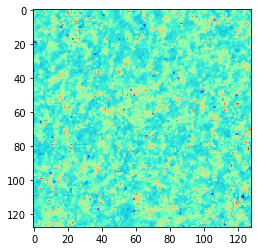

In [ ]:
from scipy.signal import find_peaks
gap_map=np.zeros((128,128))
for x in np.arange(128):
  for y in np.arange(128):
     if SD[x,y,40]>=0.02e-13:
          exp=dIdV1[x,y,:]
          coef=np.polyfit(energy_level_0T,exp, 15)
          polyno = np.poly1d(coef)
          peaks, _ = find_peaks(polyno(energy_level_0T))
          if len(peaks)>=2:
             gap=100
             for X_pos in peaks:
                if gap>(abs(X_pos-40)):
                  gap=abs(X_pos-40)
          print(gap)
          gap_map[x,y]=gap
plt.imshow(gap_map)       

Gap Map done!

(-0.5, 127.5, 127.5, -0.5)

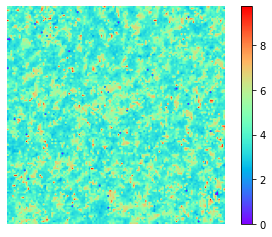

In [ ]:
plt.imshow(gap_map*10/40)
plt.colorbar()
plt.axis('off')

In [ ]:
np.mean(gap_map*10/40)

4.30621337890625

In [ ]:
np.std(gap_map*10/40)

1.2348626281205604

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: RankWarning: Polyfit may be poorly conditioned
  # Python inserts the script's directory into sys.path
/usr/local/lib/python3.7/dist-packages/IPyth

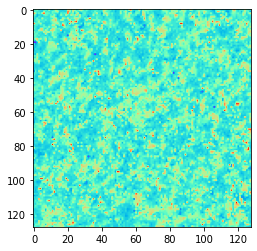

In [ ]:
from scipy.signal import find_peaks
gap_map=np.zeros((128,128))
for x in np.arange(128):
  for y in np.arange(128):
     
     exp=dIdV1[x,y,:]
     coef=np.polyfit(energy_level_0T,exp, 15)
     polyno = np.poly1d(coef)
     peaks, _ = find_peaks(polyno(energy_level_0T))
     if len(peaks)>=2:
        gap=100
        for X_pos in peaks:
           if gap>(abs(X_pos-40)):
             gap=abs(X_pos-40)
     gap_map[x,y]=gap
plt.imshow(gap_map) 

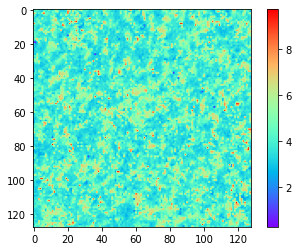

In [ ]:
plt.imshow(gap_map/40*10)
plt.colorbar() 

#3.Define some functions

##normalize the intensities in the image

In [ ]:
def normalize_image(image):
    """
    Normalizes the provided image from 0 to 1

    Parameters
    ----------
    image : np.array object
        Image to be normalized

    Returns
    -------
    image : np.array object
        Image normalized from 0 to 1
    """
    return (image - np.amin(image)) / (np.amax(image) - np.amin(image))
    


##display two images side by side

In [ ]:
def twin_image_plot(images, titles, cmap=plt.cm.viridis):
    """
    Handy function that plots two images side by side with colorbars

    Parameters
    ----------
    images : list or array-like
        List of two images defined as 2D numpy arrays
    titles : list or array-like
        List of the titles for each image
    cmap : (Optional) matplotlib.pyplot colormap object or string
        Colormap to use for displaying the images

    Returns
    -------
    fig : Figure
        Figure containing the plots
    axes : 1D array_like of axes objects
        Axes of the individual plots within `fig`
    """
    fig, axes = plt.subplots(ncols=2, figsize=(10, 5))
    for axis, img, title in zip(axes.flat, images, titles):
        usid.plot_utils.plot_map(axis, img, cmap='gray')
        axis.set_title(title)
    fig.tight_layout()
    return fig, axes

##Add markers to the image

In [ ]:
def plot_markers(axis, coordinates, colors):
    """
    plots markers on an image with different colors

    Parameters
    ----------
    axis : matplotlib.pyplot.axes
        Axis to plot in
    coordinates : Iterable
        Tuple containing the X and Y coordinate of the point
    colors : str
        String name of the color of the point

    Returns
    -------

    """
    for clr, point in zip(colors, coordinates):
        axis.scatter(point[0], point[1], color=clr, s=10)

##get topography

In [ ]:
def get_topography(image):
  """
  1) get raw topography from 3ds dataset
  2) do a background subtraction
  3) apply a Gaussian filter
  4) normalize the image
  """
  nx,ny=image.shape
  backgrd=np.zeros((nx,ny)) 
  if nx <= ny:
      for row in np.arange(nx):
              pfit=np.polyfit(np.arange(ny),image[row,:],2)
              backgrd[row,:]=np.polyval(pfit,np.arange(ny))
  else:
      for row in np.arange(ny):
              pfit=np.polyfit(np.arange(nx),image[:,row],2)
              backgrd[:,row]=np.polyval(pfit,np.arange(nx))    

  topo=image - backgrd 
  # topo=normalize_image(topo)
  topo=scipy.ndimage.gaussian_filter(topo,sigma=2)
  # topo=normalize_image(topo)

  return topo


In [ ]:
def get_raw_topography(image):
    nx,ny=image.shape
    backgrd=np.zeros((nx,ny)) 
    if nx <= ny:
       for row in np.arange(nx):
              pfit=np.polyfit(np.arange(ny),image[row,:],2)
              backgrd[row,:]=np.polyval(pfit,np.arange(ny))
    else:
       for row in np.arange(ny):
              pfit=np.polyfit(np.arange(nx),image[:,row],2)
              backgrd[:,row]=np.polyval(pfit,np.arange(nx))    

    topo=image - backgrd
    return topo 

##Plot two images and show the coordinate from the cursor

In [ ]:
def twin_image_plot_with_cursors(image1,image2):
  # !pip install mpld3
  # !pip install "git+https://github.com/javadba/mpld3@display_fix"
  # import mpld3
  # from mpld3 import plugins

# image1=topo_0T
# image2=topo_2T
  nx,ny=image1.shape
  fig, axes = twin_image_plot([image1, image2],
                            ['topography at 0T',
                             'topography at 2T'],
                            cmap='gray')
  plt.xlim(0,nx-1)
  plt.ylim(0,ny-1)
  plugins.connect(fig, plugins.MousePosition(fontsize=14))
  figs=mpld3.display()
  
  return figs

## get the transformation matrix from the topography of a nonzero T dataset

In [ ]:
def get_transformation_matrix(moving):
    # the fixed image is the reference, the moving is the input as in topo_?T
    fixed=topo_0T
    # define the dst coordinates for the fixed image
    coord1=(20,20)
    coord2=(20,100)
    coord3=(100,100)
    dst=[coord1,coord2,coord3]
    dst=np.array(dst)
    # Define the shift range for finding the optimal alignment. 
    # For the current dataset, -1 to 3 is pretty good as 
    # the cross correlation coefficients are pretty large, i.e. >82%
    shiftx=np.arange(-1,4,1)
    shifty=np.arange(-1,4,1)
    src_opt=dst

    count=0
    corr_opt=0
    tform_type='similarity'
    for x1 in shiftx:
      for y1 in shifty:
        for x2 in shiftx:
          for y2 in shifty:
            for x3 in shiftx:
              for y3 in shifty:
               src=dst+np.array([(x1,y1),(x2,y2),(x3,y3)]) # create the coordinates for the moving image
               #get a transormation model
               tform = transform.estimate_transform(tform_type, np.array(src), np.array(dst))
               #operate on the moving image
               moving_corrected = transform.warp(moving, inverse_map=tform.inverse, output_shape=np.shape(moving))
               #evaluate the transformation
               corr = stats.pearsonr(np.reshape(fixed, [128 * 128, 1]).ravel(),
                          np.reshape(moving_corrected, [128 * 128, 1]).ravel())[0]
               # print(corr)
               count=count+1
               if corr>corr_opt:
                  src_opt=src
                  corr_opt=corr
                  diff=src_opt-dst

    print(src_opt)
    print(corr_opt)
    print('the optimal cross correlation is'+str(corr_opt))
    print(np.round(corr_opt, 3))
    print(count)
    print(diff)
    tform=transform.estimate_transform('similarity', np.array(src_opt), np.array(dst))
    return tform     

In [ ]:
def get_transformation_matrix2(moving):
    # the fixed image is the reference, the moving is the input as in topo_?T
    fixed=topo_0T
    # define the dst coordinates for the fixed image
    coord1=(20,20)
    coord2=(100,20)
    coord3=(100,100)
    dst=[coord1,coord2,coord3]
    dst=np.array(dst)
    # Define the shift range for finding the optimal alignment. 
    # For the current dataset, -1 to 3 is pretty good as 
    # the cross correlation coefficients are pretty large, i.e. >82%
    shiftx=np.arange(-5,5,1)
    shifty=np.arange(-5,5,1)
    src_opt=dst
    theta_range=np.arange(-3*np.pi/180,3*np.pi/180,np.pi/1800)
    count=0
    corr_opt=0
    tform_type='similarity'
    for x2 in shiftx:
      for y2 in shifty:
        for theta in theta_range:
            v_up=np.array([0,80])
            v_right=np.array([80,0])
            rot_matrix=np.array([[np.cos(theta), -np.sin(theta)],[np.sin(theta),np.cos(theta)]])
            v_up_prime=np.dot(rot_matrix,v_up)
            v_right_prime=np.dot(rot_matrix,v_right)
            src=np.array([(100+y2-v_up_prime[1],20+x2+v_up_prime[0]),(100+y2,20+x2),(100+y2-v_right_prime[1],20+x2+v_right_prime[0])])

               #src=dst+np.array([(x1,y1),(x2,y2),(x3,y3)]) # create the coordinates for the moving image
               #get a transormation model
            tform = transform.estimate_transform(tform_type, np.array(src), np.array(dst))
               #operate on the moving image
            moving_corrected = transform.warp(moving, inverse_map=tform.inverse, output_shape=np.shape(moving))
               #evaluate the transformation
            corr = stats.pearsonr(np.reshape(fixed, [128 * 128, 1]).ravel(),
                          np.reshape(moving_corrected, [128 * 128, 1]).ravel())[0]
               # print(corr)
            count=count+1
            if corr>corr_opt:
                src_opt=src
                corr_opt=corr
                diff=src_opt-dst

    print(src_opt)
    print(corr_opt)
    print('the optimal cross correlation is'+str(corr_opt))
    print(np.round(corr_opt, 3))
    print(count)
    print(diff)
    tform=transform.estimate_transform('similarity', np.array(src_opt), np.array(dst))
    return tform     

In [ ]:
def get_vortex(dIdV_slice,tform):
    #tform = transform.estimate_transform('similarity', np.array(src_opt), np.array(dst))
   # transform the dIdV2
    # dIdV2_slice=dIdV2[:,:,10].astype('float64')
    dIdV_slice2=dIdV_slice.astype('float64')
    print(dIdV_slice2.dtype)
    print(dIdV_slice2.shape)
    # print(moving.dtype)

    dIdV_corrected = transform.warp(dIdV_slice2, inverse_map=tform.inverse, output_shape=np.shape(dIdV_slice2))
    
    print(dIdV_corrected.shape) 
    vortex_image=dIdV_corrected-dIdV1[:,:,40]
   
    plt.savefig("vortex_image")
    plt.imshow(vortex_image)
    plt.colorbar()
    return vortex_image

# plt.colorbar()

# 4.Topography

read raw topography

In [ ]:
z_raw_0T=dataset_0T.signals['topo']
z_raw_2T=dataset_2T.signals['topo']
z_raw_4T=dataset_4T.signals['topo']
z_raw_6T=dataset_6T.signals['topo']

get smoothed background-subtracted topography

In [ ]:
topo_0T=get_topography(z_raw_0T)
topo_2T=get_topography(z_raw_2T)
topo_4T=get_topography(z_raw_4T)
topo_6T=get_topography(z_raw_6T)

get unsmoothed topography

In [ ]:
topo_0T_unsmoothed=get_raw_topography(z_raw_0T)
topo_2T_unsmoothed=get_raw_topography(z_raw_2T)
topo_4T_unsmoothed=get_raw_topography(z_raw_4T)
topo_6T_unsmoothed=get_raw_topography(z_raw_6T)
# topography_forward=get_raw_topography(raw_Z_f)

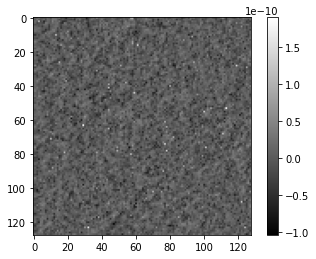

In [ ]:
plt.imshow(topo_0T_unsmoothed,cmap='gray')
plt.colorbar()

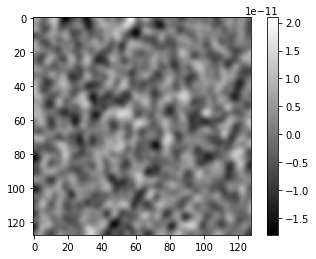

In [ ]:
plt.imshow(topo_0T,cmap='gray')
plt.colorbar()

# 5.Align topographies and get the vortex images

In [ ]:
# read dIdV datasets
dIdV1 = dataset_0T.signals['LIX 1 omega (A)']
dIdV2 = dataset_2T.signals['LIX 1 omega (A)']
dIdV3 = dataset_4T.signals['LIX 1 omega (A)']
dIdV4 = dataset_6T.signals['LIX 1 omega (A)']

In [ ]:
# for 2T
tform2=get_transformation_matrix2(topo_2T)
print(tform2)
# for 4T
tform3=get_transformation_matrix2(topo_4T)
print(tform3)
# for 6T
tform4=get_transformation_matrix2(topo_6T)

[[ 20.00012185  19.13962627]
 [100.          19.        ]
 [100.13962627  98.99987815]]
0.9132732079571626
the optimal cross correlation is0.9132732079571626
0.913
6000
[[ 1.21846937e-04 -8.60373731e-01]
 [ 0.00000000e+00 -1.00000000e+00]
 [ 1.39626269e-01 -1.00012185e+00]]
<SimilarityTransform(matrix=
    [[ 0.99999848, -0.00174533,  0.03331355],
     [ 0.00174533,  0.99999848,  0.8254961 ],
     [ 0.        ,  0.        ,  1.        ]])>
[[ 23.00048739  20.72074789]
 [103.          21.        ]
 [102.72074789 100.99951261]]
0.8644419455915322
the optimal cross correlation is0.8644419455915322
0.864
6000
[[3.00048739 0.72074789]
 [3.         1.        ]
 [2.72074789 0.99951261]]
<SimilarityTransform(matrix=
    [[ 0.99999391,  0.00349065, -3.07267617],
     [-0.00349065,  0.99999391, -0.64033497],
     [ 0.        ,  0.        ,  1.        ]])>
[[ 22.00109662  20.58112289]
 [102.          21.        ]
 [101.58112289 100.99890338]]
0.8835905668862389
the optimal cross correlation is0.8

In [ ]:
print(type(tform2))

<class 'skimage.transform._geometric.SimilarityTransform'>


float64
(128, 128)
(128, 128)
float64
(128, 128)
(128, 128)
float64
(128, 128)
(128, 128)


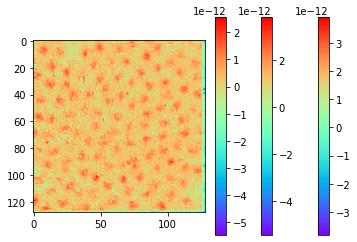

In [ ]:
vortex_2T=get_vortex(dIdV2[:,:,10],tform2)
vortex_4T=get_vortex(dIdV3[:,:,10],tform3)
vortex_6T=get_vortex(dIdV4[:,:,10],tform4)

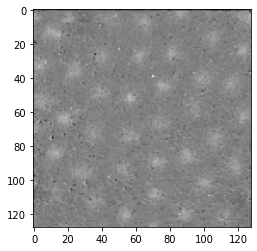

In [ ]:
plt.set_cmap('gray')
plt.imshow(vortex_2T)
#plt.colorbar()

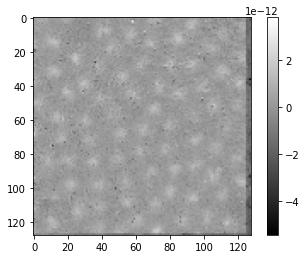

In [ ]:
plt.imshow(vortex_4T)
plt.colorbar()

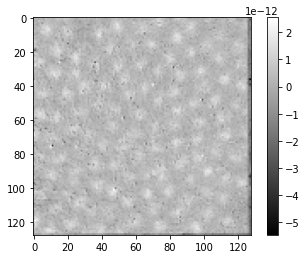

In [ ]:
plt.imshow(vortex_6T)
plt.colorbar()

Now, we create a 4-figures plot 

In [ ]:
import matplotlib.cbook as cbook
!pip install matplotlib-scalebar
from matplotlib_scalebar.scalebar import ScaleBar

NameError: ignored

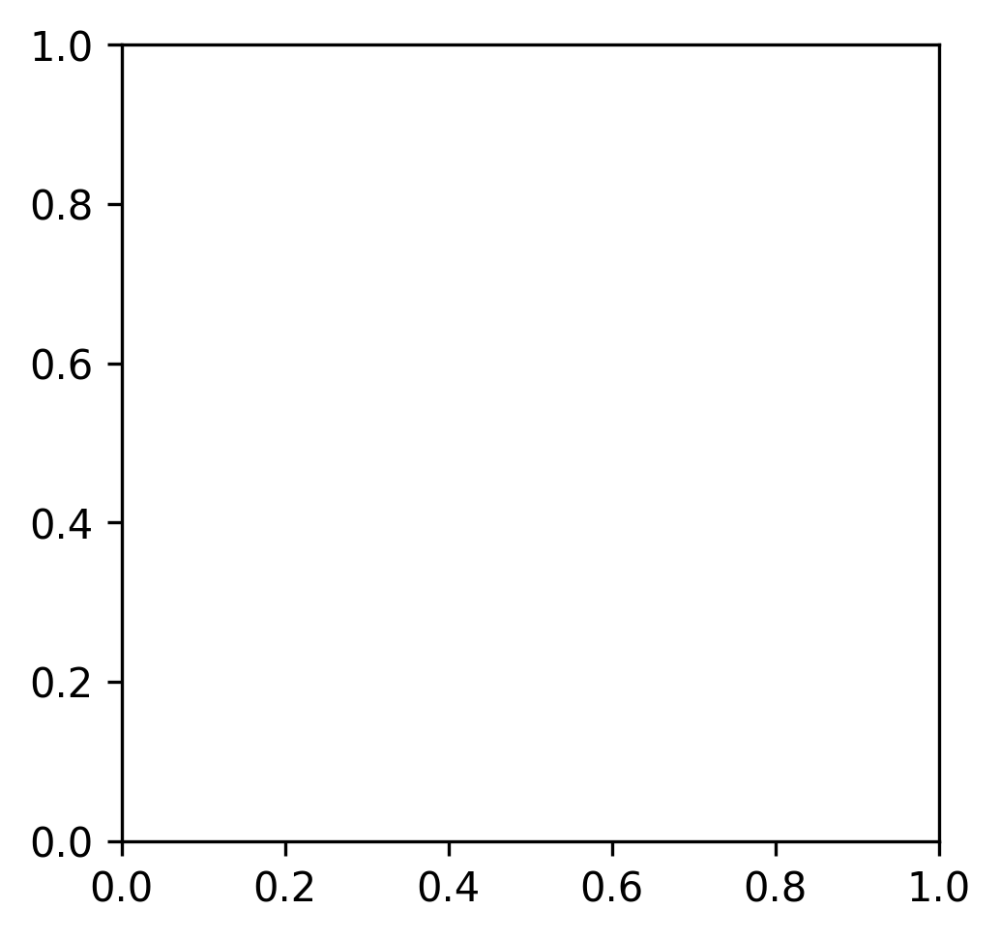

In [ ]:
fig=plt.figure(figsize=(8,8),dpi=300)
ax=fig.add_subplot(221)

image = topography_forward
ax.imshow(image)
scalebar = ScaleBar(scale_bar_512,'nm',location='lower left',box_alpha=0,color='w',length_fraction=0.5)
scalebar.font_properties.set_size('18')
scalebar.font_properties.set_weight('bold')
plt.gca().add_artist(scalebar)
ax.axis('off')
textstr='(a)'
props = dict(facecolor='white', alpha=0)
# place a text box in upper left in axes coords
ax.text(0, 1.08, textstr, transform=ax.transAxes, fontsize=18,
        verticalalignment='top', bbox=props)
ax.set_title('Topography')
ax.title.set_size('18')

ax=fig.add_subplot(222)

image = vortex_2T
ax.imshow(image)
scalebar = ScaleBar(scale_bar_128,'nm',location='lower left',box_alpha=0,color='w',length_fraction=0.5)
scalebar.font_properties.set_size('18')
scalebar.font_properties.set_weight('bold')
plt.gca().add_artist(scalebar)
ax.axis('off')
textstr='(b)'
props = dict(facecolor='white', alpha=0)
# place a text box in upper left in axes coords
ax.text(0, 1.08, textstr, transform=ax.transAxes, fontsize=18,
        verticalalignment='top', bbox=props)
ax.set_title('Vortex image at 2T')
ax.title.set_size('18')

ax=fig.add_subplot(223)
image = vortex_4T
ax.imshow(image)
scalebar = ScaleBar(scale_bar_128,'nm',location='lower left',box_alpha=0,color='w',length_fraction=0.5)
scalebar.font_properties.set_size('18')
scalebar.font_properties.set_weight('bold')
plt.gca().add_artist(scalebar)
ax.axis('off')
textstr='(c)'
props = dict(facecolor='white', alpha=0)
# place a text box in upper left in axes coords
ax.text(0, 1.08, textstr, transform=ax.transAxes, fontsize=18,
        verticalalignment='top', bbox=props)
ax.set_title('Vortex image at 4T')
ax.title.set_size('18')


ax=fig.add_subplot(224)
image = vortex_6T
ax.imshow(image)
scalebar = ScaleBar(scale_bar_128,'nm',location='lower left',box_alpha=0,color='w',length_fraction=0.5)
scalebar.font_properties.set_size('18')
scalebar.font_properties.set_weight('bold')
plt.gca().add_artist(scalebar)
ax.axis('off')
textstr='(d)'
props = dict(facecolor='white', alpha=0)
# place a text box in upper left in axes coords
ax.text(0, 1.08, textstr, transform=ax.transAxes, fontsize=18,
        verticalalignment='top', bbox=props)
ax.set_title('Vortex image at 6T')
ax.title.set_size('18')

plt.tight_layout()

It seems that the topography contains some atomic resolution. Let's do a FFT of it

In [ ]:

padded_topography_forward=np.pad(topography_forward, ((256,256),(256,256)), 'constant')
plt.imshow(padded_topography_forward)

from scipy import fftpack

plt.set_cmap('hsv')
FFT=scipy.fftpack.fft2(padded_topography_forward,shape=(512,512))
FFT3=scipy.fftpack.fftshift(FFT)
plt.imshow(abs(FFT3))
ax.axis('off')
plt.colorbar()


In [ ]:
from scipy import fftpack
#FFT=fftpack.fft2(topography_forward)
plt.set_cmap('hsv')
FFT=scipy.fftpack.fft2(topography_forward)
FFT2=scipy.fftpack.fftshift(FFT)

fig=plt.figure(figsize=(8,8),dpi=300)

ax=fig.add_subplot()
ax.imshow(abs(FFT2))
ax.axis('off')
#ax.colorbar()


# 6.Smooth and normalize the vortex images, and remove margins
## we apply the masks to the normalized vortex images and the margins will be zeros

In [ ]:
mask_one=np.ones((128,128)).astype('float64')

mask_for2T=transform.warp(mask_one, inverse_map=tform2.inverse, output_shape=np.shape(mask_one))
mask_for4T=transform.warp(mask_one, inverse_map=tform3.inverse, output_shape=np.shape(mask_one))
mask_for6T=transform.warp(mask_one, inverse_map=tform4.inverse, output_shape=np.shape(mask_one))

In [ ]:
from numpy import savez
from numpy import save

In [ ]:
save('mask_for2T.npy',mask_for2T)
save('mask_for4T.npy',mask_for4T)

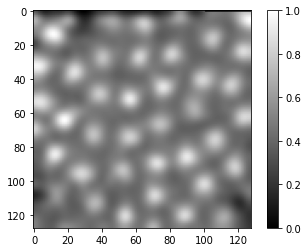

In [ ]:
vortex_2T_int=scipy.ndimage.gaussian_filter(vortex_2T*mask_for2T,sigma=3)*mask_for2T
vortex_2T_done=normalize_image(vortex_2T_int)*mask_for2T
plt.imshow(vortex_2T_done)
plt.colorbar()

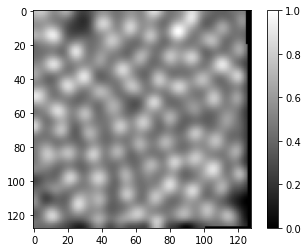

In [ ]:
vortex_4T_int=scipy.ndimage.gaussian_filter(vortex_4T*mask_for4T,sigma=3)*mask_for4T
vortex_4T_done=normalize_image(vortex_4T_int)*mask_for4T
plt.imshow(vortex_4T_done)
plt.colorbar()

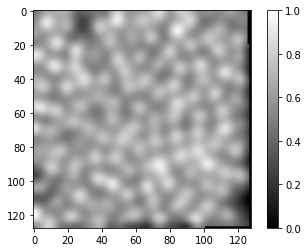

In [ ]:
vortex_6T_int=scipy.ndimage.gaussian_filter(vortex_6T*mask_for6T,sigma=3)*mask_for6T
vortex_6T_done=normalize_image(vortex_6T_int)*mask_for6T
plt.imshow(vortex_6T_done)
plt.colorbar()
plt.set_cmap('gray')

#7.Find the centers of the cores by getting local maxima (the centers of the cores)

(38, 2)
38


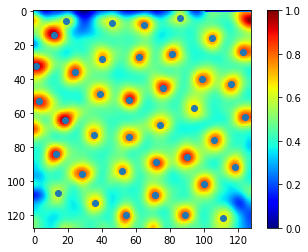

In [ ]:
plt.set_cmap('jet')
data2 = vortex_2T_done
from skimage.feature import peak_local_max
xy2= peak_local_max(data2, min_distance=1,threshold_abs=0.5)
array1,array2=np.hsplit(xy2,2)
plt.scatter(array2,array1)
plt.imshow(vortex_2T_done)
plt.colorbar()
print(xy2.shape)
# print(xy2)
num_cores2,dimension=xy2.shape
print(num_cores2)

(71, 2)
71


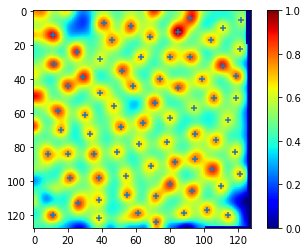

In [ ]:
plt.set_cmap('jet')
data4 = vortex_4T_done
from skimage.feature import peak_local_max
xy4= peak_local_max(data4, min_distance=1,threshold_abs=0.4)
array1,array2=np.hsplit(xy4,2)
plt.scatter(array2,array1,marker='+')
plt.imshow(vortex_4T_done)
plt.colorbar()
print(xy4.shape)
num_cores4,dimension=xy4.shape
print(num_cores4)
# print(xy4)

(99, 2)
99


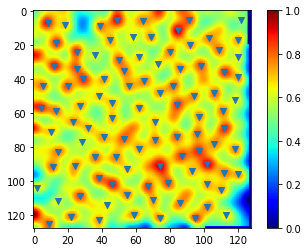

In [ ]:
plt.set_cmap('jet')
data6 = vortex_6T_done
from skimage.feature import peak_local_max
xy6= peak_local_max(data6, min_distance=1,threshold_abs=0.2)
array1,array2=np.hsplit(xy6,2)
plt.scatter(array2,array1,marker='v')
plt.imshow(vortex_6T_done)
plt.colorbar()
print(xy6.shape)
num_cores6,dimension=xy6.shape
print(num_cores6)

In [ ]:
print(xy6)

[[ 11  85]
 [ 91  74]
 [ 90 102]
 [  5  49]
 [102  46]
 [  7   8]
 [ 57   4]
 [ 32  12]
 [ 69 112]
 [ 36 112]
 [ 82  97]
 [ 40  29]
 [ 19  13]
 [103  67]
 [ 55  84]
 [ 24  25]
 [122  95]
 [ 85  87]
 [101  79]
 [  5  91]
 [ 32  98]
 [ 98  38]
 [109  27]
 [ 34  25]
 [ 44  20]
 [ 74  84]
 [ 75  53]
 [125   9]
 [ 29  50]
 [ 44  82]
 [ 72  96]
 [ 48 106]
 [121  22]
 [ 92  11]
 [ 59  13]
 [ 23 109]
 [ 86  36]
 [ 44   5]
 [ 24  80]
 [113  86]
 [ 35  53]
 [  9  39]
 [ 59 111]
 [115 102]
 [ 34  86]
 [122  74]
 [ 95 112]
 [ 41  65]
 [ 86  48]
 [108  55]
 [ 83  14]
 [ 76  71]
 [  6  64]
 [ 50  94]
 [ 16 103]
 [ 78 106]
 [ 62  97]
 [ 81 118]
 [ 15  69]
 [ 44  56]
 [ 91  24]
 [ 65  23]
 [ 74  41]
 [ 40  41]
 [ 48  74]
 [ 20  92]
 [ 57  62]
 [ 81  62]
 [120  59]
 [ 39 120]
 [ 17  45]
 [123  38]
 [ 96 120]
 [ 17 120]
 [111  70]
 [ 56  27]
 [102 102]
 [105 110]
 [ 63  46]
 [ 94  93]
 [ 69  32]
 [ 54  46]
 [ 27  62]
 [  8  18]
 [ 65  71]
 [ 93  55]
 [ 71  10]
 [ 50  38]
 [ 31  73]
 [120 113]
 [114  43]

save the coordinates of the vortices

In [ ]:
savez('coordinates of the vortices.npy',xy2,xy4,xy6)

In [ ]:
import math
def distance(xy_2T,xy_4T):
    xy_2T_float=xy_2T.astype('float64')
    xy_4T_float=xy_4T.astype('float64') 
    array1_2T,array2_2T=np.hsplit(xy_2T_float,2)
    array1_4T,array2_4T=np.hsplit(xy_4T_float,2)
    distance=math.sqrt((array1_2T-array1_4T)**2+(array2_2T-array2_4T)**2)
    return distance

#Finding the core centers that overlap under different magnetic fields

In [ ]:
# define the minimum radius within which the vortices positions remain under increasing magnetic field
r0=3

The following section can find the cores that did not move (r < r0) when increasing B=2T to B=4T 

In [ ]:
xy2_temp=np.array([0])
xy4_temp=np.array([0])
count_2T_4T=0
# print(xy2)
for xy_2T in xy2:
   for xy_4T in xy4:
       dist=distance(xy_2T,xy_4T)
       if dist<=r0:
          count_2T_4T=count_2T_4T+1
          array1,array2=np.hsplit(xy_2T,2)
          xy2_temp=np.append(xy2_temp,xy_2T)
          xy4_temp=np.append(xy4_temp,xy_4T)
          # print(xy_2T)
                
xy2_temp=np.delete(xy2_temp,[0])
xy4_temp=np.delete(xy4_temp,[0])
# print('')
# print(xy2_temp)
length2=math.floor(len(xy2_temp)/2)
length4=math.floor((len(xy4_temp)/2))

xy2_temp=xy2_temp.reshape(length2,2)
xy4_temp=xy4_temp.reshape(length4,2)
       
print('There are '+str(count_2T_4T)+'/'+str(num_cores2)+' cores in the 2T vortex image that remain in the same positions in the 4T vortex image')
# print('These cores are located at')
# print('xy2_temp')
# print(xy2_temp)
# print('xy4_temp')
# print(xy4_temp)  


There are 14/38 cores in the 2T vortex image that remain in the same positions in the 4T vortex image


In [ ]:
print(xy4_temp)

[[ 14  11]
 [ 22 121]
 [109  72]
 [119  88]
 [ 27  63]
 [ 40  99]
 [ 27  80]
 [ 76 107]
 [ 48  39]
 [ 17 104]
 [ 72  33]
 [ 28  39]
 [111  38]
 [ 57  94]]


In [ ]:
# save numpy array as npy file
from numpy import asarray
from numpy import savez

# save to npy file
savez('pinned_for_2T_4T.npy',xy2_temp,xy4_temp)

In [ ]:
xy4_temp2=np.array([0])
xy6_temp2=np.array([0])
count_4T_6T=0
# print(xy2)
for xy_4T in xy4:
   for xy_6T in xy6:
       dist=distance(xy_4T,xy_6T)
       if dist<=r0:
          count_4T_6T=count_4T_6T+1
          array1,array2=np.hsplit(xy_4T,2)
          xy4_temp2=np.append(xy4_temp2,xy_4T)
          xy6_temp2=np.append(xy6_temp2,xy_6T)
          # print(xy_4T)
                
xy4_temp2=np.delete(xy4_temp2,[0])
xy6_temp2=np.delete(xy6_temp2,[0])
# print('')
# print(xy4_temp)
length4=math.floor(len(xy4_temp2)/2)
length6=math.floor((len(xy6_temp2)/2))

xy4_temp2=xy4_temp2.reshape(length4,2)
xy6_temp2=xy6_temp2.reshape(length6,2)
       
print('There are '+str(count_4T_6T)+'/'+str(num_cores4)+' cores in the 2T vortex image that remain in the same positions in the 4T vortex image')
# print('These cores are located at')
print('xy4_temp2')
print(xy4_temp2)
print('xy6_temp2')
print(xy6_temp2) 

There are 37/71 cores in the 2T vortex image that remain in the same positions in the 4T vortex image
xy4_temp2
[[ 12  85]
 [  4  92]
 [ 39  29]
 [ 24  25]
 [ 31  12]
 [102  80]
 [ 44  20]
 [ 59  14]
 [ 35  52]
 [  7  41]
 [ 98  38]
 [ 38 119]
 [ 84  35]
 [119  61]
 [124  72]
 [ 51 106]
 [ 17  46]
 [108  55]
 [ 72  95]
 [109  72]
 [ 27  80]
 [ 44  58]
 [ 15  68]
 [117 102]
 [ 76 107]
 [ 17 104]
 [120 114]
 [ 96 121]
 [ 48  39]
 [ 27  63]
 [ 78  62]
 [103 110]
 [ 56  47]
 [122  38]
 [ 83 118]
 [ 51 119]
 [  5 122]]
xy6_temp2
[[ 11  85]
 [  5  91]
 [ 40  29]
 [ 24  25]
 [ 32  12]
 [101  79]
 [ 44  20]
 [ 59  13]
 [ 35  53]
 [  9  39]
 [ 98  38]
 [ 39 120]
 [ 86  36]
 [120  59]
 [122  74]
 [ 48 106]
 [ 17  45]
 [108  55]
 [ 72  96]
 [111  70]
 [ 24  80]
 [ 44  56]
 [ 15  69]
 [115 102]
 [ 78 106]
 [ 16 103]
 [120 113]
 [ 96 120]
 [ 50  38]
 [ 27  62]
 [ 81  62]
 [105 110]
 [ 54  46]
 [123  38]
 [ 81 118]
 [ 52 118]
 [  5 122]]


In [ ]:
# save to npy file
savez('pinned_for_4T_6T.npy',xy4_temp2,xy6_temp2)

In [ ]:
xy2_temp3=np.array([0])
xy4_temp3=np.array([0])
xy6_temp3=np.array([0])
count_2T_4T_6T=0

for xy_2T in xy2:
  for xy_4T in xy4:
    for xy_6T in xy6:
      #  xy_2T_float=xy_2T.astype('float')
      #  xy_4T_float=xy_4T.astype('float') 
       dist=distance(xy_2T,xy_6T)
       dist2=distance(xy_2T,xy_4T)
       dist3=distance(xy_4T,xy_6T)
       if dist<=r0 and dist2<=r0 and dist3<=r0: 
              count_2T_4T_6T=count_2T_4T_6T+1
              xy2_temp3=np.append(xy2_temp3,xy_2T)
              xy4_temp3=np.append(xy4_temp3,xy_4T)
              xy6_temp3=np.append(xy6_temp3,xy_6T)

xy2_temp3=np.delete(xy2_temp3,[0])
xy4_temp3=np.delete(xy4_temp3,[0])
xy6_temp3=np.delete(xy6_temp3,[0])
# print('')
# print(xy4_temp)
length2=math.floor(len(xy2_temp3)/2)
length4=math.floor(len(xy4_temp3)/2)
length6=math.floor((len(xy6_temp3)/2))

xy2_temp3=xy2_temp3.reshape(length2,2)
xy4_temp3=xy4_temp3.reshape(length4,2)
xy6_temp3=xy6_temp3.reshape(length6,2)

print('There are '+str(count_2T_4T_6T)+'/'+str(num_cores2)+' cores in the 2T vortex image that remain in the same positions in the 4T and 6T vortex image')
print('These cores are located at')
print(xy2_temp3)
print('xy4_temp2')
print(xy4_temp3)
print('xy6_temp2')
print(xy6_temp3) 


There are 5/38 cores in the 2T vortex image that remain in the same positions in the 4T and 6T vortex image
These cores are located at
[[ 27  62]
 [ 25  81]
 [ 76 106]
 [ 49  39]
 [ 16 105]]
xy4_temp2
[[ 27  63]
 [ 27  80]
 [ 76 107]
 [ 48  39]
 [ 17 104]]
xy6_temp2
[[ 27  62]
 [ 24  80]
 [ 78 106]
 [ 50  38]
 [ 16 103]]


In [ ]:
# save to npy file
savez('pinned_for_2T_4T_6T.npy',xy2_temp3,xy4_temp3,xy6_temp3)

In [ ]:
count_2T_6T=0
for xy_2T in xy2:
  for xy_4T in xy4:
    for xy_6T in xy6:
      #  xy_2T_float=xy_2T.astype('float')
      #  xy_4T_float=xy_4T.astype('float') 
       dist=distance(xy_2T,xy_6T)
       dist2=distance(xy_2T,xy_4T)
       dist3=distance(xy_4T,xy_6T)
       if dist<=r0 and dist2<=r0 and dist3<=r0: 
              count_2T_6T=count_2T_6T+1
          

print('There are '+str(count_2T_6T)+'/'+str(num_cores2)+' cores in the 2T vortex image that remain in the same positions in the 6T vortex image')

There are 5/38 cores in the 2T vortex image that remain in the same positions in the 6T vortex image


#8.Transform the dIdV data cube

The relevant translation+rotation is applied to the dIdV data cubes for B>0 T

In [ ]:
dIdV2_new=np.zeros((128,128,21)).astype('float64')
dIdV3_new=np.zeros((128,128,21)).astype('float64')
dIdV4_new=np.zeros((128,128,21)).astype('float64')

for E in np.arange(21):
    dIdV2_new[:,:,E]=transform.warp(dIdV2[:,:,E].astype('float64'), inverse_map=tform2.inverse, output_shape=np.shape(dIdV2[:,:,10]))*mask_for2T
    dIdV3_new[:,:,E]=transform.warp(dIdV3[:,:,E].astype('float64'), inverse_map=tform3.inverse, output_shape=np.shape(dIdV3[:,:,10]))*mask_for4T
    dIdV4_new[:,:,E]=transform.warp(dIdV4[:,:,E].astype('float64'), inverse_map=tform4.inverse, output_shape=np.shape(dIdV4[:,:,10]))*mask_for6T
   

In [ ]:
# save numpy array as npy file
from numpy import asarray
from numpy import save

# save to npy file
save('dIdV2_aligned.npy', dIdV2_new)
save('dIdV1.npy',dIdV1)
save('dIdV3_aligned.npy',dIdV3_new)
save('dIdV4_aligned.npy',dIdV4_new)

# 9.Change the distances from here

load colours3.npy 

In [ ]:
colours3=np.load('colours3.npy')

FileNotFoundError: ignored

In [ ]:
# The function collect coordinates from a specified neighborhood of each vortex.
def get_coordinates_within(r1,r2):
    ring1=[(0,0)] # create a list of coordinates so that  
    import math
    for dx in np.arange(-r2-1,r2+1):
        for dy in np.arange(-r2-1,r2+1):
             if math.sqrt(dx**2+dy**2)>=r1 and math.sqrt(dx**2+dy**2)<=r2:
                   ring1.append((dx,dy))
    ring1.remove((0,0))

    XXYY_2T=[(0,0)]
    for num,(i,j)in enumerate(xy2):
        for NO_circle,(dx,dy) in enumerate(ring1):
            if (i+dx)<=127 and (j+dy)<=127 and (i+dx)>=0 and (j+dy)>=0 and np.sum(dIdV2_new[i+dx,j+dy,:])!=0: # exclude all margins 
                       XXYY_2T.append((i+dx,j+dy))
                       # exclude the points which are in the neigbhorhood (r<=r1) of a neighboring point
                       for (x,y) in xy2:
                           if (x,y)!=(i,j) and (i+dx-x)**2+(j+dy-y)**2<r1**2:
                              while (i+dx,j+dy) in XXYY_2T:XXYY_2T.remove((i+dx,j+dy))
    XXYY_2T.remove((0,0))

    for (XX,YY) in XXYY_2T:
      if np.sum(dIdV2_new[i+dx,j+dy,:])==0:
         XXYY_2T.remove((XX,YY))
        
    XXYY_4T=[(0,0)]
    for num,(i,j)in enumerate(xy4):
        for NO_circle,(dx,dy) in enumerate(ring1):
             if (i+dx)<=127 and (j+dy)<=127 and (i+dx)>=0 and (j+dy)>=0 and np.sum(dIdV3_new[i+dx,j+dy,:])!=0: #and colours3[i,j]==3:
                      XXYY_4T.append((i+dx,j+dy))
                        # exclude the points which are in the neigbhorhood (r<=r1) of a neighboring point
                      for (x,y) in xy4:
                         if (x,y)!=(i,j) and (i+dx-x)**2+(j+dy-y)**2<r1**2:
                            while (i+dx,j+dy) in XXYY_4T: XXYY_4T.remove((i+dx,j+dy))
    XXYY_4T.remove((0,0))

    for (XX,YY) in XXYY_4T:
       if np.sum(dIdV3_new[XX,YY,:])==0:
          XXYY_4T.remove((XX,YY))

    XXYY_6T=[(0,0)]
    for num,(i,j)in enumerate(xy6):
        for NO_circle,(dx,dy) in enumerate(ring1):
             if (i+dx)<=127 and (j+dy)<=127 and (i+dx)>=0 and (j+dy)>=0 and np.sum(dIdV4_new[i+dx,j+dy,:])!=0:
                 XXYY_6T.append((i+dx,j+dy))
          # exclude the points which are in the neigbhorhood (r<=r1) of a neighboring point
                 for (x,y) in xy6:
                     if (x,y)!=(i,j) and (i+dx-x)**2+(j+dy-y)**2<r1**2:
                           while (i+dx,j+dy) in XXYY_6T:XXYY_6T.remove((i+dx,j+dy))
    XXYY_6T.remove((0,0))

    for (XX,YY) in XXYY_6T:
       if np.sum(dIdV4_new[XX,YY,:])==0:
          XXYY_6T.remove((XX,YY))
    return XXYY_2T,XXYY_4T,XXYY_6T


# The switch button


0.   switch=0 if all the cores are of interest
1.   switch=1 if the fixed cores between 2T and 4T are of interest
2.   switch=2 if the fixed cores between 4T and 6T are of interest
3.   switch=3 if fixed cores among 2T, 4T and 6T are of interest


Change the value of the variable "switch" and click run after to see the results


In [ ]:
switch=0

In [ ]:
def get_the_relevant_coord(XXYY_2T,XXYY_4T,XXYY_6T,r1,r2,switch):

    if switch==0:
      XXYY_2T_new=XXYY_2T
      XXYY_4T_new=XXYY_4T
      XXYY_6T_new=XXYY_6T

    if switch==1:
       XXYY_2T_new=[(0,0)]
       XXYY_4T_new=[(0,0)]
       
       for XY_2T in XXYY_2T:
          for xy_2T in xy2_temp:
             if (XY_2T[0]-xy_2T[0])**2+(XY_2T[1]-xy_2T[1])**2<=r2**2 and (XY_2T[0]-xy_2T[0])**2+(XY_2T[1]-xy_2T[1])**2>=r1**2:
                # print(XY_2T)
                XXYY_2T_new.append((XY_2T[0],XY_2T[1]))

       for XY_4T in XXYY_4T:
          for xy_4T in xy4_temp:
             if (XY_4T[0]-xy_4T[0])**2+(XY_4T[1]-xy_4T[1])**2<=r2**2 and (XY_4T[0]-xy_4T[0])**2+(XY_4T[1]-xy_4T[1])**2>=r1**2:
                XXYY_4T_new.append((XY_4T[0],XY_4T[1]))
       XXYY_2T_new.remove((0,0))
       XXYY_4T_new.remove((0,0))
       XXYY_6T_new=XXYY_6T

    if switch==2:
       
       XXYY_4T_new=[(0,0)]
       XXYY_6T_new=[(0,0)]
       for XY_4T in XXYY_4T:
          for xy_4T in xy4_temp2:
             if (XY_4T[0]-xy_4T[0])**2+(XY_4T[1]-xy_4T[1])**2<=r2**2 and (XY_4T[0]-xy_4T[0])**2+(XY_4T[1]-xy_4T[1])**2>=r1**2:
                # print(XY_4T)
                XXYY_4T_new.append((XY_4T[0],XY_4T[1]))

       for XY_6T in XXYY_6T:
          for xy_6T in xy6_temp2:
             if (XY_6T[0]-xy_6T[0])**2+(XY_6T[1]-xy_6T[1])**2<=r2**2 and (XY_6T[0]-xy_6T[0])**2+(XY_6T[1]-xy_6T[1])**2>=r1**2:
                XXYY_6T_new.append((XY_6T[0],XY_6T[1]))
       XXYY_2T_new=XXYY_2T
       XXYY_4T_new.remove((0,0))
       XXYY_6T_new.remove((0,0))

    if switch==3:
       XXYY_2T_new=[(0,0)]
       XXYY_4T_new=[(0,0)]
       XXYY_6T_new=[(0,0)]
       
       for XY_2T in XXYY_2T:
          for xy_2T in xy2_temp3:
             if (XY_2T[0]-xy_2T[0])**2+(XY_2T[1]-xy_2T[1])**2<=r2**2 and (XY_2T[0]-xy_2T[0])**2+(XY_2T[1]-xy_2T[1])**2>=r1**2:
                # print(XY_2T)
                XXYY_2T_new.append((XY_2T[0],XY_2T[1]))

       for XY_4T in XXYY_4T:
          for xy_4T in xy4_temp3:
             if (XY_4T[0]-xy_4T[0])**2+(XY_4T[1]-xy_4T[1])**2<=r2**2 and (XY_4T[0]-xy_4T[0])**2+(XY_4T[1]-xy_4T[1])**2>=r1**2:
                # print(XY_4T)
                XXYY_4T_new.append((XY_4T[0],XY_4T[1]))

       for XY_6T in XXYY_6T:
          for xy_6T in xy6_temp3:
             if (XY_6T[0]-xy_6T[0])**2+(XY_6T[1]-xy_6T[1])**2<=r2**2 and (XY_6T[0]-xy_6T[0])**2+(XY_6T[1]-xy_6T[1])**2>=r1**2:
                XXYY_6T_new.append((XY_6T[0],XY_6T[1]))
       XXYY_2T_new.remove((0,0))
       XXYY_4T_new.remove((0,0))
       XXYY_6T_new.remove((0,0))




    return XXYY_2T_new, XXYY_4T_new,XXYY_6T_new

In [ ]:
def Diff(li1, li2): 
    li_dif = [i for i in li1 + li2 if i not in li1 or i not in li2] 
    return li_dif 

In [ ]:
guo=[(1,2),(3,4),(5,6)]
yue=[(3,4)]
ming=Diff(guo,yue)
print(ming)

[(1, 2), (5, 6)]


In [ ]:
def get_the_irrelevant_coord(XXYY_2T,XXYY_4T,XXYY_6T,r1,r2,switch):
    XXYY_2T_new_temp, XXYY_4T_new_temp,XXYY_6T_new_temp=get_the_relevant_coord(XXYY_2T,XXYY_4T,XXYY_6T,r1,r2,switch)
    ## take the difference between 
    if switch==1:
        XXYY_2T_new=Diff(XXYY_2T,XXYY_2T_new_temp)
        XXYY_4T_new=Diff(XXYY_4T,XXYY_4T_new_temp)
        XXYY_6T_new=XXYY_6T
    
    if switch==2:
       XXYY_2T_new=XXYY_2T
       XXYY_4T_new=Diff(XXYY_4T,XXYY_4T_new_temp)
       XXYY_6T_new=Diff(XXYY_6T,XXYY_6T_new_temp)

    if switch==3:
       XXYY_2T_new=Diff(XXYY_2T,XXYY_2T_new_temp)
       XXYY_4T_new=Diff(XXYY_4T,XXYY_4T_new_temp)
       XXYY_6T_new=Diff(XXYY_6T,XXYY_6T_new_temp) 
    return XXYY_2T_new, XXYY_4T_new,XXYY_6T_new

In [ ]:
# XXYY_2T_new_test,XXYY_4T_new_test,XXYY_6T_new_test=get_the_irrelevant_coord(XXYY_2T,XXYY_4T,XXYY_6T,r1,r2,switch)
# print(XXYY_2T_new_test)
# print(np.shape(XXYY_2T_new_test))
# num_of_coord_2T=len(np.array(XXYY_2T_new_test)[:,0])
# print(num_of_coord_2T)

In [ ]:
# testing
XXYY_2T,XXYY_4T,XXYY_6T=get_coordinates_within(0,4)
XXYY_2T_new, XXYY_4T_new,XXYY_6T_new=get_the_relevant_coord(XXYY_2T,XXYY_4T,XXYY_6T,0,3,switch)
print(XXYY_2T_new)

[(60, 18), (61, 16), (61, 17), (61, 18), (61, 19), (61, 20), (62, 15), (62, 16), (62, 17), (62, 18), (62, 19), (62, 20), (62, 21), (63, 15), (63, 16), (63, 17), (63, 18), (63, 19), (63, 20), (63, 21), (64, 14), (64, 15), (64, 16), (64, 17), (64, 18), (64, 19), (64, 20), (64, 21), (64, 22), (65, 15), (65, 16), (65, 17), (65, 18), (65, 19), (65, 20), (65, 21), (66, 15), (66, 16), (66, 17), (66, 18), (66, 19), (66, 20), (66, 21), (67, 16), (67, 17), (67, 18), (67, 19), (67, 20), (68, 18), (10, 12), (11, 10), (11, 11), (11, 12), (11, 13), (11, 14), (12, 9), (12, 10), (12, 11), (12, 12), (12, 13), (12, 14), (12, 15), (13, 9), (13, 10), (13, 11), (13, 12), (13, 13), (13, 14), (13, 15), (14, 8), (14, 9), (14, 10), (14, 11), (14, 12), (14, 13), (14, 14), (14, 15), (14, 16), (15, 9), (15, 10), (15, 11), (15, 12), (15, 13), (15, 14), (15, 15), (16, 9), (16, 10), (16, 11), (16, 12), (16, 13), (16, 14), (16, 15), (17, 10), (17, 11), (17, 12), (17, 13), (17, 14), (18, 12), (28, 1), (29, 0), (29, 1)

In [ ]:
def get_all_spectra(XXYY_2T,XXYY_4T,XXYY_6T):    
    num_of_coord_2T=len(np.array(XXYY_2T)[:,0])
    num_of_coord_4T=len(np.array(XXYY_4T)[:,0])
    num_of_coord_6T=len(np.array(XXYY_6T)[:,0])

    dIdV2_2T_flat=np.zeros((num_of_coord_2T,21))
    dIdV1_2T_flat=np.zeros((num_of_coord_2T,81))

    dIdV3_4T_flat=np.zeros((num_of_coord_4T,21))
    dIdV1_4T_flat=np.zeros((num_of_coord_4T,81))

    dIdV4_6T_flat=np.zeros((num_of_coord_6T,21))
    dIdV1_6T_flat=np.zeros((num_of_coord_6T,81))

    for num,(XX,YY)in enumerate(XXYY_2T):
        dIdV2_2T_flat[num,:]=dIdV2_new[XX,YY,:]
        dIdV1_2T_flat[num,:]=dIdV1[XX,YY,:]

    for num,(XX,YY)in enumerate(XXYY_4T):
        dIdV3_4T_flat[num,:]=dIdV2_new[XX,YY,:]
        dIdV1_4T_flat[num,:]=dIdV1[XX,YY,:]

    for num,(XX,YY)in enumerate(XXYY_6T):
        dIdV4_6T_flat[num,:]=dIdV2_new[XX,YY,:]
        dIdV1_6T_flat[num,:]=dIdV1[XX,YY,:]
        
    return [dIdV2_2T_flat,dIdV3_4T_flat,dIdV4_6T_flat],[dIdV1_2T_flat,dIdV1_4T_flat,dIdV1_6T_flat]

In [ ]:
def get_averaged_spectra(XXYY_2T,XXYY_4T,XXYY_6T):    
    num_of_coord_2T=len(np.array(XXYY_2T)[:,0])
    num_of_coord_4T=len(np.array(XXYY_4T)[:,0])
    num_of_coord_6T=len(np.array(XXYY_6T)[:,0])

    dIdV2_2T_flat=np.zeros((num_of_coord_2T,21))
    dIdV1_2T_flat=np.zeros((num_of_coord_2T,81))

    dIdV3_4T_flat=np.zeros((num_of_coord_4T,21))
    dIdV1_4T_flat=np.zeros((num_of_coord_4T,81))

    dIdV4_6T_flat=np.zeros((num_of_coord_6T,21))
    dIdV1_6T_flat=np.zeros((num_of_coord_6T,81))


    for num,(XX,YY)in enumerate(XXYY_2T):
        dIdV2_2T_flat[num,:]=dIdV2_new[XX,YY,:]
        dIdV1_2T_flat[num,:]=dIdV1[XX,YY,:]

    for num,(XX,YY)in enumerate(XXYY_4T):
        dIdV3_4T_flat[num,:]=dIdV2_new[XX,YY,:]
        dIdV1_4T_flat[num,:]=dIdV1[XX,YY,:]

    for num,(XX,YY)in enumerate(XXYY_6T):
        dIdV4_6T_flat[num,:]=dIdV2_new[XX,YY,:]
        dIdV1_6T_flat[num,:]=dIdV1[XX,YY,:]

    dIdV2_2T_ave=np.sum(dIdV2_2T_flat,axis=0)/num_of_coord_2T
    dIdV1_2T_ave=np.sum(dIdV1_2T_flat,axis=0)/num_of_coord_2T

    dIdV3_4T_ave=np.sum(dIdV3_4T_flat,axis=0)/num_of_coord_4T
    dIdV1_4T_ave=np.sum(dIdV1_4T_flat,axis=0)/num_of_coord_4T

    dIdV4_6T_ave=np.sum(dIdV4_6T_flat,axis=0)/num_of_coord_6T
    dIdV1_6T_ave=np.sum(dIdV1_6T_flat,axis=0)/num_of_coord_6T

    dIdVX_sum=[dIdV2_2T_ave,dIdV3_4T_ave,dIdV4_6T_ave]
    dIdV1_sum=[dIdV1_2T_ave,dIdV1_4T_ave,dIdV1_6T_ave]
    return dIdVX_sum,dIdV1_sum

#10 The averaged spectra

Plot the averaged dIdV spectra vs distance from the vortex cores

In [ ]:
pip install matplotlib-scalebar

In [ ]:
from matplotlib_scalebar.scalebar import ScaleBar
from matplotlib import rcParams
rcParams["legend.fontsize"]=30

In [ ]:
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar
import matplotlib.font_manager as fm
fontprops = fm.FontProperties(size=30)

[(58, 18), (59, 15), (59, 16), (59, 17), (59, 18), (59, 19), (59, 20), (59, 21), (60, 14), (60, 15), (60, 21), (60, 22), (61, 13), (61, 14), (61, 22), (61, 23), (62, 13), (62, 23), (63, 13), (63, 23), (64, 12), (64, 13), (64, 23), (64, 24), (65, 13), (65, 23), (66, 13), (66, 23), (67, 13), (67, 14), (67, 22), (67, 23), (68, 14), (68, 15), (68, 21), (68, 22), (69, 15), (69, 16), (69, 17), (69, 18), (69, 19), (69, 20), (69, 21), (70, 18), (8, 12), (9, 9), (9, 10), (9, 11), (9, 12), (9, 13), (9, 14), (9, 15), (10, 8), (10, 9), (10, 15), (10, 16), (11, 7), (11, 8), (11, 16), (11, 17), (12, 7), (12, 17), (13, 7), (13, 17), (14, 6), (14, 7), (14, 17), (14, 18), (15, 7), (15, 17), (16, 7), (16, 17), (17, 7), (17, 8), (17, 16), (17, 17), (18, 8), (18, 9), (18, 15), (18, 16), (19, 9), (19, 10), (19, 11), (19, 12), (19, 13), (19, 14), (19, 15), (20, 12), (26, 1), (27, 0), (27, 1), (27, 2), (27, 3), (27, 4), (28, 4), (28, 5), (29, 5), (29, 6), (30, 6), (31, 6), (32, 6), (32, 7), (33, 6), (34, 6),

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:37: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 


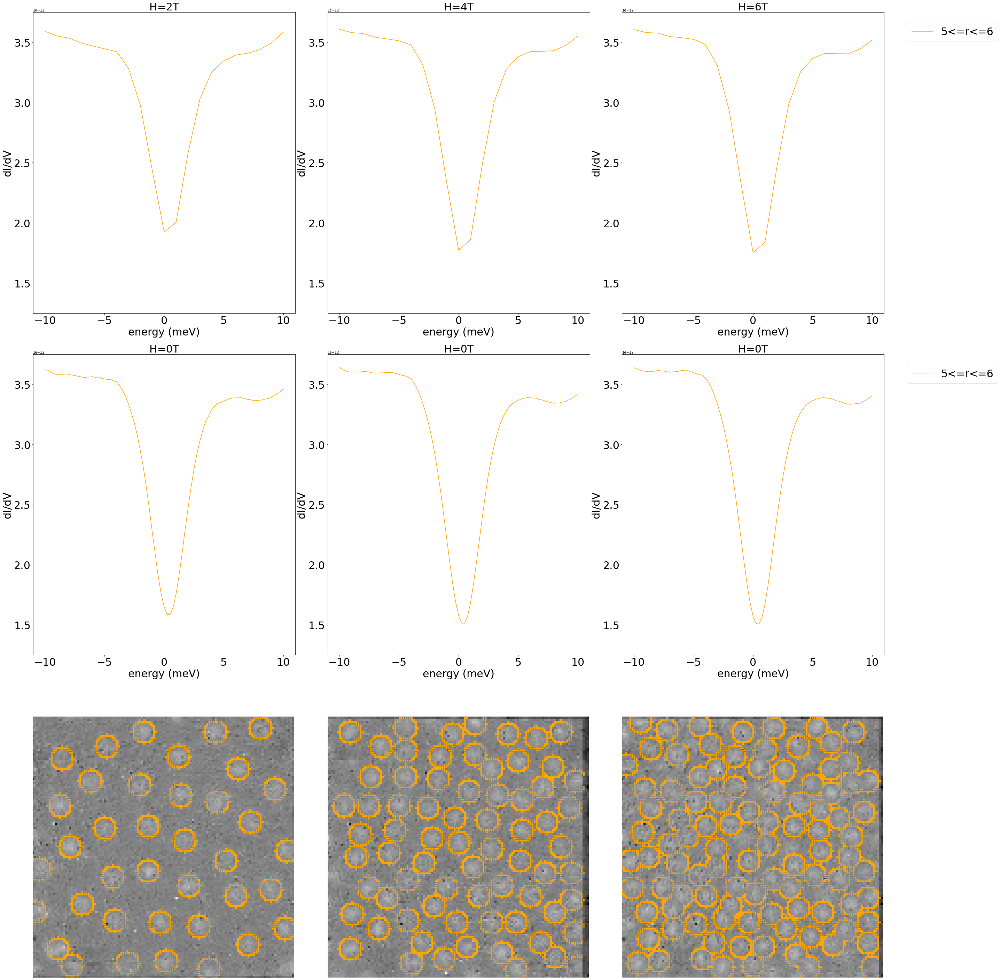

In [ ]:
gs1 = gridspec.GridSpec(3, 3)
fig1 = plt.figure(figsize = (40,40),constrained_layout=True) 
# fig1, ax1 = plt.subplots(nrows=20, ncols=18, constrained_layout=True)
#colors=['blue','orange','green','red','purple','yellow','black','brown','grey','olive']
colors=['orange','red','purple','yellow','black','brown','grey','olive']
fig1.patch.set_facecolor('white')

r_min=5
r_max=6
delta_r=1
count=0


for i in np.arange(r_min,r_max,delta_r): 
    r1=i
    r2=r1+delta_r
    XXYY_2T,XXYY_4T,XXYY_6T=get_coordinates_within(r1,r2)
    # # now if you want to focus on the fixed cores, activate the following 2 lines
    XXYY_2T_new,XXYY_4T_new,XXYY_6T_new=get_the_relevant_coord(XXYY_2T,XXYY_4T,XXYY_6T,r1,r2,switch)
    print(XXYY_2T_new)
    # deactivate the above if you want to look at all the cores

    dIdVX_sum,dIdV1_sum=get_averaged_spectra(XXYY_2T_new,XXYY_4T_new,XXYY_6T_new)
 
   
    for j,dIdVsum in enumerate(dIdVX_sum):
        ax1 = fig1.add_subplot(gs1[0,j])     
        ax1.plot(1000*energy_level_2T, dIdVsum,color=colors[count],label=str(r1)+'<=r<='+str(r2))
        # ax1.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=5.0)
        plt.ylim(1.25e-12,3.75e-12)
        ax1.set_title('H=' + str(2*(j + 1))+'T',fontsize=30)
        ax1.set_xlabel("energy (meV)", fontsize=30)
        ax1.set_ylabel('dI/dV',fontsize=30)
        plt.xticks([-10,-5,0,5,10])
        plt.xticks(fontsize=30)
        plt.yticks(fontsize=30)
        plt.tight_layout(h_pad=2,w_pad=0.5)
        plt.constrained_layout=True
        # ax1.ticklabel_format(scilimits=(0,0))
    ax1.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=1.0)
    for j,dIdVsum in enumerate(dIdV1_sum):
        ax1 = fig1.add_subplot(gs1[1,j])     
        ax1.plot(1000*energy_level_0T, dIdVsum,color=colors[count],label=str(r1)+'<=r<='+str(r2))
        # ax1.legend(bbox_to_anchor=(1.05, 1), loc='upper left',borderaxespad=5.0)
        plt.ylim(1.25e-12,3.75e-12)
        ax1.set_title('H=' + str(0)+'T',fontsize=30)
        ax1.set_xlabel("energy (meV)", fontsize=30)
        ax1.set_ylabel('dI/dV',fontsize=30)
        plt.xticks(fontsize=30)
        plt.xticks([-10,-5,0,5,10])
        plt.yticks(fontsize=30)
        plt.tight_layout(h_pad=2,w_pad=0.5)
        plt.constrained_layout=True
    ax1.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=1.0)
        # ax1.ticklabel_format(scilimits=(0,0))
    vortex_images=[vortex_2T,vortex_4T,vortex_6T]
    #vortex_images=[vortex_2T_done,vortex_4T_done,vortex_6T_done]
    # The next line needs to be modified for fixed cores
    for j,XXYY in enumerate([XXYY_2T_new,XXYY_4T_new,XXYY_6T_new]):
        ax1 = fig1.add_subplot(gs1[2,j])
        ax1.imshow(vortex_images[j],cmap='gray',vmax=4e-12,vmin=-4e-12)
        ax1.scatter(np.array(XXYY)[:,1],np.array(XXYY)[:,0],marker='s',s=10,c=colors[count],edgecolors='face')
        # ax1.imshow(np.flipud(vortex_images[j]),cmap='gray',vmax=4e-12,vmin=-4e-12)
        plt.xlim(0,128)
        plt.ylim(0,128)
        plt.axis('off')
        ax1.set_xlabel('# of pixels',fontsize=26)
        ax1.set_ylabel('# of pixels',fontsize=26)
        plt.xticks(fontsize=30)
        plt.yticks(fontsize=30)
        # scalebar = ScaleBar(1.563,'nm',location='lower left',frameon=False,length_fraction=0.3,border_pad=1) # 1 pixel = 1.16 or 1.563 nm ? a question for Zheng Gai
        # ScaleBar.font_properties.fget.fontsize=1
        # print('ScaleBar.font_properties are')
        # print(ScaleBar.font_properties.fget.fontsize)
        # plt.gca().add_artist(scalebar)
        scalebar = AnchoredSizeBar(ax1.transData,
                           25.6, '40 nm', 'lower left', 
                           pad=0.1,
                           color='white',
                           frameon=False,
                           size_vertical=1,
                           fontproperties=fontprops)
        #ax1.add_artist(scalebar)
        plt.constrained_layout=True
    count=count+1 
        

Create a 2D contour plot with ev and distance as two axes and dIdV as the signal

In [ ]:
# create 2D matrices dIdV(E,)
r_min=0
r_max=10
delta_r=1
count=0

num_r=int((r_max-r_min)/delta_r)



dIdV2_2D=np.zeros((21,num_r))
dIdV3_2D=np.zeros((21,num_r))
dIdV4_2D=np.zeros((21,num_r))

dIdV1_2T_2D=np.zeros((81,num_r))
dIdV1_4T_2D=np.zeros((81,num_r))
dIdV1_6T_2D=np.zeros((81,num_r))


for i in np.arange(r_min,r_max,delta_r): 
    r1=i
    r2=r1+delta_r
    XXYY_2T,XXYY_4T,XXYY_6T=get_coordinates_within(r1,r2)
    # # now if you want to focus on the fixed cores, activate the following 2 lines
    XXYY_2T_new,XXYY_4T_new,XXYY_6T_new=get_the_relevant_coord(XXYY_2T,XXYY_4T,XXYY_6T,r1,r2,switch)
    print(XXYY_2T_new)
    # deactivate the above if you want to look at all the cores

    dIdVX_sum,dIdV1_sum=get_averaged_spectra(XXYY_2T_new,XXYY_4T_new,XXYY_6T_new)
        
    dIdV2_2D[:,r1]=dIdVX_sum[0]
    dIdV3_2D[:,r1]=dIdVX_sum[1]
    dIdV4_2D[:,r1]=dIdVX_sum[2]

    dIdVX_2D=[dIdV2_2D,dIdV3_2D,dIdV4_2D]

    dIdV1_2T_2D[:,r1]=dIdV1_sum[0]
    dIdV1_4T_2D[:,r1]=dIdV1_sum[1]
    dIdV1_6T_2D[:,r1]=dIdV1_sum[2]

    dIdV1_2D=[dIdV1_2T_2D,dIdV1_4T_2D,dIdV1_6T_2D]

# flip the matrices upside down so that the plot shows increasing energy in the vertical axes 
# dIdV2_2D=np.flipud(dIdV2_2D)
# dIdV3_2D=np.flipud(dIdV3_2D)
# dIdV4_2D=np.flipud(dIdV4_2D)

# dIdV1_2T_2D=np.flipud(dIdV1_2T_2D)
# dIdV1_4T_2D=np.flipud(dIdV1_4T_2D)
# dIdV1_6T_2D=np.flipud(dIdV1_6T_2D)
        

[(63, 18), (64, 17), (64, 18), (64, 19), (65, 18), (13, 12), (14, 11), (14, 12), (14, 13), (15, 12), (31, 1), (32, 0), (32, 1), (32, 2), (33, 1), (83, 13), (84, 12), (84, 13), (84, 14), (85, 13), (51, 56), (52, 55), (52, 56), (52, 57), (53, 56), (85, 90), (86, 89), (86, 90), (86, 91), (87, 90), (44, 76), (45, 75), (45, 76), (45, 77), (46, 76), (52, 3), (53, 2), (53, 3), (53, 4), (54, 3), (35, 24), (36, 23), (36, 24), (36, 25), (37, 24), (88, 72), (89, 71), (89, 72), (89, 73), (90, 72), (101, 100), (102, 99), (102, 100), (102, 101), (103, 100), (23, 123), (24, 122), (24, 123), (24, 124), (25, 123), (119, 54), (120, 53), (120, 54), (120, 55), (121, 54), (107, 71), (108, 70), (108, 71), (108, 72), (109, 71), (119, 89), (120, 88), (120, 89), (120, 90), (121, 89), (61, 124), (62, 123), (62, 124), (62, 125), (63, 124), (95, 28), (96, 27), (96, 28), (96, 29), (97, 28), (26, 62), (27, 61), (27, 62), (27, 63), (28, 62), (39, 99), (40, 98), (40, 99), (40, 100), (41, 99), (24, 81), (25, 80), (25,

In [ ]:
dIdVX_2D[0].shape

(21, 10)

Let's create a better plot with shifted spectra

In [ ]:
''''
gs1 = gridspec.GridSpec(2, 3)
fig1 = plt.figure(figsize = (25, 20),constrained_layout=True) 

import matplotlib.cm as cm
colors = cm.rainbow(np.linspace(0, 1, len(dIdV2_2D[0,:])))



for j,dIdVX_2D in enumerate([dIdV2_2D,dIdV3_2D,dIdV4_2D]):
        ax1 = fig1.add_subplot(gs1[0,j])
      

        for i,c in zip(np.arange(r_min,r_max,delta_r),colors):     
           ax1.plot(1000*energy_level_2T, dIdVX_2D[:,i]-i*0.1e-12,color=c,label=str(r1)+'<=r<='+str(r2))
        # ax1.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=5.0)
        plt.ylim(0.5e-12,3.75e-12)
        ax1.set_title('B=' + str(2*(j + 1))+'T',fontsize=30)
        ax1.set_xlabel("Energy (meV)", fontsize=30)
        ax1.set_ylabel('dI/dV',fontsize=30)
        plt.xticks([-10,-5,0,5,10])
        plt.xticks(fontsize=30)
        #plt.yticks(fontsize=30,switch=OFF)
        ax1.get_yaxis().set_visible(False)
        plt.tight_layout(h_pad=2,w_pad=2)
        plt.constrained_layout=True
        # ax1.ticklabel_format(scilimits=(0,0))
        #ax1.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=1.0)
for j,dIdV1_2D in enumerate([dIdV1_2T_2D,dIdV1_4T_2D,dIdV1_6T_2D]):
        ax1 = fig1.add_subplot(gs1[1,j])  
        for i in np.arange(r_min,r_max,delta_r): 
           ax1.plot(1000*energy_level_0T, dIdV1_2D[:,i]-i*0.1e-12,color=colors[i],label=str(r1)+'<=r<='+str(r2))
        # ax1.legend(bbox_to_anchor=(1.05, 1), loc='upper left',borderaxespad=5.0)
        plt.ylim(0.5e-12,3.75e-12)
        ax1.set_title('B=' + str(0)+'T',fontsize=30)
        ax1.set_xlabel("Energy (meV)", fontsize=30)
        ax1.set_ylabel('dI/dV',fontsize=30)
        plt.xticks(fontsize=30)
        plt.xticks([-10,-5,0,5,10])
        #plt.yticks(fontsize=30)
        ax1.get_yaxis().set_visible(False)
        plt.tight_layout(h_pad=2,w_pad=2)
        plt.constrained_layout=True
        #ax1.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=1.0)
        # ax1.ticklabel_format(scilimits=(0,0))
'''
        

'\'\ngs1 = gridspec.GridSpec(2, 3)\nfig1 = plt.figure(figsize = (25, 20),constrained_layout=True) \n\nimport matplotlib.cm as cm\ncolors = cm.rainbow(np.linspace(0, 1, len(dIdV2_2D[0,:])))\n\n\n\nfor j,dIdVX_2D in enumerate([dIdV2_2D,dIdV3_2D,dIdV4_2D]):\n        ax1 = fig1.add_subplot(gs1[0,j])\n      \n\n        for i,c in zip(np.arange(r_min,r_max,delta_r),colors):     \n           ax1.plot(1000*energy_level_2T, dIdVX_2D[:,i]-i*0.1e-12,color=c,label=str(r1)+\'<=r<=\'+str(r2))\n        # ax1.legend(bbox_to_anchor=(1.05, 1), loc=\'upper left\', borderaxespad=5.0)\n        plt.ylim(0.5e-12,3.75e-12)\n        ax1.set_title(\'B=\' + str(2*(j + 1))+\'T\',fontsize=30)\n        ax1.set_xlabel("Energy (meV)", fontsize=30)\n        ax1.set_ylabel(\'dI/dV\',fontsize=30)\n        plt.xticks([-10,-5,0,5,10])\n        plt.xticks(fontsize=30)\n        #plt.yticks(fontsize=30,switch=OFF)\n        ax1.get_yaxis().set_visible(False)\n        plt.tight_layout(h_pad=2,w_pad=2)\n        plt.constrained_

Try to add color bar

In [ ]:
dIdVX_2D[0].shape

(21, 10)

In [ ]:
#n_lines

In [ ]:
#c.shape

findfont: Font family ['times new roman'] not found. Falling back to DejaVu Sans.


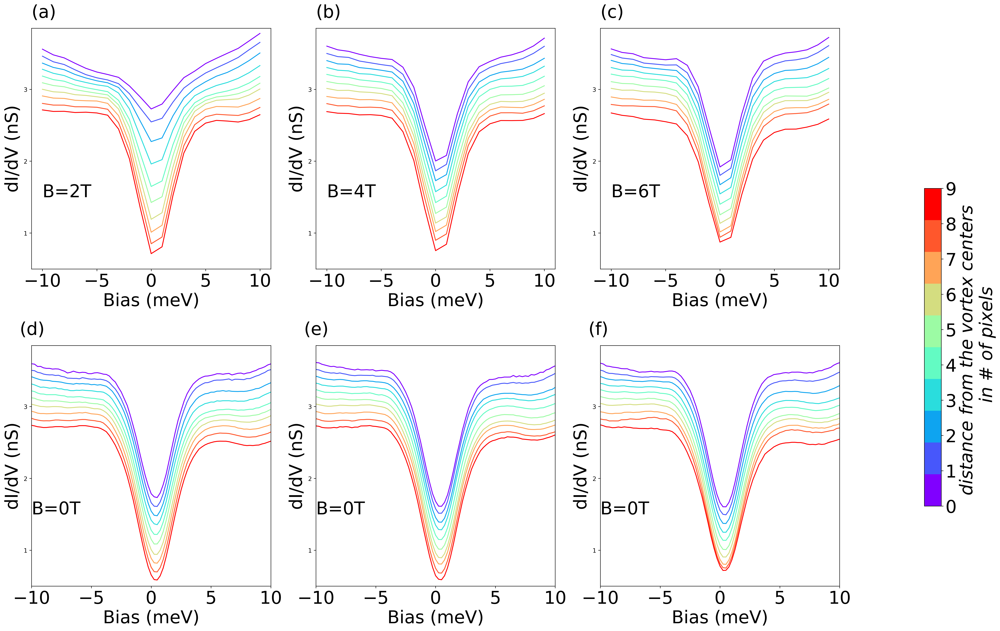

In [ ]:
gs1 = gridspec.GridSpec(2, 3)
fig1 = plt.figure(figsize = (20, 15),dpi=300,constrained_layout=False) 
n_lines=len(dIdV2_2D[0,:])

import matplotlib.cm as cm
import matplotlib as mpl

c=np.flip(np.arange(n_lines))
cmap = cm.get_cmap('rainbow', n_lines)

#fig1, ax1 = plt.subplots(dpi=100)

#Make dummie mappable
dummie_cax = ax1.scatter(c, c, c=c, cmap=cmap)

fig1.patch.set_color('white')

for j,letter in zip([0,1,2],['(a)','(b)','(c)']):
        ax1 = fig1.add_subplot(gs1[0,j])
        ax1.set_facecolor('white')
        for i in np.arange(n_lines):     
           im=ax1.plot(1000*energy_level_2T, (dIdVX_2D[j][:,i]-i*0.1e-12)*1e12,c=cmap(i))
        
        # ax1.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=5.0)
        plt.ylim(0.5,3.85)
        # plt.ylim(0.5e-12,3.85e-12)
        ax1.text(-11,4,letter,fontsize=30)
        # ax1.text(-11,4e-12,letter,fontsize=30)
        ax1.text(-10,1.5,'B=' + str(2*(j + 1))+'T',fontsize=30)
        # ax1.text(-10,1.5e-12,'B=' + str(2*(j + 1))+'T',fontsize=30)
        #ax1.set_title('B=' + str(2*(j + 1))+'T',fontsize=30)
        ax1.set_xlabel("Bias (meV)", fontsize=30)
        ax1.set_ylabel('dI/dV (nS)',fontsize=30)
        plt.xticks([-10,-5,0,5,10])
        plt.xticks(fontsize=30)    
        # ax1.get_yaxis().set_visible(False)
        plt.tight_layout(h_pad=2,w_pad=0)
        plt.constrained_layout=True
# cbar1=fig1.colorbar(dummie_cax,ticks=c)
# cbar1.set_label('distance from the vortex centers \n in # of pixels',rotation=90)
# cbar1.ax.tick_params(axis='both',labelsize=30)
# text = cbar1.ax.yaxis.label
# font = mpl.font_manager.FontProperties(family='times new roman', style='italic', size=30)
# text.set_font_properties(font)


        # ax1.ticklabel_format(scilimits=(0,0))
        #ax1.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=1.0)
for j,letter in zip([0,1,2],['(d)','(e)','(f)']):
        ax1 = fig1.add_subplot(gs1[1,j])  
        ax1.set_facecolor('white')
        for i in np.arange(n_lines):     
           im=ax1.plot(1000*energy_level_0T, (dIdV1_2D[j][:,i]-i*0.1e-12)*1e12,c=cmap(i))
        
        plt.xlim(-10,10)
        plt.ylim(0.5,3.85)
        #  plt.ylim(0.5e-12,3.85e-12)
        ax1.text(-11,4,letter,fontsize=30)
        # ax1.text(-11,4e-12,letter,fontsize=30)
        ax1.text(-10,1.5,'B=' + str(0)+'T',fontsize=30)
        # ax1.text(-10,1.5e-12,'B=' + str(0)+'T',fontsize=30)
        #ax1.set_title('B=' + str(0)+'T',fontsize=30)
        ax1.set_xlabel("Bias (meV)", fontsize=30)
        ax1.set_ylabel('dI/dV (nS)',fontsize=30)
        plt.xticks(fontsize=30)
        plt.xticks([-10,-5,0,5,10])
        plt.ylabel('dI/dV (nS)')
        # ax1.get_yaxis().set_visible(False)
        plt.tight_layout(h_pad=2,w_pad=0)
        plt.constrained_layout=True


# cbar1=fig1.colorbar(dummie_cax,ticks=c)
# cbar1.set_label('distance from the vortex centers \n in # of pixels',rotation=90)
# cbar1.ax.tick_params(axis='both',labelsize=30)
# text = cbar1.ax.yaxis.label
# font = mpl.font_manager.FontProperties(family='times new roman', style='italic', size=30)
# text.set_font_properties(font)


import matplotlib
matplotlib.rc('font', size=30)
fig1.subplots_adjust(right=1)
cbar_ax = fig1.add_axes([1.1, 0.2, 0.02, 0.5])
cbar1=fig1.colorbar(dummie_cax,ticks=c, cax=cbar_ax)
cbar1.ax.tick_params(axis='both',labelsize=30)
cbar1.set_label('distance from the vortex centers \n in # of pixels',rotation=90)
text = cbar1.ax.yaxis.label
font = mpl.font_manager.FontProperties(family='times new roman', style='italic', size=30)
text.set_font_properties(font)


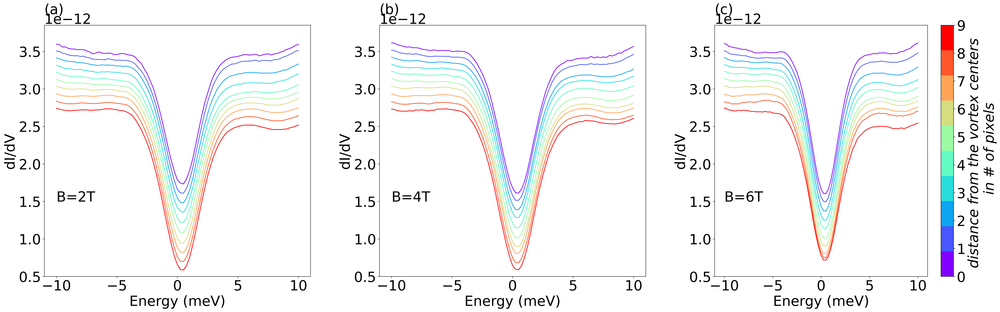

In [ ]:
gs1 = gridspec.GridSpec(1, 3)
fig1 = plt.figure(figsize = (30, 10),dpi=300,constrained_layout=False) 
n_lines=len(dIdV2_2D[0,:])

import matplotlib.cm as cm
import matplotlib as mpl

c=np.arange(n_lines)
cmap = cm.get_cmap('rainbow', n_lines)

#fig1, ax1 = plt.subplots(dpi=100)

fig1.patch.set_facecolor('white')

#Make dummie mappable
dummie_cax = ax1.scatter(c, c, c=c, cmap=cmap)

for j,letter in zip([0,1,2],['(a)','(b)','(c)']):
        ax1 = fig1.add_subplot(gs1[0,j])
        for i in np.arange(n_lines):     
           ax1.plot(1000*energy_level_0T, dIdV1_2D[j][:,i]-i*0.1e-12,c=cmap(i))
        
        # ax1.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=5.0)
        plt.ylim(0.5e-12,3.85e-12)
        ax1.text(-11,4e-12,letter,fontsize=30)
        ax1.text(-10,1.5e-12,'B=' + str(2*(j + 1))+'T',fontsize=30)
        #ax1.set_title('B=' + str(2*(j + 1))+'T',fontsize=30)
        ax1.set_xlabel("Energy (meV)", fontsize=30)
        ax1.set_ylabel('dI/dV',fontsize=30)
        plt.xticks([-10,-5,0,5,10])
        plt.xticks(fontsize=30)    
        #ax1.get_yaxis().set_visible(False)
        plt.tight_layout(h_pad=2,w_pad=2)
        plt.constrained_layout=True
cbar1=fig1.colorbar(dummie_cax,ticks=c)
cbar1.set_label('distance from the vortex centers \n in # of pixels',rotation=90)
cbar1.ax.tick_params(axis='both',labelsize=30)
text = cbar1.ax.yaxis.label
font = mpl.font_manager.FontProperties(family='times new roman', style='italic', size=30)
text.set_font_properties(font)

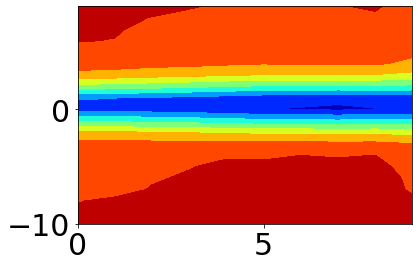

In [ ]:
y= np.arange(-10, 10, 1)
x= np.arange(r_min, r_max, delta_r)
xx,yy=np.meshgrid(x,y, sparse=True)
zz=dIdV4_2D[(yy+10),(xx)]
h = plt.contourf(x,y,zz)
plt.show()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  


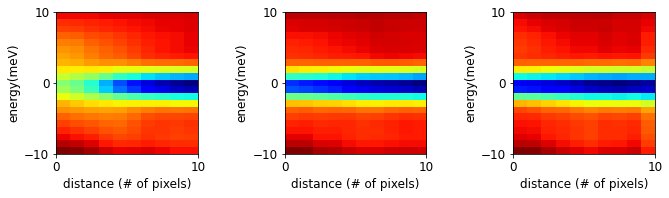

In [ ]:
gs1 = gridspec.GridSpec(2, 3)
fig1 = plt.figure(figsize = (10, 30),constrained_layout= True) 

for j,dIdVX_2D in enumerate([dIdV2_2D,dIdV3_2D,dIdV4_2D]):
        ax1 = fig1.add_subplot(gs1[0,j])
        ax1.imshow(dIdVX_2D,interpolation='none', extent=[0,10,-10,10])
        ax1.set_aspect(0.5)
        #plt.xlim(r_min,r_max)
        #plt.ylim(0,20)
        ax1.set_xlabel('distance (# of pixels)',fontsize=12)
        ax1.set_ylabel('energy(meV)',fontsize=12)
        plt.xticks(fontsize=12)
        plt.yticks(fontsize=12)
        plt.tight_layout(h_pad=2,w_pad=1)
        plt.constrained_layout=True

#plt.imshow(dIdV1_6T_2D)
#plt.colorbar()

Text(0, 0.5, 'energy(meV)')

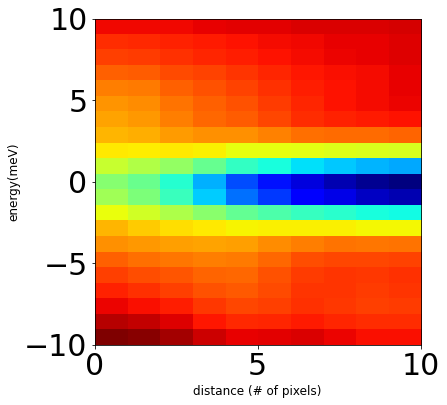

In [ ]:
fig, ax = plt.subplots(figsize=(6,6))

ax.imshow(dIdV2_2D, interpolation='none', extent=[0,10,-10,10])
ax.set_aspect(0.5)
ax.set_xlabel('distance (# of pixels)',fontsize=12)
ax.set_ylabel('energy(meV)',fontsize=12)

What does the average of dIdV2 over all area look like?

(1.25e-12, 3.75e-12)

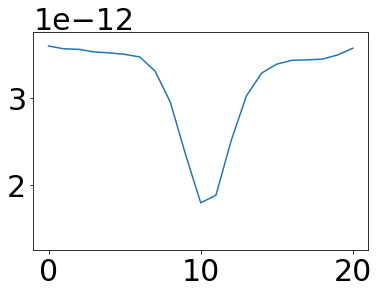

In [ ]:
dIdV2_sum=np.sum(np.sum(dIdV2_new[:,:,:],axis=0),axis=0)/(128*128)
plt.plot(dIdV2_sum)
plt.ylim(1.25e-12,3.75e-12)

# 11.PCA analyses

In [ ]:
def PCA_for_dIdV(dIdV_flat,NC):
    from sklearn.decomposition import PCA,KernelPCA
    pca=PCA(whiten=True)
    pca.fit(dIdV_flat[:,:])
    explained_var = pca.explained_variance_ratio_
    # plt.plot(explained_var[0:10000], 'o')
    # plt.semilogy()
    # plt.title('scree plot')
    # plt.xlabel('Principal component')
    # plt.ylabel('Explained variance ratio')
    # find the first n components that explain over 95%
    sum=0
    nc=0
    i=0
    while sum<0.95:
       sum=sum+explained_var[i]
       nc=nc+1
       i=i+1
    print(str(nc)+'components can explain'+str(sum)+'of the behavior')
      

    pca = PCA(n_components=NC)
    X_vec_t = pca.fit_transform(dIdV_flat[:,:])
    components = pca.components_


    # let's set each component more positive, so that it's easier to compare?
    for i in np.arange(0,NC):
        if np.sum(components[i,:])<np.sum(-1*components[i,:]):
            components[i,:]=-components[i,:]
            X_vec_t[:,i]=-X_vec_t[:,i]

    middle=np.floor(len(components[1,:])/2).astype(int)
    print('middle is'+str(middle))
    if components[1,middle]>0:
            components[1,:]=-components[1,:]
            X_vec_t[:,1]=-X_vec_t[:,1]
    explained=explained_var
    # n=0
    # while n<NC:
    #         explained.append(explained_var[n])

    print('shape of the components is')
    print(components.shape)
    print(X_vec_t.shape)
    return components,X_vec_t,explained
  

Try Kernel PCA

In [ ]:
def KPCA_for_dIdV(dIdV_flat):
    from sklearn.decomposition import KernelPCA
    kpca = KernelPCA(kernel="rbf", fit_inverse_transform=False, gamma=10)
    X_kpca = kpca.fit_transform(dIdV_flat[:,:])
    # X_back = kpca.inverse_transform(X_kpca)
    return X_kpca

In [ ]:
#  print(dIdV3_4T_flat.shape)
#  X_kpca_3_4T=KPCA_for_dIdV(dIdV3_4T_flat)
#  print(X_kpca_3_4T.shape)

4components can explain0.9545172830083096of the behavior
middle is10
shape of the components is
(6, 21)
(493, 6)
5components can explain0.9620346676745078of the behavior
middle is10
shape of the components is
(6, 21)
(923, 6)
5components can explain0.9621690722289598of the behavior
middle is10
shape of the components is
(6, 21)
(1287, 6)
5components can explain0.9531329038405115of the behavior
middle is40
shape of the components is
(6, 81)
(493, 6)
6components can explain0.9565566771190948of the behavior
middle is40
shape of the components is
(6, 81)
(923, 6)
6components can explain0.9590054776496687of the behavior
middle is40
shape of the components is
(6, 81)
(1287, 6)


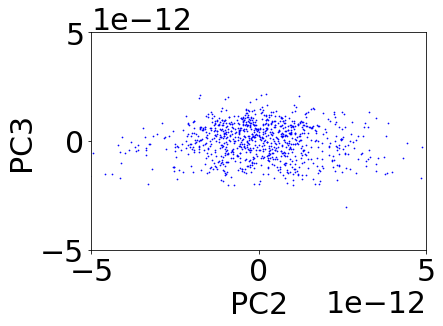

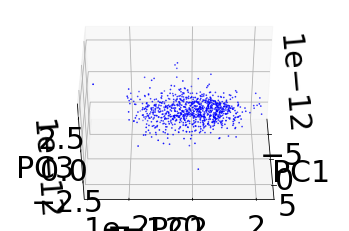

In [ ]:
    NC=6
    r1=0
    r2=2
    XXYY_2T,XXYY_4T,XXYY_6T=get_coordinates_within(r1,r2)
    # The next 2 lines need to be modifed for looking at the fixed cores:
    XXYY_2T_new,XXYY_4T_new,XXYY_6T_new=get_the_relevant_coord(XXYY_2T,XXYY_4T,XXYY_6T,r1,r2,switch)
    # XXYY=[XXYY_2T,XXYY_4T,XXYY_6T]
    [dIdV2_2T_flat,dIdV3_4T_flat,dIdV4_6T_flat],[dIdV1_2T_flat,dIdV1_4T_flat,dIdV1_6T_flat]=get_all_spectra(XXYY_2T_new,XXYY_4T_new,XXYY_6T_new)
    
    components2_2T,X_vectors_t2_2T,explained_2_2T=PCA_for_dIdV(dIdV2_2T_flat,NC)
    components3_4T,X_vectors_t3_4T,explained_3_4T=PCA_for_dIdV(dIdV3_4T_flat,NC)
    components4_6T,X_vectors_t4_6T,explained_4_6T=PCA_for_dIdV(dIdV4_6T_flat,NC)
    components1_2T,X_vectors_t1_2T,explained_1_2T=PCA_for_dIdV(dIdV1_2T_flat,NC)
    components1_4T,X_vectors_t1_4T,explained_1_4T=PCA_for_dIdV(dIdV1_4T_flat,NC)
    components1_6T,X_vectors_t1_6T,explained_1_6T=PCA_for_dIdV(dIdV1_6T_flat,NC)
    
    # X_kpca_2_2T=KPCA_for_dIdV(dIdV2_2T_flat)
    # X_kpca_3_4T=KPCA_for_dIdV(dIdV3_4T_flat)
    # X_kpca_4_6T=KPCA_for_dIdV(dIdV4_6T_flat)
    # X_kpca_1_2T=KPCA_for_dIdV(dIdV1_2T_flat)
    # X_kpca_1_4T=KPCA_for_dIdV(dIdV1_4T_flat)
    # X_kpca_1_6T=KPCA_for_dIdV(dIdV1_6T_flat)
    
    # print('shape of KPCA')
    # print(X_kpca_3_4T.shape)


    plt.scatter(X_vectors_t3_4T[:,0],X_vectors_t3_4T[:,1],s=0.5,c='blue')
    plt.xlabel('PC2')
    plt.ylabel('PC3')
    plt.xlim(-0.5e-11,0.5e-11)
    plt.ylim(-0.5e-11,0.5e-11)
    
    

    # plt.scatter(X_vectors_3_4T[:,0],X_vectors_3_4T[:,1],s=0.5)
    # plt.xlabel('PC2')
    # plt.ylabel('PC3')
    # plt.xlim(-0.5e-11,0.5e-11)
    # plt.ylim(-0.5e-11,0.5e-11)


from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt



fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

ax.scatter(X_vectors_t3_4T[:,0], X_vectors_t3_4T[:,1], X_vectors_t3_4T[:,2],s=0.5,c='blue')
ax.view_init(40, 0)

ax.set_xlabel('PC1')
ax.set_ylabel('PC2')
ax.set_zlabel('PC3')

plt.show()


# plt.plot(components2_2T[0])
# plt.plot(components2_2T[1])
# plt.plot(components2_2T[2])
# plt.plot(components3_4T[1])
# plt.plot(components3_4T[0])



In [ ]:
# # X_total_3_4T=X_vectors_t3_4T
# plt.scatter(X_vectors_t3_4T[:,1],X_vectors_t3_4T[:,2],s=0.5,c='blue')
# plt.scatter(X_total_3_4T[:,1],X_total_3_4T[:,2],s=0.5,c='red')
# plt.xlabel('PC2')
# plt.ylabel('PC3')
# plt.xlim(-0.5e-11,0.5e-11)
# plt.ylim(-0.5e-11,0.5e-11)

#K-means clustering

[0 1 1 1 0 1 1 0 1 1 1 1 1 1 1 1 1 0 0 1 1 1 1 1 1 0 1 0 1 1 0 0 1 1 1 1 1
 1 0 1 0 1 1 0 0 1 1 1 0 1 1 1 0 0 0 0 0 1 0 0 1 0 0 1 0 1 1 1 0 1 1 1 0 0
 1 1 1 1 1 1 0 0 1 1 0 1 0 1 0 0 0 0 0 1 1 0 1 0 0 1 0 1 1 0 1 0 0 1 0 0 1
 1 1 0 0 1 1 0 0 0 0 1 0 0 1 1 0 1 1 1 1 1 1 0 0 1 0 1 1 0 0 1 0 1 0 0 0 1
 0 0 0 1 0 0 0 0 1 0 0 1 0 0 1 1 1 0 1 1 1 1 0 0 1 1 0 1 0 1 0 0 1 1 1 1 1
 0 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 1 1 1 0 1 1 1 1 1
 1 1 0 1 1 1 0 1 0 0 1 0 1 1 1 1 0 1 1 1 1 1 1 1 1 0 1 0 1 0 1 0 1 1 0 0 0
 0 0 0 0 0 0 0 0 1 0 0 1 1 1 1 0 1 0 0 1 1 0 0 0 1 1 0 1 0 1 1 1 0 1 0 1 1
 1 1 1 1 0 0 1 0 1 0 0 0 0 0 0 1 1 1 1 1 0 1 1 1 1 1 1 0 1 1 1 0 1 1 1 1 1
 1 0 1 1 1 1 1 1 0 1 1 1 0 1 0 0 0 0 1 1 1 0 0 1 1 0 1 1 0 1 1 0 1 1 0 1 1
 0 0 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 1 1 0 0 1 1 0 0 1 0 1 1 0 1
 0 1 1 1 1 0 0 1 1 1 1 0 0 1 1 0 0 0 1 0 0 0 1 0 1 1 0 1 1 1 1 1 1 1 1 0 1
 1 1 1 1 1 1 0 0 1 1 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 0 0 1 0 0 0 0 0 0 1 1 1
 0 0 0 0 0 0 1 0 0 0 0 0 

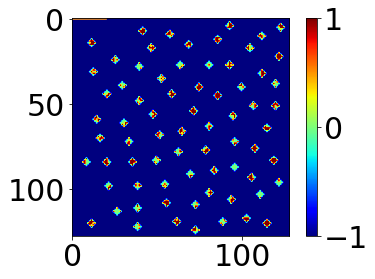

In [ ]:
from sklearn.cluster import SpectralClustering
from sklearn.cluster import KMeans
from sklearn import mixture


w,h=np.shape(dIdV3_4T_flat)
num_clusters=2
data_mat = dIdV3_4T_flat

kmeans = KMeans(n_clusters=num_clusters, random_state=0).fit(data_mat)

labels=kmeans.labels_

kmeans_mean_resp = kmeans.cluster_centers_

print(labels)
Kmeans3_4T=-1*np.ones((128,128))

print(labels.shape)
for num,(XX,YY) in enumerate(XXYY_4T_new):
             Kmeans3_4T[XX,YY]=labels[num]

plt.imshow(Kmeans3_4T)
plt.colorbar()
fig
plt.plot(kmeans_mean_resp[0])
plt.plot(kmeans_mean_resp[1])
#plt.plot(kmeans_mean_resp[2])

# plt.imshow(labels_kmeans)
# # plt.imshow(np.flipud(vortex_image_Gaussian))
# plt.colorbar()



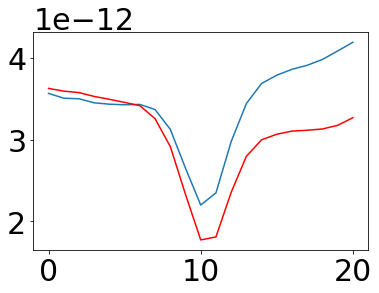

In [ ]:
plt.plot(kmeans_mean_resp[0])
plt.plot(kmeans_mean_resp[1],color='red')
#plt.plot(kmeans_mean_resp[2])

## PCA results

# Plots in PCA space

By changing the r_min and r_max and delta_r, we can specify the distance away from the vortex cores

Re-plot the PCA compoents map in real space

In [ ]:
import matplotlib.pyplot as plt
plt.style.use('classic')
import palettable.cubehelix

In [ ]:
from matplotlib.colors import LinearSegmentedColormap

def grayscale_cmap(cmap):
    """Return a grayscale version of the given colormap"""
    cmap = plt.cm.get_cmap(cmap)
    colors = cmap(np.arange(cmap.N))
    
    # convert RGBA to perceived grayscale luminance
    # cf. http://alienryderflex.com/hsp.html
    RGB_weight = [0.299, 0.587, 0.114]
    luminance = np.sqrt(np.dot(colors[:, :3] ** 2, RGB_weight))
    colors[:, :3] = luminance[:, np.newaxis]
        
    return LinearSegmentedColormap.from_list(cmap.name + "_gray", colors, cmap.N)
    

def view_colormap(cmap):
    """Plot a colormap with its grayscale equivalent"""
    cmap = plt.cm.get_cmap(cmap)
    colors = cmap(np.arange(cmap.N))
    
    cmap = grayscale_cmap(cmap)
    grayscale = cmap(np.arange(cmap.N))
    
    fig, ax = plt.subplots(2, figsize=(6, 2),
                           subplot_kw=dict(xticks=[], yticks=[]))
    ax[0].imshow([colors], extent=[0, 10, 0, 1])
    ax[1].imshow([grayscale], extent=[0, 10, 0, 1])

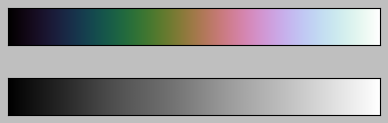

In [ ]:
from palettable.cubehelix import Cubehelix

#view_colormap('cubehelix')
view_colormap('cubehelix')

In [ ]:
# define number of PCA components as NC
NC=3
# define a grid of plots with 6 x NC
gs1 = gridspec.GridSpec(12, NC) 
fig1 = plt.figure(figsize = (100, 100)) 
colors=['blue','orange','green','red','purple','lavender','black']

# gs2= gridspec.GridSpec(1,1)
# fig2=plt.figure(figsize=(45,45))

r_min=0
r_max=4
delta_r=4
count=0


# calculate Principle components and coefficients from the selected areas (get_the_relevant_coord)
for i in np.arange(r_min,r_max,delta_r): 
    r1=i
    r2=r1+delta_r
    XXYY_2T,XXYY_4T,XXYY_6T=get_coordinates_within(r1,r2)
    # The next 2 lines need to be modifed for looking at the fixed cores:
    XXYY_2T_new,XXYY_4T_new,XXYY_6T_new=get_the_relevant_coord(XXYY_2T,XXYY_4T,XXYY_6T,r1,r2,switch)
    # XXYY=[XXYY_2T,XXYY_4T,XXYY_6T]
    [dIdV2_2T_flat,dIdV3_4T_flat,dIdV4_6T_flat],[dIdV1_2T_flat,dIdV1_4T_flat,dIdV1_6T_flat]=get_all_spectra(XXYY_2T_new,XXYY_4T_new,XXYY_6T_new)
    
    components2_2T,X_vectors_t2_2T,explained_2_2T=PCA_for_dIdV(dIdV2_2T_flat,NC)
    components3_4T,X_vectors_t3_4T,explained_3_4T=PCA_for_dIdV(dIdV3_4T_flat,NC)
    components4_6T,X_vectors_t4_6T,explained_4_6T=PCA_for_dIdV(dIdV4_6T_flat,NC)
    components1_2T,X_vectors_t1_2T,explained_1_2T=PCA_for_dIdV(dIdV1_2T_flat,NC)
    components1_4T,X_vectors_t1_4T,explained_1_4T=PCA_for_dIdV(dIdV1_4T_flat,NC)
    components1_6T,X_vectors_t1_6T,explained_1_6T=PCA_for_dIdV(dIdV1_6T_flat,NC)

components=[components2_2T,components3_4T,components4_6T,components1_2T,components1_4T,components1_6T]
explained=[explained_2_2T,explained_3_4T,explained_4_6T,explained_1_2T,explained_1_4T,explained_1_6T]

explained1=[explained_2_2T,explained_3_4T,explained_4_6T]
explained2=[explained_1_2T,explained_1_4T,explained_1_6T]

# weightmaps2_2T=-1e6*np.ones((128,128,NC))
# weightmaps3_4T=-1e6*np.ones((128,128,NC))
# weightmaps4_6T=-1e6*np.ones((128,128,NC))
# weightmaps1_2T=-1e6*np.ones((128,128,NC))
# weightmaps1_4T=-1e6*np.ones((128,128,NC))
# weightmaps1_6T=-1e6*np.ones((128,128,NC))

weightmaps2_2T=np.zeros((128,128,NC))
weightmaps3_4T=np.zeros((128,128,NC))
weightmaps4_6T=np.zeros((128,128,NC))
weightmaps1_2T=np.zeros((128,128,NC))
weightmaps1_4T=np.zeros((128,128,NC))
weightmaps1_6T=np.zeros((128,128,NC))


print(weightmaps2_2T[0,0,:])

# create PCA coefficient(weights) maps
for i in range(NC):
   for num,(XX,YY) in enumerate(XXYY_2T_new):
            weightmaps2_2T[XX,YY,i]=X_vectors_t2_2T[num,i]
            weightmaps1_2T[XX,YY,i]=X_vectors_t1_2T[num,i]
   
for i in range(NC):
   for num,(XX,YY) in enumerate(XXYY_4T_new):
            weightmaps3_4T[XX,YY,i]=X_vectors_t3_4T[num,i]
            weightmaps1_4T[XX,YY,i]=X_vectors_t1_4T[num,i]

for i in range(NC):
   for num,(XX,YY) in enumerate(XXYY_6T_new):
            weightmaps4_6T[XX,YY,i]=X_vectors_t4_6T[num,i]
            weightmaps1_6T[XX,YY,i]=X_vectors_t1_6T[num,i]


5components can explain0.9645472503594502of the behavior
middle is10
shape of the components is
(3, 21)
(1847, 3)
5components can explain0.9620641440628223of the behavior
middle is10
shape of the components is
(3, 21)
(3472, 3)
5components can explain0.9613250546360664of the behavior
middle is10
shape of the components is
(3, 21)
(4838, 3)
6components can explain0.9586867107188058of the behavior
middle is40
shape of the components is
(3, 81)
(1847, 3)
6components can explain0.9587283472107977of the behavior
middle is40
shape of the components is
(3, 81)
(3472, 3)
6components can explain0.9589900983988795of the behavior
middle is40
shape of the components is
(3, 81)
(4838, 3)
[0. 0. 0.]


<Figure size 8000x8000 with 0 Axes>

In [ ]:
labels=np.array(['(a)','(b)','(c)',
        '(d)','(e)','(f)',
        '(g)','(h)','(i)'])
labels=labels.reshape(3,3)
print(labels.shape)

(3, 3)


In [ ]:
np.array(XXYY)[:,1]

array([ 85,  82,  83, ..., 124, 125, 122])

In [ ]:
xy4_temp

array([[ 14,  11],
       [ 22, 121],
       [109,  72],
       [119,  88],
       [ 27,  63],
       [ 40,  99],
       [ 27,  80],
       [ 76, 107],
       [ 48,  39],
       [ 17, 104],
       [ 72,  33],
       [ 28,  39],
       [111,  38],
       [ 57,  94]])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:57: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


<Figure size 640x480 with 0 Axes>

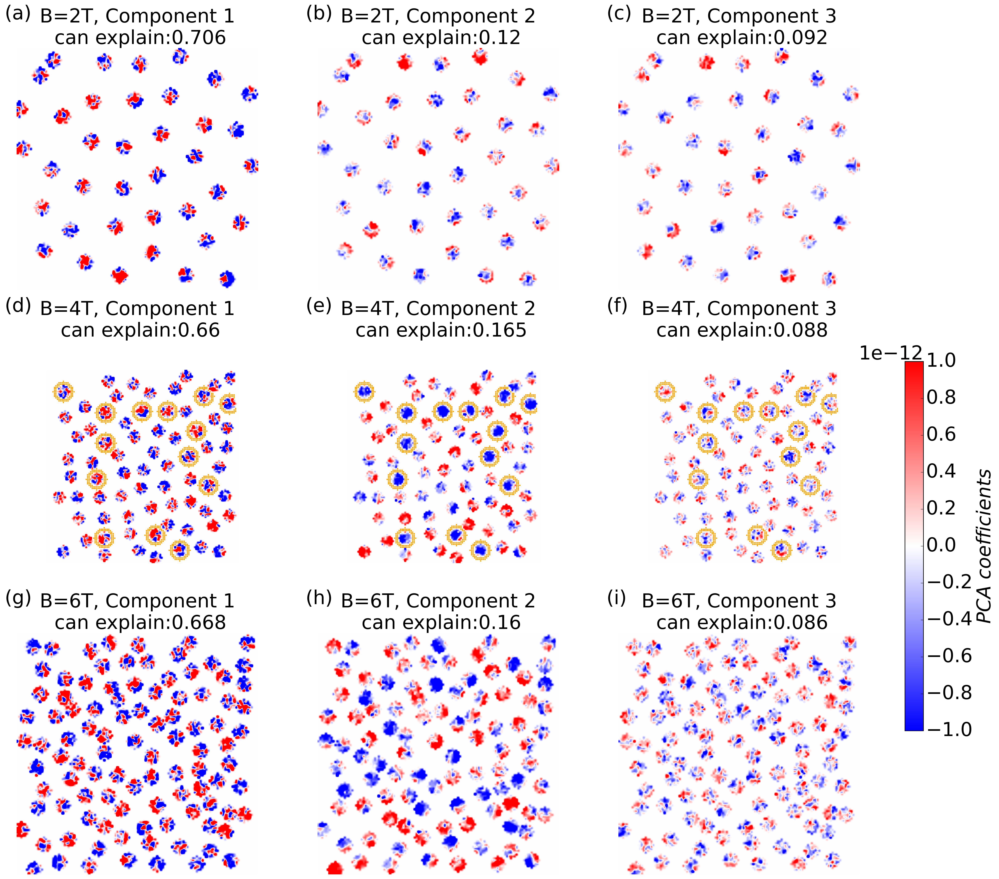

In [ ]:
weightmaps=[weightmaps2_2T,weightmaps3_4T,weightmaps4_6T,weightmaps1_2T,weightmaps1_4T,weightmaps1_6T]
weightmaps1=[weightmaps2_2T,weightmaps3_4T,weightmaps4_6T]
weightmaps2=[weightmaps1_2T,weightmaps1_4T,weightmaps1_6T]

fields=['2T','4T','6T','0T','0T','0T']

labels=np.array(['(a)','(b)','(c)',
        '(d)','(e)','(f)',
        '(g)','(h)','(i)'])
labels=labels.reshape(3,3)


plt.set_cmap('bwr')

gs1 = gridspec.GridSpec(3, NC) 
fig1 = plt.figure(figsize = (20, 20),dpi=300) 

for j, explain in enumerate(explained1):
  for i in range(3):
    ax2 = fig1.add_subplot(gs1[j,i],frame_on=True)
    ax2.axis('off')
    im=ax2.imshow(weightmaps1[j][:, : ,i],vmin=-1e-12,vmax=1e-12)
    if j==1:
       XXYY_2T,XXYY_4T,XXYY_6T=get_coordinates_within(r1=5,r2=7)
       XXYY_2T_new,XXYY_4T_new,XXYY_6T_new=get_the_relevant_coord(XXYY_2T,XXYY_4T,XXYY_6T,r1=5,r2=7,switch=1)
       XXYY=[XXYY_2T_new,XXYY_4T_new,XXYY_6T_new]
       ax2.scatter(np.array(XXYY_4T_new)[:,1],np.array(XXYY_4T_new)[:,0],marker='s',s=1,c='orange',edgecolors='face')
    ax2.set_title('B='+fields[j]+', Component ' + str(i+1)+'\n can explain:'+str(round(explain[i],3)))
    ax2.title.set_size('30')
    divider = make_axes_locatable(ax2)
    ax2 = divider.append_axes('right', size='10%', pad=0.0)
    #fig1.colorbar(im,cax=ax2, orientation='vertical')
    #ax2.ticklabel_format(scilimits=(0,0))
    
    fig1.patch.set_facecolor('white')
    ax2.axis('off')


    #add figure labels
    textstr=labels[j,i]
    props = dict(facecolor='white', alpha=0)
    ax2.text(-10.5,1.18, textstr, transform=ax2.transAxes, fontsize=30,
        verticalalignment='top',horizontalalignment='left', bbox=props)
# add colorbar
import matplotlib
matplotlib.rc('font', size=30)
fig1.subplots_adjust(right=0.8)
cbar_ax = fig1.add_axes([1.0, 0.2, 0.02, 0.4])
cbar1=fig1.colorbar(im, cax=cbar_ax)
cbar1.ax.tick_params(axis='both',labelsize=30)
cbar1.set_label('PCA coefficients',rotation=90)
text = cbar1.ax.yaxis.label
font = mpl.font_manager.FontProperties(family='times new roman', style='italic', size=30)
text.set_font_properties(font)

#plt.colorbar(im,cax=ax2, orientation='vertical')
plt.tight_layout()

plt.show()




# cbar1=fig1.colorbar(dummie_cax,ticks=c)
# cbar1.set_label('distance from the vortex centers \n in # of pixels',rotation=90)
# cbar1.ax.tick_params(axis='both',labelsize=30)
# text = cbar1.ax.yaxis.label
# font = mpl.font_manager.FontProperties(family='times new roman', style='italic', size=30)
# text.set_font_properties(font)

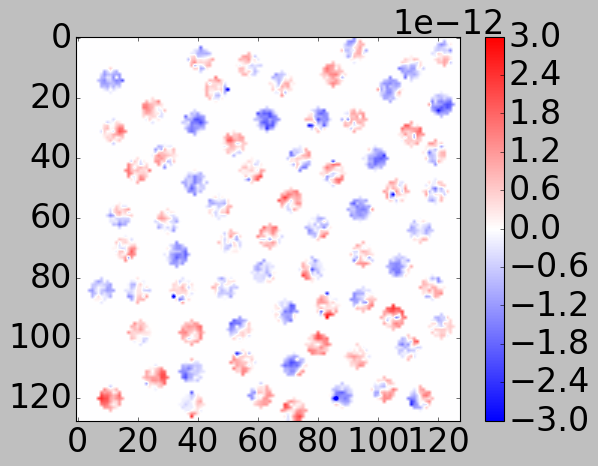

In [ ]:
plt.imshow(weightmaps1[1][:, : ,1],vmin=-3e-12,vmax=3e-12)
plt.colorbar()

In [ ]:
print(xy4)

[[ 12  85]
 [ 14  11]
 [  4  92]
 [ 32 111]
 [ 39  29]
 [ 93 105]
 [ 24  25]
 [ 31  12]
 [102  80]
 [ 44  20]
 [ 59  14]
 [113  26]
 [106  93]
 [ 35  52]
 [ 54  71]
 [120  11]
 [  7  41]
 [  9  57]
 [ 45  85]
 [ 98  38]
 [ 98  21]
 [ 89  83]
 [ 27  92]
 [ 38 119]
 [ 84  35]
 [119  61]
 [124  72]
 [ 66  64]
 [ 68  51]
 [ 87  95]
 [ 51 106]
 [ 17  46]
 [ 84   8]
 [ 40  74]
 [108  55]
 [ 72  95]
 [109  72]
 [ 27  80]
 [ 44  58]
 [ 15  68]
 [117 102]
 [ 70  16]
 [ 76 107]
 [ 84  20]
 [ 40  99]
 [ 61  30]
 [ 17 104]
 [120 114]
 [119  88]
 [ 96 121]
 [ 48  39]
 [ 91  69]
 [ 27  63]
 [111  38]
 [ 77  78]
 [ 83  49]
 [ 72  33]
 [ 78  62]
 [103 110]
 [ 97  54]
 [ 63  80]
 [ 56  47]
 [122  38]
 [ 83 118]
 [ 22 121]
 [ 10 111]
 [ 51 119]
 [ 28  39]
 [ 64 114]
 [ 57  94]
 [  5 122]]


In [ ]:
weight_sum=np.zeros((len(xy4[:,0])))
weight_sum.shape

(71,)

In [ ]:
xy4_temp

array([[ 14,  11],
       [ 22, 121],
       [109,  72],
       [119,  88],
       [ 27,  63],
       [ 40,  99],
       [ 27,  80],
       [ 76, 107],
       [ 48,  39],
       [ 17, 104],
       [ 72,  33],
       [ 28,  39],
       [111,  38],
       [ 57,  94]])

<Figure size 640x480 with 0 Axes>

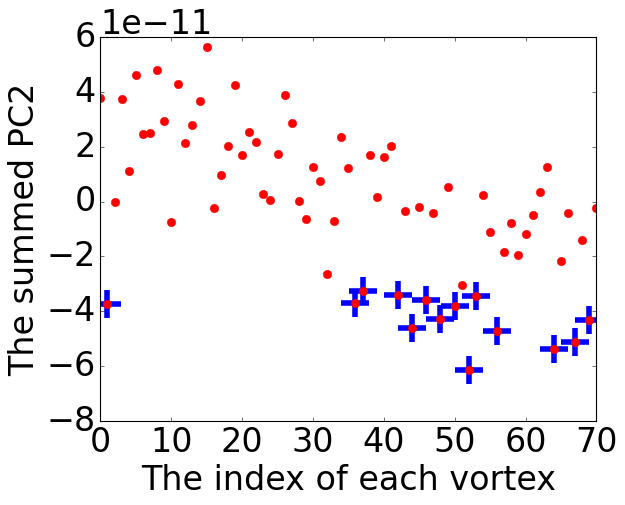

<Figure size 640x480 with 0 Axes>

In [ ]:
nth_vortex=range(len(xy4[:,0]))
weight_sum=np.zeros((len(xy4[:,0])))
pin_label=np.zeros((len(xy4[:,0])))
plt.figure(facecolor='white')    
for num, (i,j) in enumerate(xy4):
    weight_sum[num]=np.sum(weightmaps1[1][(i-5):(i+5), (j-5):(j+5),1])
    for (ii,jj) in xy4_temp:
      if ii==i and jj==j:
        pin_label[num]=1
        plt.plot(nth_vortex[num],weight_sum[num],'+',c='blue',markersize='25',markeredgewidth=5)
plt.plot(nth_vortex[:],weight_sum[:],'.',c='red',markersize='15')
plt.xlabel('The index of each vortex')
plt.ylabel('The summed PC2')
plt.figure(facecolor='white')    

In [ ]:
print(pin_label)

[0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 1. 0. 1. 0. 1. 0.
 1. 0. 1. 0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0.]


Text(0, 0.5, 'Number of vortices')

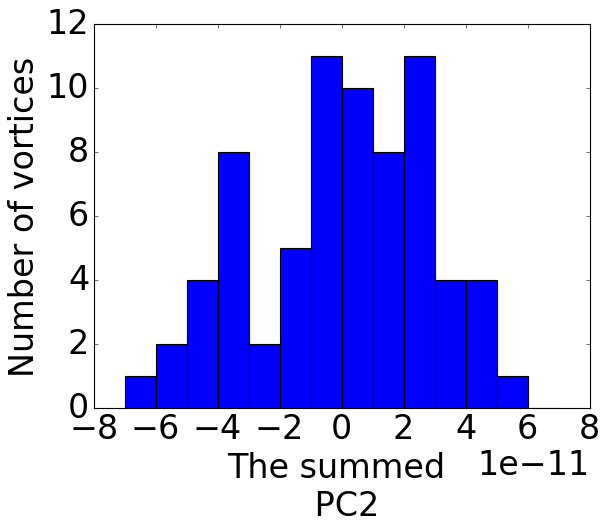

In [ ]:
plt.figure(facecolor='white')
plt.hist(weight_sum,bins=14,range=(-7e-11,7e-11))
plt.xlabel('The summed \n PC2')
plt.ylabel('Number of vortices')

In [ ]:
weight_sum

array([ 3.77189001e-11, -3.72488581e-11,  0.00000000e+00,  3.72275953e-11,
        1.12851074e-11,  4.59821564e-11,  2.47352972e-11,  2.48678978e-11,
        4.81505552e-11,  2.92953409e-11, -7.34126139e-12,  4.28754085e-11,
        2.13242987e-11,  2.79557211e-11,  3.65247095e-11,  5.62183796e-11,
       -2.39881039e-12,  9.76333076e-12,  2.02189045e-11,  4.23345939e-11,
        1.70504298e-11,  2.53098762e-11,  2.15557202e-11,  2.80158721e-12,
        6.85578008e-13,  1.74696963e-11,  3.87571518e-11,  2.86535971e-11,
        1.34534554e-13, -6.36321324e-12,  1.27687204e-11,  7.59488760e-12,
       -2.65500649e-11, -6.92938739e-12,  2.35621291e-11,  1.22431990e-11,
       -3.70754609e-11, -3.26903129e-11,  1.70060439e-11,  1.58066561e-12,
        1.62347346e-11,  2.03997676e-11, -3.41098034e-11, -3.43711972e-12,
       -4.60316623e-11, -1.84719578e-12, -3.58694520e-11, -4.23349622e-12,
       -4.29678681e-11,  5.46356319e-12, -3.82233478e-11, -3.02536133e-11,
       -6.15002425e-11, -

In [ ]:
weightmaps1[0].shape

(128, 128, 3)

3.7718900100768614e-11

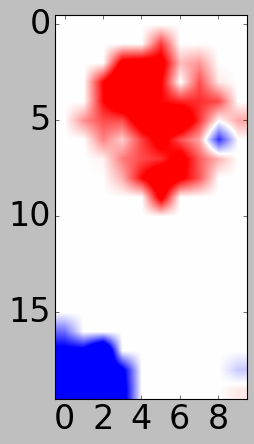

In [ ]:
plt.imshow(weightmaps1[1][(xy4[0,0]-5):(xy4[0,0]+15), (xy4[0,1]-5):(xy4[0,1]+5),1],vmin=-1e-12,vmax=1e-12,cmap='bwr')
np.sum(weightmaps1[1][(xy4[0,0]-5):(xy4[0,0]+5), (xy4[0,1]-5):(xy4[0,1]+5),1])

4.024262635682015e-11

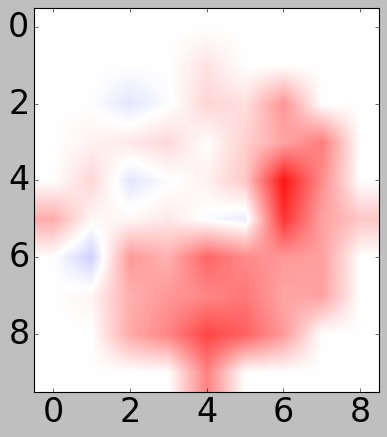

In [ ]:
plt.imshow(weightmaps1[2][52:62, 58:67 ,1],vmin=-3e-12,vmax=3e-12,cmap='bwr')
np.sum(weightmaps1[2][52:62, 58:67 ,1])

In [ ]:
dIdV3_new.shape

(128, 128, 21)

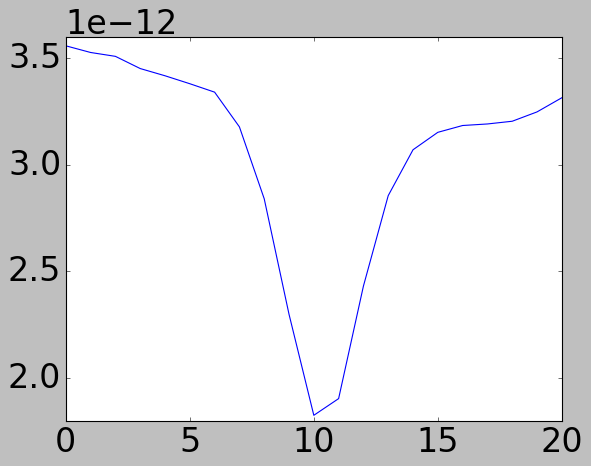

In [ ]:
dIdV3_new_flat=dIdV3_new.reshape(128*128,21)
dIdV3_new_mean=np.mean(dIdV3_new_flat,axis=0)
plt.plot(dIdV3_new_mean)

In [ ]:
components4_6T.shape

(3, 21)

In [ ]:
weightmaps4_6T.shape

(128, 128, 3)

In [ ]:
dIdV3_PCA_smoothed=np.zeros((128,128,21))
for row in range(128):
   for col in range(128):
      for i in range(NC):
          dIdV3_PCA_smoothed[row,col,:]=dIdV3_PCA_smoothed[row,col,:]+components4_6T[i,:]*weightmaps4_6T[row,col,i]+np.mean(dIdV4_6T_flat,axis=0)/NC

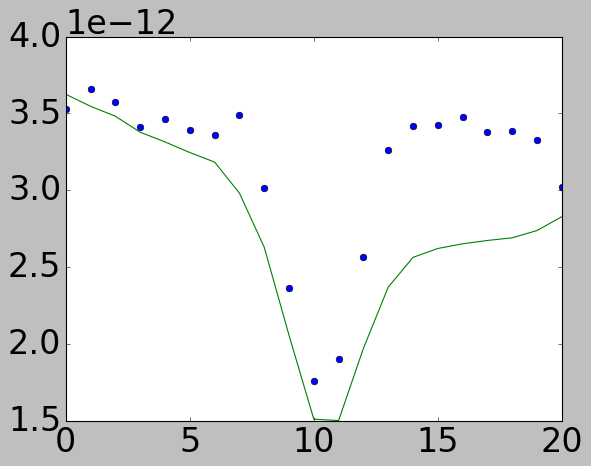

In [ ]:
plt.plot(dIdV3_new[57,62,:],marker='o',linestyle = 'None')
plt.plot(dIdV3_PCA_smoothed[57,62,:])

([], <a list of 0 Text major ticklabel objects>)

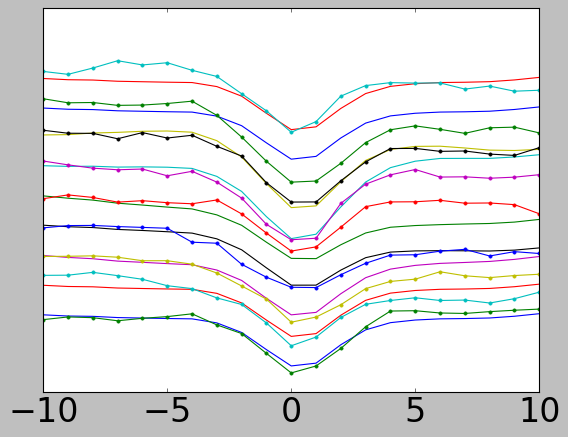

In [ ]:

dIdV3_PCA_smoothed.shape
for i in np.arange(-4,5):
  plt.plot(1000*energy_level_2T, dIdV3_PCA_smoothed[57+i, 62+i,:]+i*1e-12)
  plt.plot(1000*energy_level_2T, dIdV3_new[57+i, 62+i,:]+i*1e-12,marker='.')
  plt.ylim(-3e-12,10e-12)
plt.yticks([])


In [ ]:
font = {
        'weight': 'normal',
        'size': 30,
        }

Text(0.5, 1.0, 'dI/dV(a.u.)')

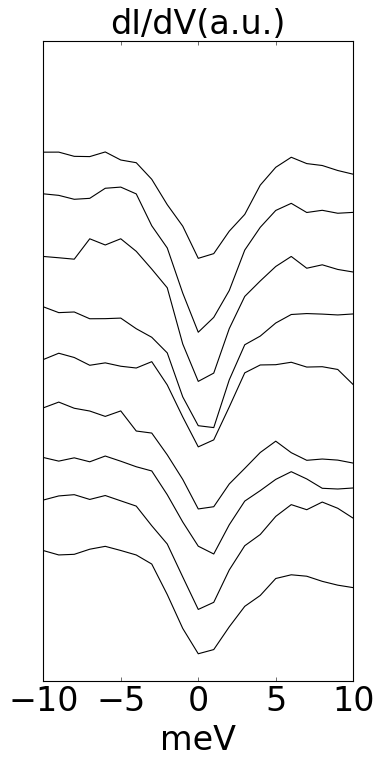

In [ ]:
fig, ax = plt.subplots(nrows=1, ncols=1,figsize=(5,10))

for i in np.arange(-4,5):
  plt.plot(1000*energy_level_2T, dIdV3_new[57+i, 62,:]+i*1e-12,c='black')
  plt.ylim(-3e-12,10e-12)
plt.xticks(size=30)
plt.yticks([])
plt.xlabel('meV',fontsize=30)
fig.patch.set_facecolor('white')
plt.title('dI/dV(a.u.)',fontdict=font)


(1.5e-12, 5e-12)

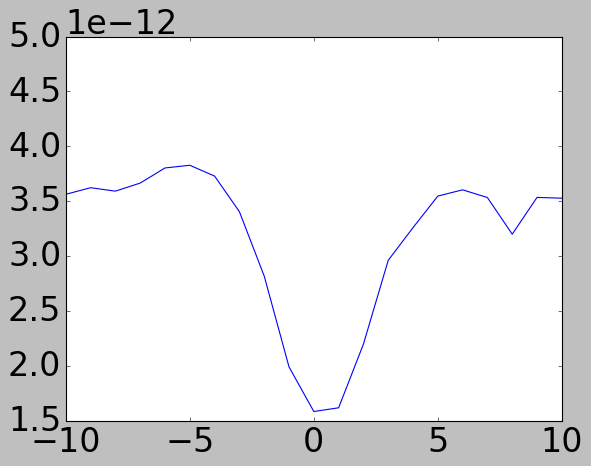

In [ ]:
dIdV3_new.shape
plt.plot(1000*energy_level_2T, dIdV3_new[57, 65,:])
plt.ylim(1.5e-12,5e-12)

In [ ]:
xy6

array([[ 11,  85],
       [ 91,  74],
       [ 90, 102],
       [  5,  49],
       [102,  46],
       [  7,   8],
       [ 57,   4],
       [ 32,  12],
       [ 69, 112],
       [ 36, 112],
       [ 82,  97],
       [ 40,  29],
       [ 19,  13],
       [103,  67],
       [ 55,  84],
       [ 24,  25],
       [122,  95],
       [ 85,  87],
       [101,  79],
       [  5,  91],
       [ 32,  98],
       [ 98,  38],
       [109,  27],
       [ 34,  25],
       [ 44,  20],
       [ 74,  84],
       [ 75,  53],
       [125,   9],
       [ 29,  50],
       [ 44,  82],
       [ 72,  96],
       [ 48, 106],
       [121,  22],
       [ 92,  11],
       [ 59,  13],
       [ 23, 109],
       [ 86,  36],
       [ 44,   5],
       [ 24,  80],
       [113,  86],
       [ 35,  53],
       [  9,  39],
       [ 59, 111],
       [115, 102],
       [ 34,  86],
       [122,  74],
       [ 95, 112],
       [ 41,  65],
       [ 86,  48],
       [108,  55],
       [ 83,  14],
       [ 76,  71],
       [  6,

In [ ]:
weightmaps1[2][55:65, : ,1]

array([[ 0.00000000e+00, -1.03898680e-12, -8.57364794e-13, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00, -8.12114433e-13, -5.83145456e-13, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [-6.04106929e-13, -8.97926914e-14, -3.95062100e-13, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       ...,
       [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00]])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:45: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


<Figure size 640x480 with 0 Axes>

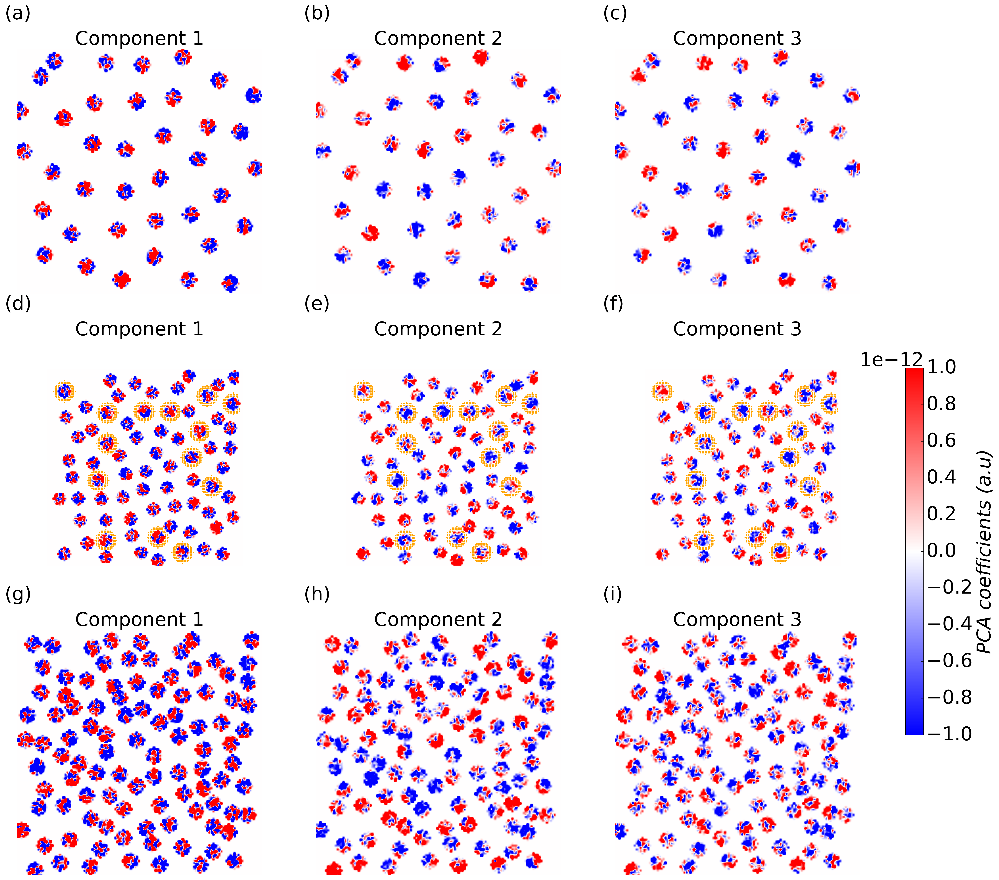

In [ ]:
plt.set_cmap('bwr')

gs1 = gridspec.GridSpec(3, NC) 
fig1 = plt.figure(figsize = (20, 20),dpi=300) 
for j, explain in enumerate(explained1):
  for i in range(NC):
    ax2 = fig1.add_subplot(gs1[j,i],frame_on=True)
    ax2.axis('off')
    im=ax2.imshow(weightmaps2[j][:, : ,i],vmin=-1e-12,vmax=1e-12)
    if j==1:
       XXYY_2T,XXYY_4T,XXYY_6T=get_coordinates_within(r1=5,r2=7)
       XXYY_2T_new,XXYY_4T_new,XXYY_6T_new=get_the_relevant_coord(XXYY_2T,XXYY_4T,XXYY_6T,r1=5,r2=7,switch=1)
       XXYY=[XXYY_2T_new,XXYY_4T_new,XXYY_6T_new]
       ax2.scatter(np.array(XXYY_4T_new)[:,1],np.array(XXYY_4T_new)[:,0],marker='s',s=1,c='orange',edgecolors='face')
    # ax2.set_title('Component ' + str(i+1)+'\n can explain:'+str(round(explain[i],3)))
    ax2.set_title('Component ' + str(i+1))
    ax2.title.set_size('30')
    divider = make_axes_locatable(ax2)
    ax2 = divider.append_axes('right', size='10%', pad=0.0)
    #fig1.colorbar(im,cax=ax2, orientation='vertical')
    #ax2.ticklabel_format(scilimits=(0,0))
    
    fig1.patch.set_facecolor('white')
    ax2.axis('off')


    #add figure labels
    textstr=labels[j,i]
    props = dict(facecolor='white', alpha=0)
    ax2.text(-10.5,1.18, textstr, transform=ax2.transAxes, fontsize=30,
        verticalalignment='top',horizontalalignment='left', bbox=props)
# add colorbar
import matplotlib
matplotlib.rc('font', size=30)
fig1.subplots_adjust(right=0.8)
cbar_ax = fig1.add_axes([1.0, 0.2, 0.02, 0.4])
cbar1=fig1.colorbar(im, cax=cbar_ax)
cbar1.ax.tick_params(axis='both',labelsize=30)
cbar1.set_label('PCA coefficients (a.u)',rotation=90)
text = cbar1.ax.yaxis.label
font = mpl.font_manager.FontProperties(family='times new roman', style='italic', size=30)
text.set_font_properties(font)

#plt.colorbar(im,cax=ax2, orientation='vertical')
plt.tight_layout()

plt.show()



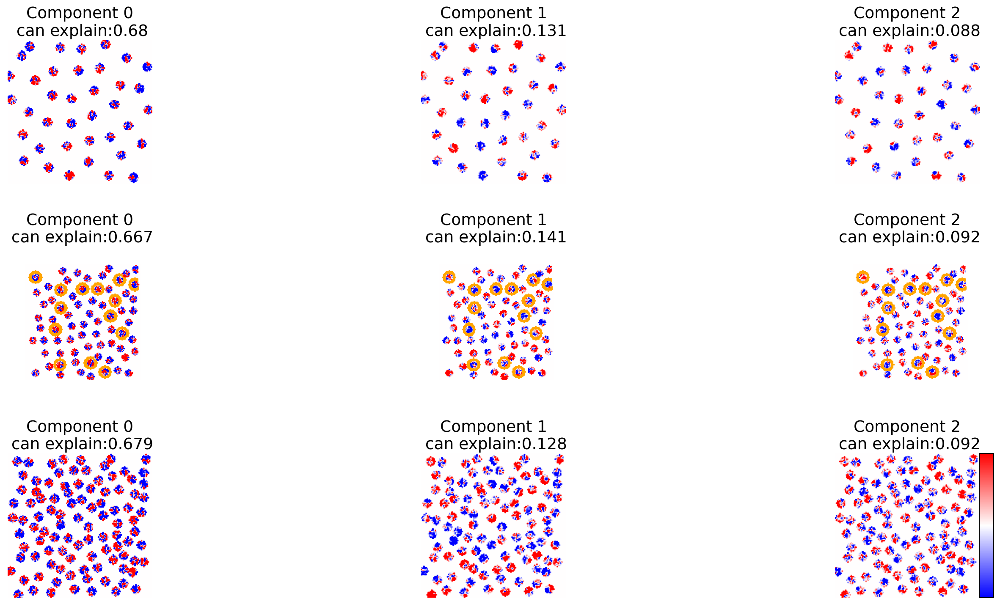

In [ ]:
gs1 = gridspec.GridSpec(6, NC) 
fig1 = plt.figure(figsize = (20, 20),dpi=150) 

for j, explain in enumerate(explained2):
  for i in range(NC):
    ax2 = fig1.add_subplot(gs1[j,i])
    ax2.axis('off')
    im=ax2.imshow(weightmaps2[j][:, : ,i],vmin=-1e-12,vmax=1e-12)
    if j==1:
       XXYY_2T,XXYY_4T,XXYY_6T=get_coordinates_within(r1=5,r2=7)
       XXYY_2T_new,XXYY_4T_new,XXYY_6T_new=get_the_relevant_coord(XXYY_2T,XXYY_4T,XXYY_6T,r1=5,r2=7,switch=1)
       XXYY=[XXYY_2T_new,XXYY_4T_new,XXYY_6T_new]
       ax2.scatter(np.array(XXYY_4T_new)[:,1],np.array(XXYY_4T_new)[:,0],marker='s',s=1,c='orange',edgecolors='face')
    #ax2.set_title('corresponds to B='+fields[j+3]+ ', Component ' + str(i)+' can explain:'+str(round(explain[i],3)))
    ax2.set_title('Component ' + str(i)+'\n can explain:'+str(round(explain[i],3)))
    ax2.title.set_size('18')
    divider = make_axes_locatable(ax2)
    ax2 = divider.append_axes('right', size='10%', pad=0.0)
    #fig1.colorbar(im,cax=ax2, orientation='vertical')
    #ax2.ticklabel_format(scilimits=(0,0))
    fig1.patch.set_facecolor('white')
    ax2.axis('off')
plt.colorbar(im,cax=ax2, orientation='vertical')
plt.tight_layout()
plt.show()

[Choosing colormap](https://matplotlib.org/3.1.0/tutorials/colors/colormaps.html)

NameError: ignored

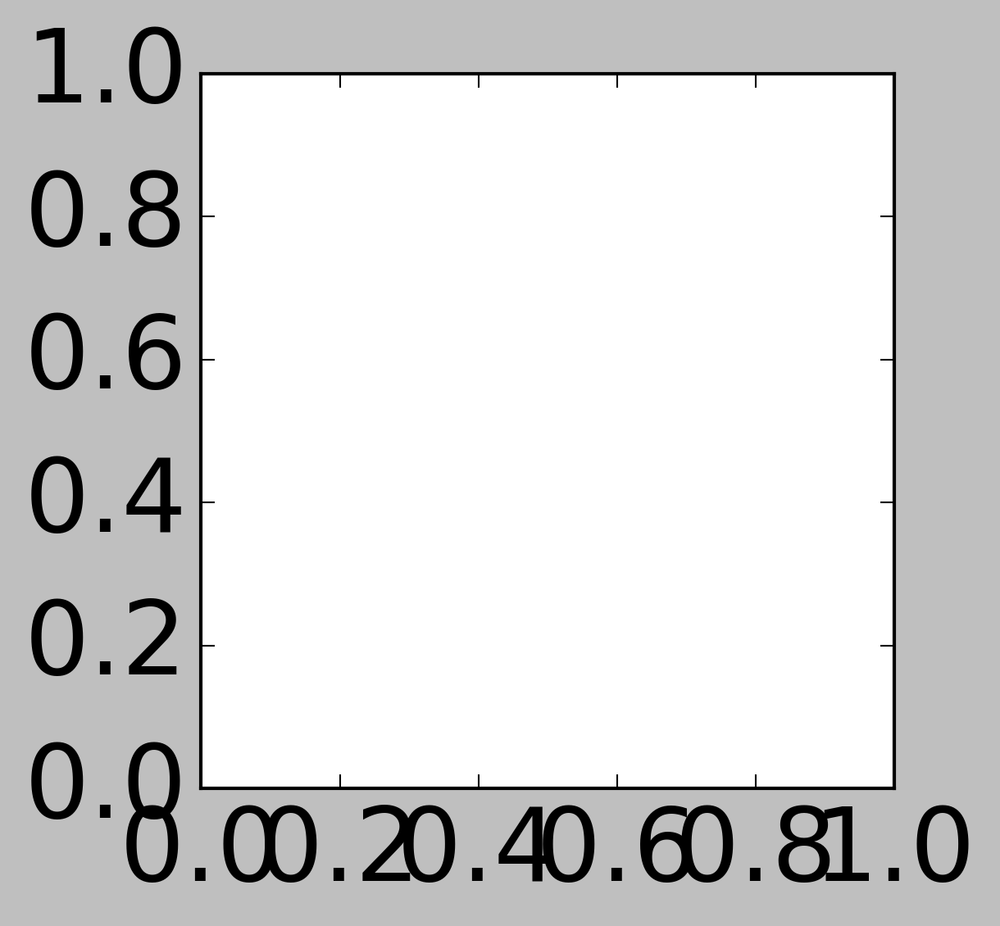

In [ ]:
fig=plt.figure(figsize=(8,8),dpi=300)
ax=fig.add_subplot(221)

image = topography_forward
ax.imshow(image)
scalebar = ScaleBar(scale_bar_512,'nm',location='lower left',box_alpha=0,color='w',length_fraction=0.5)
scalebar.font_properties.set_size('18')
scalebar.font_properties.set_weight('bold')
plt.gca().add_artist(scalebar)
ax.axis('off')
textstr='(a)'
props = dict(facecolor='white', alpha=0)
# place a text box in upper left in axes coords
ax.text(0, 1.08, textstr, transform=ax.transAxes, fontsize=18,
        verticalalignment='top', bbox=props)
ax.set_title('Topography')
ax.title.set_size('18')
ax.set_facecolor('NONE')

In [ ]:
plt.set_cmap('jet')

In [ ]:
# gs1 = gridspec.GridSpec(6, NC) 
# fig1 = plt.figure(figsize = (40, 40),dpi=300) 
# #fig=plt.figure(figsize=(8,8),dpi=300)

# #colors=['blue','orange','green','red','purple','lavender','black']
# plt.set_cmap('bwr')

# ####### Plots start from here #######

#    # B=2T dIdV2

#     # Weight map  
# for i in range(NC):
#     ax2 = fig1.add_subplot(gs1[0,i])
#     ax2.axis('off')
#     im=ax2.imshow(weightmaps2_2T[:, : ,i],vmin=-1e-12,vmax=1e-12)
#     ax2.set_title('B=2T, Component ' + str(i)+' can explain:'+str(round(explained_2_2T[i],3)))
#     ax2.title.set_size('18')
#     divider = make_axes_locatable(ax2)
#     ax2 = divider.append_axes('right', size='10%', pad=0.0)
#     fig1.colorbar(im,cax=ax2, orientation='vertical')
#     #ax2.ticklabel_format(scilimits=(0,0))
#     #fig1.patch.set_facecolor('black')
#     ax2.axis('off')
    


#    # B=4T dIdV3
# #plt.rc('font',size=18)
# #plt.axis('off')


#    # Weight map of PCA  
# for i in range(NC):
#     ax4 = fig1.add_subplot(gs1[1,i])
#     im=ax4.imshow(weightmaps3_4T[:, : ,i],vmin=-1e-12,vmax=1e-12)
#     ax4.set_title('B=4T Component ' + str(i)+' can explain:'+str(round(explained_3_4T[i],3)))
#     ax4.title.set_size('18')
#     #divider = make_axes_locatable(ax4)
#     #ax4 = divider.append_axes('right', size='10%', pad=0.05)
#     #fig1.colorbar(im,cax=ax4, orientation='vertical')
#     #ax4.ticklabel_format(scilimits=(0,0))
#     #fig1.patch.set_facecolor('white')
#     ax4.axis('off')
#     # B=6T dIdV4

#    # weight map
# for i in range(NC):
#     ax6 = fig1.add_subplot(gs1[2,i])
#     im=ax6.imshow(weightmaps4_6T[:, : ,i],vmin=-1e-12,vmax=1e-12)
#     ax6.set_title('B=6T Component ' + str(i)+' can explain:'+str(round(explained_4_6T[i],3)))
#     ax6.title.set_size('18')
#     #divider = make_axes_locatable(ax6)
#     #ax6 = divider.append_axes('right', size='10%', pad=0.05)
#     #fig1.colorbar(im,cax=ax6, orientation='vertical')
#     #ax6.ticklabel_format(scilimits=(0,0))
#     #fig1.patch.set_facecolor('white')
#     ax6.axis('off')

#     # B=2T dIdV1

#     # weight map
# for i in range(NC):
#     ax8 = fig1.add_subplot(gs1[3,i])
#     im=ax8.imshow(weightmaps1_2T[:, : ,i],vmin=-1e-12,vmax=1e-12)
#     ax8.set_title('B=0T(for the 2T vortex image), Component ' + str(i)+' can explain:'+str(round(explained_1_2T[i],3)))
#     ax8.axis('off')
#     ax8.title.set_size('18')
#     #divider = make_axes_locatable(ax8)
#     #ax8 = divider.append_axes('right', size='10%', pad=0.05)
#     #fig1.colorbar(im,cax=ax8, orientation='vertical')
#     #ax8.ticklabel_format(scilimits=(0,0))
#     #fig1.patch.set_facecolor('white')
#    # B=4T dIdV1

      
#      # weight map
# for i in range(NC):
#     ax10 = fig1.add_subplot(gs1[4,i])
#     im=ax10.imshow(weightmaps1_4T[:, : ,i],vmin=-1e-12,vmax=1e-12)
#     ax10.set_title('B=0T(for the 4T vortex image), Component ' + str(i)+' can explain:'+str(round(explained_1_4T[i],3)))
#     ax10.axis('off')
#     ax10.title.set_size('18')
#     #divider = make_axes_locatable(ax10)
#     #ax10 = divider.append_axes('right', size='10%', pad=0.05)
#     #fig1.colorbar(im,cax=ax10, orientation='vertical')
#     #ax10.ticklabel_format(scilimits=(0,0))
#     #fig1.patch.set_facecolor('white')
#      # B=6T dIdV1
    
#          # weight map
# for i in range(NC):
#     ax12 = fig1.add_subplot(gs1[5,i])
#     im=ax12.imshow(weightmaps1_6T[:, : ,i],vmin=-1e-12,vmax=1e-12)
#     ax12.set_title('B=0T(for the 6T vortex image), Component ' + str(i)+' can explain:'+str(round(explained_1_6T[i],3)))
#     ax12.axis('off')
#     ax12.title.set_size('18')
#     #divider = make_axes_locatable(ax12)
#     #ax12 = divider.append_axes('right', size='10%', pad=0.05)
#     #fig1.colorbar(im,cax=ax12, orientation='vertical')
#     #ax12.ticklabel_format(scilimits=(0,0))

# plt.tight_layout()
# plt.show()
    #fig1.patch.set_facecolor('white')

# fig1.colorbar(im,cax=ax2, orientation='vertical')

In [ ]:
font = {
        'weight': 'normal',
        'size': 30,
        }

In [ ]:
NC=3

components2_2T,


gs3 = gridspec.GridSpec(NC, 1) 
fig3 = plt.figure(figsize = (8, 24))
fig3.set_facecolor('white')


for i in range(NC):
    ax3 = fig3.add_subplot(gs3[i,0])     
    ax3.plot(1000*energy_level_2T, components3_4T[i],label=str(r1)+'<=r<='+str(r2))
    #ax3.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
    plt.ylim(-6e-1,6e-1)
    # ax3.set_title('B=6T Component ' + str(i + 1)+'\n  can explain:'+str(round(explained_4_6T[i],3)))
    ax3.set_title('Component '+str(i+1),fontdict=font)
    ax3.set_xlabel("Energy (meV)", fontsize=30)
    ax3.tick_params(axis='both',labelsize=30)
    #ax3.ticklabel_format(scilimits=(0,0))
    plt.tight_layout(pad=1.08, h_pad=1, w_pad=1, rect=None)

In [ ]:
NC=3

components2_2T,


gs3 = gridspec.GridSpec(1, NC) 
fig3 = plt.figure(figsize = (30, 10))
fig3.set_facecolor('white')


for i in range(NC):
    ax3 = fig3.add_subplot(gs3[0,i])     
    ax3.plot(1000*energy_level_2T, components4_6T[i],label=str(r1)+'<=r<='+str(r2))
    #ax3.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
    plt.ylim(-6e-1,6e-1)
    ax3.set_title('B=6T Component ' + str(i + 1)+'\n  can explain:'+str(round(explained_4_6T[i],3)))
    ax3.set_xlabel("meV", fontsize=30)
    #ax3.ticklabel_format(scilimits=(0,0))
    plt.tight_layout(pad=1.08, h_pad=1, w_pad=1, rect=None)

In [ ]:
gs1 = gridspec.GridSpec(6, NC) 
fig1 = plt.figure(figsize = (40, 60))
fig1.set_facecolor('white') 
colors=['blue','orange','green','red','purple','lavender','black']

  # B=2T dIdV2
    # PCA components
for i in range(NC):
    ax1 = fig1.add_subplot(gs1[0,i])     
    ax1.plot(1000*energy_level_2T, components2_2T[i],label=str(r1)+'<=r<='+str(r2))
    #ax1.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
    plt.ylim(-6e-1,6e-1)
    ax1.set_title('B=2T, Component ' + str(i + 1)+' can explain:'+str(round(explained_2_2T[i],3)))
    ax1.set_xlabel("meV", fontsize=10)
    ax1.ticklabel_format(scilimits=(0,0))
    plt.tight_layout(pad=1.08, h_pad=1, w_pad=1, rect=None)

   # B=4T dIdV3
    # PCA components
for i in range(NC):
    ax3 = fig1.add_subplot(gs1[1,i])     
    ax3.plot(1000*energy_level_2T, components3_4T[i],label=str(r1)+'<=r<='+str(r2))
    #ax3.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
    plt.ylim(-6e-1,6e-1)
    ax3.set_title('B=4T Component ' + str(i + 1)+'\n  can explain:'+str(round(explained_3_4T[i],3)))
    ax3.set_xlabel("meV", fontsize=18)
    

    ax3.ticklabel_format(scilimits=(0,0))
    plt.tight_layout(pad=1.08, h_pad=1, w_pad=1, rect=None)

    # B=6T dIdV4
       # PCA components
for i in range(NC):
    ax5 = fig1.add_subplot(gs1[2,i])     
    ax5.plot(1000*energy_level_2T, components4_6T[i],label=str(r1)+'<=r<='+str(r2))
    #ax5.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)        plt.ylim(-5e-1,5e-1)
    ax5.set_title('B=6T Component ' + str(i + 1)+' can explain:'+str(round(explained_4_6T[i],3)))
    ax5.set_xlabel("meV", fontsize=18)
    ax5.ticklabel_format(scilimits=(0,0))
    plt.tight_layout(pad=1.08, h_pad=1, w_pad=1, rect=None)
     # B=2T dIdV1
     # PCA components

for i in range(NC):
    ax7 = fig1.add_subplot(gs1[3,i])     
    ax7.plot(energy_level_0T, components1_2T[i],label=str(r1)+'<=r<='+str(r2))
    #ax7.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
    plt.ylim(-6e-1,6e-1)
    ax7.set_title('B=0T (for the 2T vortex image), Component ' + str(i + 1)+' can explain:'+str(round(explained_1_2T[i],3)))
    ax7.set_xlabel("eV", fontsize=10)
    ax7.ticklabel_format(scilimits=(0,0))

       # B=4T dIdV1
       # PCA components

for i in range(NC):
    ax9 = fig1.add_subplot(gs1[4,i])     
    ax9.plot(energy_level_0T, components1_4T[i],label=str(r1)+'<=r<='+str(r2))
    #ax9.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.05)
    plt.ylim(-6e-1,6e-1)
    ax9.set_title('B=0T(for the 4T vortex image), Component ' + str(i + 1)+' can explain:'+str(round(explained_1_4T[i],3)))
    ax9.set_xlabel("eV", fontsize=10)
    ax9.ticklabel_format(scilimits=(0,0))

     # B=6T dIdV1
       # PCA components

for i in range(NC):
    ax11 = fig1.add_subplot(gs1[5,i])     
    ax11.plot(energy_level_0T, components1_6T[i],label=str(r1)+'<=r<='+str(r2))
    #ax11.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.05)
    plt.ylim(-6e-1,6e-1)
    ax11.set_title('B=0T(for the 6T vortex image) Component ' + str(i + 1)+' can explain:'+str(round(explained_1_6T[i],3)))
    ax11.set_xlabel("eV", fontsize=10)
    ax11.ticklabel_format(scilimits=(0,0))


In [ ]:
print(X_vectors_t3_4T)

In [ ]:
# define number of PCA components as NC
NC=3
# define a grid of plots with 6 x NC
gs1 = gridspec.GridSpec(12, NC) 
fig1 = plt.figure(figsize = (100, 100)) 
colors=['blue','orange','green','red','purple','lavender','black']

# gs2= gridspec.GridSpec(1,1)
# fig2=plt.figure(figsize=(45,45))

r_min=0
r_max=4
delta_r=4
count=0

weightmaps2_2T=-1e6*np.ones((128,128,NC))
weightmaps3_4T=-1e6*np.ones((128,128,NC))
weightmaps4_6T=-1e6*np.ones((128,128,NC))
weightmaps1_2T=-1e6*np.ones((128,128,NC))
weightmaps1_4T=-1e6*np.ones((128,128,NC))
weightmaps1_6T=-1e6*np.ones((128,128,NC))

for i in np.arange(r_min,r_max,delta_r): 
    r1=i
    r2=r1+delta_r
    XXYY_2T,XXYY_4T,XXYY_6T=get_coordinates_within(r1,r2)
    # The next 2 lines need to be modifed for looking at the fixed cores:
    XXYY_2T_new,XXYY_4T_new,XXYY_6T_new=get_the_relevant_coord(XXYY_2T,XXYY_4T,XXYY_6T,r1,r2,switch)
    # XXYY=[XXYY_2T,XXYY_4T,XXYY_6T]
    [dIdV2_2T_flat,dIdV3_4T_flat,dIdV4_6T_flat],[dIdV1_2T_flat,dIdV1_4T_flat,dIdV1_6T_flat]=get_all_spectra(XXYY_2T_new,XXYY_4T_new,XXYY_6T_new)
    
    components2_2T,X_vectors_t2_2T,explained_2_2T=PCA_for_dIdV(dIdV2_2T_flat,NC)
    components3_4T,X_vectors_t3_4T,explained_3_4T=PCA_for_dIdV(dIdV3_4T_flat,NC)
    components4_6T,X_vectors_t4_6T,explained_4_6T=PCA_for_dIdV(dIdV4_6T_flat,NC)
    components1_2T,X_vectors_t1_2T,explained_1_2T=PCA_for_dIdV(dIdV1_2T_flat,NC)
    components1_4T,X_vectors_t1_4T,explained_1_4T=PCA_for_dIdV(dIdV1_4T_flat,NC)
    components1_6T,X_vectors_t1_6T,explained_1_6T=PCA_for_dIdV(dIdV1_6T_flat,NC)
   
   # The "enumerate()" need to be modifed for looking at the fixed cores:
    for i in range(NC):
       for num,(XX,YY) in enumerate(XXYY_2T_new):
            weightmaps2_2T[XX,YY,i]=X_vectors_t2_2T[num,i]
            weightmaps1_2T[XX,YY,i]=X_vectors_t1_2T[num,i]
   # The "enumerate()" need to be modifed for looking at the fixed cores: 
    for i in range(NC):
       for num,(XX,YY) in enumerate(XXYY_4T_new):
            weightmaps3_4T[XX,YY,i]=X_vectors_t3_4T[num,i]
            weightmaps1_4T[XX,YY,i]=X_vectors_t1_4T[num,i]

    for i in range(NC):
       for num,(XX,YY) in enumerate(XXYY_6T_new):
            weightmaps4_6T[XX,YY,i]=X_vectors_t4_6T[num,i]
            weightmaps1_6T[XX,YY,i]=X_vectors_t1_6T[num,i]





####### Plots start from here #######

   # B=2T dIdV2
    # PCA components
    for i in range(NC):
        ax1 = fig1.add_subplot(gs1[0,i])     
        ax1.plot(energy_level_2T, components2_2T[i],label=str(r1)+'<=r<='+str(r2))
        ax1.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
        plt.ylim(-5e-1,5e-1)
        ax1.set_title('B=2T, Component ' + str(i + 1)+' can explain:'+str(round(explained_2_2T[i],3)))
        ax1.set_xlabel("eV", fontsize=10)
        ax1.ticklabel_format(scilimits=(0,0))
    plt.tight_layout(pad=1.08, h_pad=1, w_pad=1, rect=None)
    # Weight map  
    for i in range(NC):
        ax2 = fig1.add_subplot(gs1[1,i])
        im=ax2.imshow(weightmaps2_2T[:, : ,i],vmin=-1e-12,vmax=1e-12)
        ax2.set_title('B=2T, Component ' + str(i + 1)+' can explain:'+str(round(explained_2_2T[i],3)))
        divider = make_axes_locatable(ax2)
        ax2 = divider.append_axes('right', size='10%', pad=0.05)
        fig1.colorbar(im,cax=ax2, orientation='vertical')
        ax2.ticklabel_format(scilimits=(0,0))
   # B=4T dIdV3
    # PCA components
    for i in range(NC):
        ax3 = fig1.add_subplot(gs1[2,i])     
        ax3.plot(energy_level_2T, components3_4T[i],label=str(r1)+'<=r<='+str(r2))
        ax3.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
        plt.ylim(-5e-1,5e-1)
        ax3.set_title('B=4T Component ' + str(i + 1)+' can explain:'+str(round(explained_3_4T[i],3)))
        ax3.set_xlabel("eV", fontsize=10)
        ax3.ticklabel_format(scilimits=(0,0))
   # Weight map of PCA  
    for i in range(NC):
        ax4 = fig1.add_subplot(gs1[3,i])
        im=ax4.imshow(weightmaps3_4T[:, : ,i],vmin=-1e-12,vmax=1e-12)
        ax4.set_title('B=4T Component ' + str(i + 1)+' can explain:'+str(round(explained_3_4T[i],3)))
        divider = make_axes_locatable(ax4)
        ax4 = divider.append_axes('right', size='10%', pad=0.05)
        fig1.colorbar(im,cax=ax4, orientation='vertical')
        ax4.ticklabel_format(scilimits=(0,0))
    
    # B=6T dIdV4
       # PCA components
    for i in range(NC):
        ax5 = fig1.add_subplot(gs1[4,i])     
        ax5.plot(energy_level_2T, components4_6T[i],label=str(r1)+'<=r<='+str(r2))
        ax5.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
        plt.ylim(-5e-1,5e-1)
        ax5.set_title('B=6T Component ' + str(i + 1)+' can explain:'+str(round(explained_4_6T[i],3)))
        ax5.set_xlabel("eV", fontsize=10)
        ax5.ticklabel_format(scilimits=(0,0))
       # weight map
    for i in range(NC):
        ax6 = fig1.add_subplot(gs1[5,i])
        im=ax6.imshow(weightmaps4_6T[:, : ,i],vmin=-1e-12,vmax=1e-12)
        ax6.set_title('B=6T Component ' + str(i + 1)+' can explain:'+str(round(explained_4_6T[i],3)))
        divider = make_axes_locatable(ax6)
        ax6 = divider.append_axes('right', size='10%', pad=0.05)
        fig1.colorbar(im,cax=ax6, orientation='vertical')
        ax6.ticklabel_format(scilimits=(0,0))

    # B=2T dIdV1
       # PCA components

    for i in range(NC):
        ax7 = fig1.add_subplot(gs1[6,i])     
        ax7.plot(energy_level_0T, components1_2T[i],label=str(r1)+'<=r<='+str(r2))
        #ax7.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
        plt.ylim(-5e-1,5e-1)
        ax7.set_title('B=0T (for the 2T vortex image), Component ' + str(i + 1)+' can explain:'+str(round(explained_1_2T[i],3)))
        ax7.set_xlabel("eV", fontsize=10)
        ax7.ticklabel_format(scilimits=(0,0))
      # weight map
    for i in range(NC):
        ax8 = fig1.add_subplot(gs1[7,i])
        im=ax8.imshow(weightmaps1_2T[:, : ,i],vmin=-1e-12,vmax=1e-12)
        ax8.set_title('B=0T(for the 2T vortex image), Component ' + str(i + 1)+' can explain:'+str(round(explained_1_2T[i],3)))
        divider = make_axes_locatable(ax8)
        ax8 = divider.append_axes('right', size='10%', pad=0.05)
        fig1.colorbar(im,cax=ax8, orientation='vertical')
        ax8.ticklabel_format(scilimits=(0,0))

   # B=4T dIdV1
       # PCA components

    for i in range(NC):
        ax9 = fig1.add_subplot(gs1[8,i])     
        ax9.plot(energy_level_0T, components1_4T[i],label=str(r1)+'<=r<='+str(r2))
        #ax9.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.05)
        plt.ylim(-5e-1,5e-1)
        ax9.set_title('B=0T(for the 4T vortex image), Component ' + str(i + 1)+' can explain:'+str(round(explained_1_4T[i],3)))
        ax9.set_xlabel("eV", fontsize=10)
        ax9.ticklabel_format(scilimits=(0,0))
      
     # weight map
    for i in range(NC):
        ax10 = fig1.add_subplot(gs1[9,i])
        im=ax10.imshow(weightmaps1_4T[:, : ,i],vmin=-1e-12,vmax=1e-12)
        ax10.set_title('B=0T(for the 4T vortex image), Component ' + str(i + 1)+' can explain:'+str(round(explained_1_4T[i],3)))
        divider = make_axes_locatable(ax10)
        ax10 = divider.append_axes('right', size='10%', pad=0.05)
        fig1.colorbar(im,cax=ax10, orientation='vertical')
        ax10.ticklabel_format(scilimits=(0,0))

     # B=6T dIdV1
       # PCA components

    for i in range(NC):
        ax11 = fig1.add_subplot(gs1[10,i])     
        ax11.plot(energy_level_0T, components1_6T[i],label=str(r1)+'<=r<='+str(r2))
        #ax11.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.05)
        plt.ylim(-5e-1,5e-1)
        ax11.set_title('B=0T(for the 6T vortex image) Component ' + str(i + 1)+' can explain:'+str(round(explained_1_6T[i],3)))
        ax11.set_xlabel("eV", fontsize=10)
        ax11.ticklabel_format(scilimits=(0,0))

    
         # weight map
    for i in range(NC):
        ax12 = fig1.add_subplot(gs1[11,i])
        im=ax12.imshow(weightmaps1_6T[:, : ,i],vmin=-1e-12,vmax=1e-12)
        ax12.set_title('B=0T(for the 6T vortex image), Component ' + str(i + 1)+' can explain:'+str(round(explained_1_6T[i],3)))
        divider = make_axes_locatable(ax12)
        ax12 = divider.append_axes('right', size='10%', pad=0.05)
        fig1.colorbar(im,cax=ax12, orientation='vertical')
        ax12.ticklabel_format(scilimits=(0,0))


    count=count+1 

# Try to label part of the data points in PCA space with different colors

Phenomena A (switch=1) and B (switch=2)


In [ ]:
# define number of PCA components as NC
NC=6
r1=0
r2=4
r_max=4 # the size of the vortices

XXYY_2T,XXYY_4T,XXYY_6T=get_coordinates_within(r1,r2)
# The next 2 lines need to be modifed for looking at the fixed cores:
XXYY_2T_new,XXYY_4T_new,XXYY_6T_new=get_the_relevant_coord(XXYY_2T,XXYY_4T,XXYY_6T,r1,r2,switch)
# XXYY=[XXYY_2T,XXYY_4T,XXYY_6T]
[dIdV2_2T_flat,dIdV3_4T_flat,dIdV4_6T_flat],[dIdV1_2T_flat,dIdV1_4T_flat,dIdV1_6T_flat]=get_all_spectra(XXYY_2T_new,XXYY_4T_new,XXYY_6T_new)
    
components2_2T,X_vectors_t2_2T,explained_2_2T=PCA_for_dIdV(dIdV2_2T_flat,NC)
components3_4T,X_vectors_t3_4T,explained_3_4T=PCA_for_dIdV(dIdV3_4T_flat,NC)
components4_6T,X_vectors_t4_6T,explained_4_6T=PCA_for_dIdV(dIdV4_6T_flat,NC)
components1_2T,X_vectors_t1_2T,explained_1_2T=PCA_for_dIdV(dIdV1_2T_flat,NC)
components1_4T,X_vectors_t1_4T,explained_1_4T=PCA_for_dIdV(dIdV1_4T_flat,NC)
components1_6T,X_vectors_t1_6T,explained_1_6T=PCA_for_dIdV(dIdV1_6T_flat,NC)

X_vector_str_pin=np.array([[0,0,0,0,0,0]])
X_vector_unpin=np.array([[0,0,0,0,0,0]])
   # The "enumerate()" need to be modifed for looking at the fixed cores: 
   #for i in range(NC):


for num,(XX,YY) in enumerate(XXYY_4T_new):
    for (X,Y) in xy4_temp3:
      if (X-XX)**2+(Y-YY)**2<=r_max**2:
          X_vector_str_pin=np.append(X_vector_str_pin,[X_vectors_t3_4T[num,:]],axis=0)
      if (X-XX)**2+(Y-YY)**2>r_max**2:
          X_vector_unpin=np.append(X_vector_unpin,[X_vectors_t3_4T[num,:]],axis=0)
           
X_vector_str_pin=np.delete(X_vector_str_pin,[0,0,0,0,0,0],axis=0)
X_vector_unpin=np.delete(X_vector_unpin,[0,0,0,0,0,0],axis=0)
print('shape of strongly pinned')    
print(X_vector_str_pin.shape)
print('shape of unpinned')
print(X_vector_unpin.shape)

plt.scatter(X_vector_unpin[:,1],X_vector_unpin[:,2],s=1,c='green')
plt.scatter(X_vector_str_pin[:,1],X_vector_str_pin[:,2],s=1,c='red')
plt.xlabel('PC2')
plt.ylabel('PC3')
plt.xlim(-0.8e-11,0.8e-11)
plt.ylim(-0.5e-11,0.5e-11)


    

In [ ]:
np.shape(XXYY_4T_new)

In [ ]:

ax = plt.gca()
ax.scatter(X_vector_unpin[:,0],X_vector_unpin[:,1],s=1,c='green',linewidths=None)
ax.scatter(X_vector_str_pin[:,0],X_vector_str_pin[:,1],s=1,c='red',linewidths=None)
ax.set_xlim(-8e-12,8e-12)
ax.set_ylim(-8e-12,8e-12)
plt.xlabel('PC1')
plt.ylabel('PC2')

In [ ]:
ax = plt.gca()
ax.scatter(X_vector_unpin[:,0], X_vector_unpin[:,2],s=1,c="green")
ax.scatter(X_vector_str_pin[:,0], X_vector_str_pin[:,2],s=1, c="red")
ax.set_xlim(-8e-12,8e-12)
ax.set_ylim(-8e-12,8e-12)
plt.xlabel('PC1')
plt.ylabel('PC3')

create a 3-figure plot

In [ ]:
font2 = {
        'weight': 'normal',
        'size': 10,
        }

In [ ]:
gs1 = gridspec.GridSpec(1, 3)
fig1 = plt.figure(figsize = (30, 10),dpi=300,tight_layout=True, constrained_layout=False)
font = mpl.font_manager.FontProperties(size=40)

for (i,j),letter in zip([(0,1),(0,2),(1,2)],['(g)','(h)','(i)']):
        ax1 = fig1.add_subplot(gs1[0,i+j-1])    
        ax1.scatter(X_vector_unpin[:,i],X_vector_unpin[:,j],s=20,c='green',label='uncircled',edgecolors='face')
        ax1.scatter(X_vector_str_pin[:,i],X_vector_str_pin[:,j],s=20,c='red',label='circled',edgecolors='face')
        ax1.set_xlabel('PC '+str(i+1),fontsize=40)
        ax1.set_ylabel('PC '+str(j+1),fontsize=40)
        
        fig1.patch.set_facecolor('white')

        plt.xticks(fontsize=40)
        plt.yticks(fontsize=40)
        plt.xlim(-0.8e-11,0.8e-11)
        plt.ylim(-0.8e-11,0.8e-11)
        ax1.text(-10e-12,10e-12,letter,fontsize=40)
        ax1.yaxis.offsetText.set_fontsize(40)
        ax1.xaxis.offsetText.set_fontsize(40)
        
        # label1.set_font_properties(font2)
        # label2.set_font_properties(font2)
        
        ax1.legend()
        


        #plt.tight_layout(h_pad=2,w_pad=2)
        #plt.constrained_layout=True



Correlation between the colours3 and the vortex image

Create masks

Define the radius of the vortex(in # of pixels)

In [ ]:
R=4

Let's define a function that creates the mask for a certain vortex image

In [ ]:
def mask(xy):
   mask=np.zeros((128,128))
   for x in range(0,128):
      for y in range(0,128):
         for xx,yy in xy:
            if (xx-x)**2+(yy-y)**2<=R**2:
              mask[x,y]=1
   #plt.imshow(mask)
   #plt.colorbar()
   return mask

Create masks to include all the vortices in 2T vortex image

In [ ]:
mask2=mask(xy2)
mask4=mask(xy4)
mask6=mask(xy6)

In [ ]:
plt.imshow(mask2)
print(mask2.min(),mask2.max())

In [ ]:
plt.imshow(colours3,cmap='rainbow')
plt.colorbar()
print(colours3.max(),colours3.min())
print(colours3[1,0])

Count the fraction of surface impurities inside and outside the vortices

In [ ]:
fraction=np.zeros((128,128))

for x in range(128):
  for y in range(128):
     if colours3[x,y]!=3 and mask2[x,y]==1: # there is impurity and vortex
       fraction[x,y]=1
     if colours3[x,y]==3 and mask2[x,y]==0: # there is no impurity and no vortex
       fraction[x,y]=2  
     if colours3[x,y]!=3 and mask2[x,y]==0: # wrong prediction: there is impuritie but no vortex
       fraction[x,y]=3
     if colours3[x,y]==3 and mask2[x,y]==1: # wrong prediction: there is no impurity but vortex
       fraction[x,y]=4


In [ ]:
plt.hist(fraction)

In [ ]:
fraction.max()

In [ ]:
plt.imshow(fraction)
plt.colorbar()


In [ ]:
fraction2=np.zeros((128,128))

for x in range(128):
  for y in range(128):
     if colours3[x,y]!=3 and mask4[x,y]==1: # there is impurity and vortex
       fraction2[x,y]=1
     if colours3[x,y]==3 and mask4[x,y]==0: # there is no impurity and no vortex
       fraction2[x,y]=2  
     if colours3[x,y]!=3 and mask4[x,y]==0: # wrong prediction: there is impuritie but no vortex
       fraction2[x,y]=3
     if colours3[x,y]==3 and mask4[x,y]==1: # wrong prediction: there is no impurity but vortex
       fraction2[x,y]=4

In [ ]:
plt.imshow(fraction2)

In [ ]:
fraction3=np.zeros((128,128))

for x in range(128):
  for y in range(128):
     if colours3[x,y]!=3 and mask6[x,y]==1: # there is impurity and vortex
       fraction3[x,y]=1
     if colours3[x,y]==3 and mask6[x,y]==0: # there is no impurity and no vortex
       fraction3[x,y]=2  
     if colours3[x,y]!=3 and mask6[x,y]==0: # wrong prediction: there is impuritie but no vortex
       fraction3[x,y]=3
     if colours3[x,y]==3 and mask6[x,y]==1: # wrong prediction: there is no impurity but vortex
       fraction3[x,y]=4

In [ ]:
plt.imshow(fraction3)